In [1]:
from __future__ import (absolute_import, division,
                        print_function, unicode_literals)

import warnings
warnings.simplefilter('ignore')

# general purpose packages
import pandas as pd
import swifter # for parallelizing some pandas functions
import numpy as np
import os
import json
import time
import re
import csv
import subprocess
import sys
import itertools

import scipy.stats as stats
import statsmodels.stats as smstats
import statsmodels.api as sm
from statsmodels.stats.multitest import multipletests

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.decomposition import KernelPCA

# for anomaly detection
from sklearn.ensemble import IsolationForest
import jenkspy

# for scoring
from scipy.stats import dirichlet
from scipy import integrate

import umap
import rpy2

from multiprocessing import Process, Manager, Pool
import multiprocessing
from functools import partial

from collections import Counter

import seaborn as sns; sns.set()

import matplotlib
matplotlib.style.use('seaborn')
matplotlib.use('Agg')
import matplotlib.pyplot as plt
matplotlib.rcParams['backend'] = "Qt5Agg"
import matplotlib.ticker as ticker
from matplotlib.ticker import FuncFormatter

from matplotlib.patches import Patch
from matplotlib.lines import Line2D

from IPython.display import display, Image

from adjustText import adjust_text
import builtins
%matplotlib inline

import textwrap

# for normalization
from sklearn.linear_model import QuantileRegressor

# for custom clustering
from scipy.cluster.hierarchy import linkage
from scipy.spatial.distance import squareform
from matplotlib.patches import Rectangle

# for selecting combinations
from itertools import combinations

# for working with yaml files
import ruamel.yaml

In [2]:
def get_pvalue_star(pval, thr=0.05):
    if thr == 0.05:
        if pval < 0.001:
            return "***"
        elif pval < 0.01:
            return "**"
        elif pval < 0.05:
            return "*"
        else:
            return "ns"
    elif thr == 0.1:
        if pval < 0.001:
            return "***"
        elif pval < 0.01:
            return "**"
        elif pval < 0.1:
            return "*"
        else:
            return "ns"

In [3]:
# paths to subdirectories
subdirs = {}

# shared project folder
subdirs['shared_project_dir'] = '/scicore/home/zavolan/GROUP/StefanieCLIP/aleksei/'

subdirs['temp_dir'] = subdirs['shared_project_dir']+'temp_dir/'
subdirs['slurm_dir'] = subdirs['temp_dir']+'slurm/'
subdirs['scripts_dir'] = subdirs['shared_project_dir']+'scripts/'
subdirs['reports_dir'] = subdirs['shared_project_dir']+'reports/'

# path to WF results
subdirs['results'] = subdirs['shared_project_dir']+'output/'

# paths to files
file_paths = {}

### metadata input samples
file_paths['input_samples'] = subdirs['shared_project_dir']+'metadata/start_samples.tsv'

os.system('mkdir -p '+' '.join(list(subdirs.values()))) # create all subdirs

### we can exclude some samples
samples_to_exclude_from_analysis = []

# Collect metadata for all samples and define colors for plots 

In [4]:
input_samples = pd.read_csv(file_paths['input_samples'],delimiter="\t",index_col=None,header=0)
input_samples = input_samples.rename(columns={'name':'sample'})
input_samples = input_samples.loc[~input_samples['sample'].isin(samples_to_exclude_from_analysis)].reset_index(drop=True)

metadata = input_samples.copy()
metadata['group_1'] = metadata.apply(lambda x: x['lane_name'] if x['kmer']=='NNNN' else x['batch'],1)
metadata['group_2'] = metadata['exp_ctl'] # group_1 x group_2 are used to block into subplots, and group_3 is on the x axis + color
metadata['group_3'] = metadata['condition_name']
group_1_order = ['f230802','f230126','f230117','f20220722','f220407','f2533F1','f2161F1','f2143F1','public_bCLIP_mESC','public_eCLIP_Hela']
group_2_order = ['exp','neg_ctl','ctl']
group_3_order = ['Ints11C','Ints11N','Ints10C','Ints10N','Ints1N','Ints11','NRDE2','Nrde2_D174Rmut','NRDE2_200AANenddel','HP1','RBC','XRN1','N4BP2C','Ccdc174','Eif4a3','Mtrex','Ints11_SMInput','Igg']

color_list = ['orange','gold','green','lime','violet','purple','blue','royalblue','cyan','grey','grey','grey','grey','grey','grey','grey','grey','grey']

metadata = pd.merge(metadata,pd.DataFrame([group_3_order,color_list]).transpose().rename(columns={0:'group_3',1:'color'}),how='inner',on='group_3')
metadata['group_1_x_group_2'] = metadata['group_1']+'-'+metadata['group_2']

gr = metadata[['group_1','group_2','group_3']].drop_duplicates().reset_index(drop=True)
gr['t']=1
gr = gr.groupby(['group_1','group_2']).agg({'t':sum}).reset_index()
tmp = gr[['group_1','group_2']].values.tolist()

point_plots_width_ratios = []
group_1_x_group_2 = []
for element in itertools.product(*[group_1_order,group_2_order]):
    if list(element) in tmp:
        group_1_x_group_2.append(list(element))
        point_plots_width_ratios.append(gr.loc[(gr['group_1']==element[0])&(gr['group_2']==element[1])].iloc[0]['t'])
        
metadata['replicate'] = metadata.apply(lambda x: x['sample'] if x['batch'] not in ['public_bCLIP_mESC','public_eCLIP_Hela'] else x['condition_name']+'_'+x['sample'][-3:],1)

# Plotting settings

In [5]:
major_text_size = 15
rotation_degree = 45
alpha_param=1

In [6]:
### Plotting function

def plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,
                group_1_x_group_2,group_3_order,width_ratios,alpha_param,rotation_degree,major_text_size,horizontal_line_shifts=None,
                subplot_height=2,output_dir=subdirs['reports_dir']+'/1_mapping_QC/'):
    
    major_text_size = 15
    rotation_degree = 45
    alpha_param=1
    
    sns.set(font_scale=1)
    sns.set_style("white")

    plt.rcParams['xtick.major.size'] = 3
    plt.rcParams['xtick.major.width'] = 1
    plt.rcParams['ytick.major.size'] = 3
    plt.rcParams['ytick.major.width'] = 1
    plt.rcParams['xtick.bottom'] = True
    plt.rcParams['ytick.left'] = True

    fig, axes = plt.subplots(len(features_to_plot), len(group_1_x_group_2), sharey=False, sharex=False, 
                             figsize=(2*len(group_1_x_group_2),subplot_height*len(features_to_plot)),
                             gridspec_kw={'width_ratios': width_ratios})

    i = 0
    for feature in features_to_plot:
        j = 0
        for group_1_x_group_2_cur in group_1_x_group_2:
            data_cur = data.loc[(data['group_1']==group_1_x_group_2_cur[0])&(data['group_2']==group_1_x_group_2_cur[1])].reset_index(drop=True)
            group_3_order_cur = [treatment for treatment in group_3_order if treatment in list(data_cur['group_3'].unique())]
            palette_cur = [metadata.loc[metadata['group_3']==treatment]['color'].iloc[0] for treatment in group_3_order_cur]
            if feature_plot_type[i]=='stripplot':
                ax = sns.stripplot(ax=(axes[i][j] if len(features_to_plot)>1 else axes[j]),
                                   data = data_cur,
                                   x='group_3',y=feature,
                                   order=group_3_order_cur,
                                   palette = palette_cur, 
                                   jitter=True, s=marker_sizes[j], marker="o", linewidth=1, alpha=alpha_param,)
            elif feature_plot_type[i]=='swarmplot':
                ax = sns.swarmplot(ax=(axes[i][j] if len(features_to_plot)>1 else axes[j]),
                                   data = data_cur,
                                   x='group_3',y=feature,
                                   order=group_3_order_cur,
                                   palette = palette_cur, 
                                  s=marker_sizes[j],marker="o", linewidth=0.5,alpha=alpha_param)       
            ax.set(xlabel='',title = group_1_x_group_2_cur[0],ylim=ylims[i],xlim=(-1,len(group_3_order_cur)))
            ax.set_ylabel(ylabel=(feature_labels[i] if j==0 else None),rotation=0,ha='right',va='center',rotation_mode='anchor')
            ax.set_xticklabels(labels = ax.get_xticklabels(), rotation=rotation_degree, ha='right',va='top',rotation_mode='anchor')
            ax.set_title('-'.join(group_1_x_group_2_cur), 
                         y=1., \
                         rotation = rotation_degree, 
                         ha='left',
                         fontsize=12,
                        )

            if i<len(features_to_plot)-1:
                ax.tick_params(
                    axis='x',          # changes apply to the x-axis
                    which='both',      # both major and minor ticks are affected
                    bottom=False,      # ticks along the bottom edge are off
                    top=False,         # ticks along the top edge are off
                    labelbottom=False) # labels along the bottom edge are off


            if i>0:
                ax.set(title = '')

            if j>0 or hide_yticks[i]==True:
                ax.tick_params(
                    axis='y',          # changes apply to the x-axis
                    which='both',      # both major and minor ticks are affected
                    left=False,      # ticks along the left edge are off
                    top=False,         # ticks along the top edge are off
                    labelleft=False) # labels along the left edge are off

            # draw a horizontal line if specified
            if horizontal_lines[i] is not None:
                for horizontal_line in horizontal_lines[i]:
                    if horizontal_line_shifts is not None:
                        horizontal_line_shift = horizontal_line_shifts[i][j]
                    else:
                        horizontal_line_shift = 0
                    ax.hlines(y=horizontal_line+horizontal_line_shift,xmin=ax.get_xlim()[0],xmax=ax.get_xlim()[1],color='grey',linestyles='--',linewidth=0.7)

            # add texts if specified
            if (texts[i] is not None) and j==0:
                for text in texts[i]:
                    ax.text(ax.get_xlim()[0]+0.3,text['y_pos'],text['text'],ha=text['ha'],va=text['va'],size=text['size'])

            # add a color legend with all conditions
            # if i==0 and j==0:
            #     present_treatments = [treatment for treatment in group_3_order if treatment in list(data['group_3'].unique())]
            #     legend_elements = []
            #     e = 0
            #     for elem in present_treatments:
            #         legend_elements.append(
            #             Line2D([0], [0], lw=0, 
            #                    marker='o', label=elem, 
            #                   color='white',
            #                    markeredgecolor='black',
            #                    markeredgewidth=0.5,
            #                   markerfacecolor=metadata.loc[metadata['group_3']==elem]['color'].iloc[0],
            #                    alpha=alpha_param,
            #                     markersize=7))

            #     ax.legend(handles=legend_elements,
            #               bbox_to_anchor=(0., 1.0, np.sum(width_ratios)/width_ratios[0], 0.3), 
            #               loc='upper left',
            #               borderaxespad=0,
            #               borderpad=0,
            #               title='',
            #               markerscale=1,
            #               ncols=(int(len(present_treatments)/2)+1),
            #               fontsize=9,
            #               labelspacing=1,
            #               markerfirst=False,
            #               alignment='left',
            #               mode='expand')
            j=j+1
        i=i+1
    fig.suptitle(label, x=0.5,y=(1.01 if len(features_to_plot)>6 else 1.05),size=major_text_size,ha='center',va='bottom')
    out = subprocess.check_output('mkdir -p '+output_dir, shell=True)
    fig.savefig(output_dir+label+'.pdf',bbox_inches='tight',dpi=300)

# fastqc

In [7]:
### Functions for parsing fastqc reports

def get_total_sequences(fastqc_data_text):
    for s in fastqc_data_text:
        if s.startswith('Total Sequences\t'):
            return int(s.split('\t')[1])
    return None

def get_Per_base_sequence_quality(fastqc_data_text):
    started = False
    finished = False
    a = []
    for s in fastqc_data_text:
        if s.startswith('>>Per base sequence quality'):
            started=True
            continue
        if started:
            if s.startswith('#Base\tMean\tMedian\t'):
                header = s.replace('\n','').split('\t')
            elif s.startswith('>>END_MODULE'):
                finished = True
                break
            else:
                a.append(s.replace('\n',''))
    df = pd.DataFrame(a)[0].str.split('\t',expand=True)
    df.columns = header
    return df

def get_drop_Per_base_sequence_quality(df):
    exclude_first_N_nt = 5
    df = df.tail(len(df)-exclude_first_N_nt)
    l = len(df)
    first_half = df.head(int(l/2))['Median'].median()
    last_half = df.tail(int(l/2))['Median'].median()
    return (last_half+1)/(first_half+1)

def get_Per_sequence_GC_content_flag(fastqc_data_text):
    for s in fastqc_data_text:
        if s.startswith('>>Per sequence GC content'):
            return s.split('\t')[1].replace('\n','')
    return None

def get_Sequence_Length_Distribution(fastqc_data_text):
    started = False
    finished = False
    a = []
    for s in fastqc_data_text:
        if s.startswith('>>Sequence Length Distribution'):
            started=True
            continue
        if started:
            if s.startswith('#Length'):
                header = s.replace('\n','').split('\t')
            elif s.startswith('>>END_MODULE'):
                finished = True
                break
            else:
                a.append(s.replace('\n',''))
    df = pd.DataFrame(a)[0].str.split('\t',expand=True)
    df.columns = header
    return df

def get_kth_stat_from_hist_df(input_histogram_df,kth):
    input_histogram_df.columns = ['value','count']
    input_histogram_df['count'] = input_histogram_df['count'].astype('float')
    input_histogram_df['frac'] = input_histogram_df['count']/input_histogram_df['count'].sum()
    input_histogram_df = input_histogram_df[['value','frac']]
    # esstimate iqr and median
    kth_stat_val = None
    skip=False
    cum_frac = 0
    for elem in input_histogram_df.values:
        cum_frac = cum_frac+elem[1]
        if cum_frac>=kth and kth_stat_val==None:
            kth_stat_val = elem[0]
            break
    return kth_stat_val

def get_Sequence_Duplication_Levels(fastqc_data_text):
    started = False
    finished = False
    skip_one = False
    a = []
    for s in fastqc_data_text:
        if skip_one:
            skip_one = False
            continue
        if s.startswith('>>Sequence Duplication Levels'):
            started=True
            skip_one=True
            continue
        if started:
            if s.startswith('#Duplication Level'):
                header = s.replace('\n','').split('\t')
            elif s.startswith('>>END_MODULE'):
                finished = True
                break
            else:
                a.append(s.replace('\n',''))
    df = pd.DataFrame(a)[0].str.split('\t',expand=True)
    df.columns = header
    return df

def get_frac_of_seq_dupl(seq_dupl_df,dupl_level):
    seq_dupl_df.columns = ['Duplication_Level','Percentage_of_total']
    seq_dupl_df['Percentage_of_total'] = seq_dupl_df['Percentage_of_total'].astype('float')
    seq_dupl_df['frac'] = seq_dupl_df['Percentage_of_total']/seq_dupl_df['Percentage_of_total'].sum()
    target_pos = int(seq_dupl_df.loc[seq_dupl_df['Duplication_Level']==dupl_level].index[0])
    perc_of_seq_dupl = seq_dupl_df.tail(len(seq_dupl_df)-target_pos)['frac'].sum()
    return perc_of_seq_dupl

def get_per_base_sequence_content(fastqc_data_text):
    started = False
    finished = False
    a = []
    for s in fastqc_data_text:
        if s.startswith('>>Per base sequence content'):
            started=True
            continue
        if started:
            if s.startswith('#Base'):
                header = s.replace('\n','').split('\t')
            elif s.startswith('>>END_MODULE'):
                finished = True
                break
            else:
                a.append(s.replace('\n',''))
    df = pd.DataFrame(a)[0].str.split('\t',expand=True)
    df.columns = header
    return df

def get_nucl_stretch_length(sequence_content_table,nucleotide,perc_thr):
    sel = sequence_content_table.loc[sequence_content_table[nucleotide].astype('float')>perc_thr]
    if len(sel)==0:
        cur = list(sequence_content_table['#Base'])[-1].split('-')
        return 0,(int(cur[0]) if len(cur)==1 else int(cur[1]))
    
    ungrouped_positions = []
    for elem in list(sel['#Base']):
        cur = elem.split('-')
        if len(cur)==1:
            ungrouped_positions = ungrouped_positions+[int(cur[0])]
        else:
            ungrouped_positions = ungrouped_positions+[int(cur[0]),int(cur[1])]

    # find longest stretch
    breaked = True
    prev = None
    ls = [] # list of stretches and positions
    cur_ls = 0
    i = 0
    for elem in ungrouped_positions:
        if prev!=None and elem!=(prev+1):
            ls.append([cur_ls,elem-cur_ls])
            cur_ls = 1
            prev = elem
        else:
            cur_ls = cur_ls+1
            prev = elem
        i=i+1
        if i==len(ungrouped_positions):
            ls.append([cur_ls,elem-cur_ls])
    ls = pd.DataFrame(ls)
    res = ls.loc[ls[0]==max(ls[0])].iloc[0]
    return res[0],res[1]

def get_parsed_fastqc(fastqc_data_file_path):
    fastqc_data_text = ''
    f = open(fastqc_data_file_path,'r')
    fastqc_data_text = f.readlines()
    f.close()
    if (fastqc_data_text is None) or (fastqc_data_text==''):
        return None
    parsed = {}
    
    parsed['Total_Sequences_number'] = get_total_sequences(fastqc_data_text)
    
    parsed['Per_base_sequence_quality_table'] = get_Per_base_sequence_quality(fastqc_data_text)
    parsed['median_Per_base_sequence_quality'] = parsed['Per_base_sequence_quality_table']['Median'].median()
    parsed['mean_Per_base_sequence_quality'] = parsed['Per_base_sequence_quality_table']['Mean'].median()
    parsed['drop_Per_base_sequence_quality'] = get_drop_Per_base_sequence_quality(parsed['Per_base_sequence_quality_table'])
    
    parsed['Per_sequence_GC_content_flag'] = get_Per_sequence_GC_content_flag(fastqc_data_text)
    
    parsed['Sequence_Length_Distribution_table'] = get_Sequence_Length_Distribution(fastqc_data_text)
    parsed['Sequence_Length_10percQuant'] = get_kth_stat_from_hist_df(parsed['Sequence_Length_Distribution_table'].copy(),0.1)
    parsed['Sequence_Length_50percQuant'] = get_kth_stat_from_hist_df(parsed['Sequence_Length_Distribution_table'].copy(),0.5)
    parsed['Sequence_Length_90percQuant'] = get_kth_stat_from_hist_df(parsed['Sequence_Length_Distribution_table'].copy(),0.9)
    
    parsed['Sequence_Duplication_Levels_table'] = get_Sequence_Duplication_Levels(fastqc_data_text)
    parsed['more_10_dupl'] = get_frac_of_seq_dupl(parsed['Sequence_Duplication_Levels_table'].copy(),'>10')
    parsed['more_100_dupl'] = get_frac_of_seq_dupl(parsed['Sequence_Duplication_Levels_table'].copy(),'>100')
    parsed['more_1k_dupl'] = get_frac_of_seq_dupl(parsed['Sequence_Duplication_Levels_table'].copy(),'>1k')
    parsed['more_10k_dupl'] = get_frac_of_seq_dupl(parsed['Sequence_Duplication_Levels_table'].copy(),'>10k+')
    
    parsed['sequence_content_table'] = get_per_base_sequence_content(fastqc_data_text)
    parsed['A_content'] = parsed['sequence_content_table']['A'].astype('float').quantile(q=0.5)
    parsed['A_stretch_length'],parsed['A_stretch_start_pos'] = get_nucl_stretch_length(parsed['sequence_content_table'].copy(),'A',40)
    parsed['T_content'] = parsed['sequence_content_table']['T'].astype('float').quantile(q=0.5)
    parsed['T_stretch_length'],parsed['T_stretch_start_pos'] = get_nucl_stretch_length(parsed['sequence_content_table'].copy(),'T',40)
    parsed['C_content'] = parsed['sequence_content_table']['C'].astype('float').quantile(q=0.5)
    parsed['C_stretch_length'],parsed['C_stretch_start_pos'] = get_nucl_stretch_length(parsed['sequence_content_table'].copy(),'C',40)
    parsed['G_content'] = parsed['sequence_content_table']['G'].astype('float').quantile(q=0.5)
    parsed['G_stretch_length'],parsed['G_stretch_start_pos'] = get_nucl_stretch_length(parsed['sequence_content_table'].copy(),'G',40)
    
    return parsed

In [9]:
# unzip all sample-wise fastqc zip archives

features_to_extract = ['Total_Sequences_number',
                       'median_Per_base_sequence_quality','mean_Per_base_sequence_quality','drop_Per_base_sequence_quality',
                       'Per_sequence_GC_content_flag',
                       'Sequence_Length_10percQuant','Sequence_Length_50percQuant','Sequence_Length_90percQuant',
                      'more_10_dupl','more_100_dupl','more_1k_dupl','more_10k_dupl',
                      'A_content','A_stretch_length','A_stretch_start_pos','T_content','C_content','G_content','T_stretch_length','G_stretch_length','C_stretch_length']

suffices = ['_fastqc.zip','_fastqc.zip','_fastqc.zip','_fastqc.zip','.Aligned.sortedByCoord.out_fastqc.zip','.Aligned.sortedByCoord.out_fastqc.zip','.Unmapped.out_fastqc.zip','.Unmapped.out_fastqc.zip','.dedup.sorted.indexed_fastqc.zip','.dedup.sorted.indexed_fastqc.zip']
categories = ['DEmultiplexed','trimmed','trimmed_long','trimmed_short','mapped_long','mapped_short','unmapped_long','unmapped_short','dedup_mapped_long','dedup_mapped_short']
category_subdirs = ['fastqc_all','fastqc_trimmed','fastqc_trimmed_long','fastqc_trimmed_short','fastqc_mapped_long','fastqc_mapped_short','fastqc_unmapped_long','fastqc_unmapped_short','fastqc_dedupmapped_long','fastqc_dedupmapped_short']

all_fastqc_reports = []
i = 0
for suffix in suffices:
    sample_file_name = subdirs['temp_dir']+'fastqc_file_paths.tsv'
    os.system("""find """+subdirs['results']+""" -name '*"""+suffix+"""' | grep '/"""+category_subdirs[i]+"""/' > """+sample_file_name)
    fastqc_file_paths = pd.read_csv(sample_file_name,delimiter="\t",
                                       index_col=None,header=None)
    fastqc_file_paths.columns = ['path']
    fastqc_file_paths = fastqc_file_paths.loc[fastqc_file_paths['path'].str.contains(category_subdirs[i])].reset_index(drop=True)
    for index, row in fastqc_file_paths.iterrows():
        output_dir = os.path.dirname(row['path'])+'/unzipped/'
        out = subprocess.check_output('unzip -o -d '+output_dir+' '+row['path'], shell=True)
    fastqc_file_paths['fastqc_data_path'] = fastqc_file_paths.apply(lambda x:os.path.dirname(x['path'])+'/unzipped/'+os.path.basename(x['path']).replace('.zip','')+'/fastqc_data.txt',1)
    fastqc_file_paths['sample'] = fastqc_file_paths.apply(lambda x:os.path.basename(x['path']).replace(suffix,''),1)
    fastqc_file_paths = fastqc_file_paths.loc[~fastqc_file_paths['sample'].isin(samples_to_exclude_from_analysis)].reset_index(drop=True)
    # extract features from fastqc reports
    
    fastqc_reports = []
    for index, row in fastqc_file_paths.iterrows():
        parsed_fastqc_report = get_parsed_fastqc(row['fastqc_data_path'])
        a = []
        for feature in features_to_extract:
            a.append(parsed_fastqc_report[feature])
        fastqc_reports.append([row['sample']]+a)
    fastqc_reports = pd.DataFrame(fastqc_reports,columns = ['sample']+features_to_extract)
    fastqc_reports['Total_Sequences_number_mln'] = np.round(fastqc_reports['Total_Sequences_number']/10**6,2)
    fastqc_reports['category'] = categories[i]
    all_fastqc_reports.append(fastqc_reports)
    print(categories[i]+' done')
    i=i+1
    
all_fastqc_reports = pd.concat(all_fastqc_reports).reset_index(drop=True)

DEmultiplexed done
trimmed done
trimmed_long done
trimmed_short done
mapped_long done
mapped_short done
unmapped_long done
unmapped_short done
dedup_mapped_long done
dedup_mapped_short done


In [40]:
all_fastqc_reports['sample'] = all_fastqc_reports['sample'].str.replace('.long','').str.replace('.short','')

In [39]:
all_fastqc_reports = all_fastqc_reports.drop([col for col in list(metadata.columns) if col!='sample'],1)

In [41]:
all_fastqc_reports = pd.merge(all_fastqc_reports,metadata,how='left',on='sample')

In [42]:
all_fastqc_reports = all_fastqc_reports.sort_values(['category','batch','lane_name','exp_ctl','sample']).reset_index(drop=True)

In [ ]:
def get_seq_length_number(x,feature):
    return np.mean(pd.Series(x[feature].split('-')).astype('float'))

for feature in ['Sequence_Length_10percQuant','Sequence_Length_50percQuant','Sequence_Length_90percQuant']:
    all_fastqc_reports[feature] = all_fastqc_reports.apply(lambda x:get_seq_length_number(x,feature),1)

In [43]:
out = subprocess.check_output('mkdir -p '+subdirs['reports_dir']+'/1_mapping_QC/', shell=True)
all_fastqc_reports[['sample','condition_name','exp_ctl','lane_name','batch','category']+features_to_extract].to_csv(subdirs['reports_dir']+'/1_mapping_QC/'+'mapping_QC.tsv', sep=str('\t'),header=True,index=None,quoting=csv.QUOTE_NONE)

In [8]:
all_fastqc_reports = pd.read_csv(subdirs['reports_dir']+'/1_mapping_QC/'+'mapping_QC.tsv',delimiter="\t",index_col=None,header=0)

In [9]:
## Transform some flags to numerics

def get_int_from_GC_content_flag(x):
    dictionary_match = {'fail':0,'warn':5,'pass':10}
    Per_sequence_GC_content_flag = x['Per_sequence_GC_content_flag']
    val = dictionary_match[Per_sequence_GC_content_flag]
    val = val+(np.random.rand()*2-1)/3
    return val

all_fastqc_reports['Per_sequence_GC_content_flag_int'] = all_fastqc_reports.apply(lambda x:get_int_from_GC_content_flag(x),1)

In [10]:
to_del = []
for col in ['group_1', 'group_2', 'group_3','color', 'group_1_x_group_2', 'replicate']:
    if col in list(all_fastqc_reports.columns):
        to_del.append(col)
if len(to_del)>0:
    all_fastqc_reports = all_fastqc_reports.drop(to_del,1)
all_fastqc_reports = pd.merge(all_fastqc_reports,metadata[['sample','group_1', 'group_2', 'group_3','color', 'group_1_x_group_2', 'replicate']],how='left',on='sample')

In [11]:
all_fastqc_reports['Total_Sequences_number_mln'] = np.round(all_fastqc_reports['Total_Sequences_number']/10**6,2)

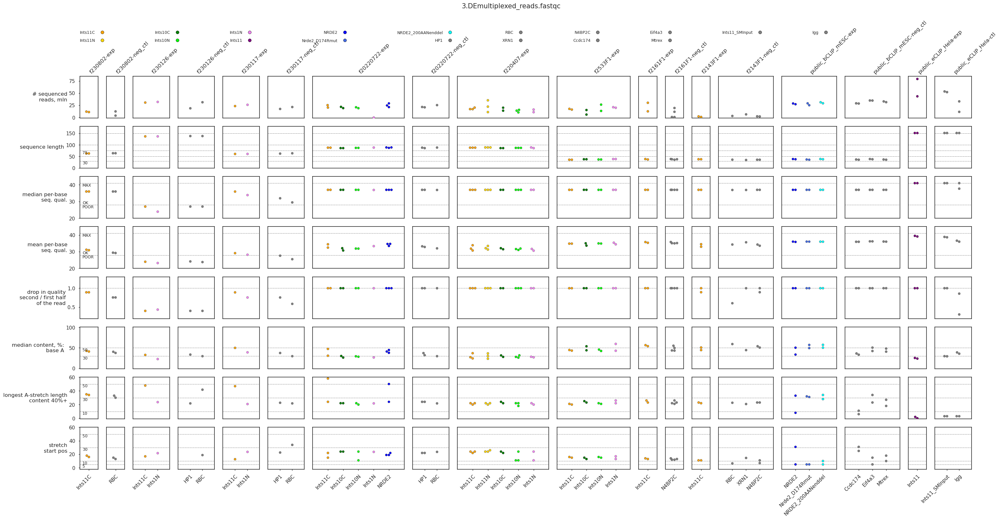

In [21]:
analyzed_category = 'DEmultiplexed'
label = '3.DEmultiplexed_reads.fastqc'
data = all_fastqc_reports.loc[all_fastqc_reports['category']==analyzed_category].reset_index(drop=True)

features_to_plot = ['Total_Sequences_number_mln','Sequence_Length_50percQuant',
                    'median_Per_base_sequence_quality','mean_Per_base_sequence_quality','drop_Per_base_sequence_quality',
                   'A_content','A_stretch_length','A_stretch_start_pos']
feature_labels = ['# sequenced\nreads, mln','sequence length',
                  'median per-base\nseq. qual.','mean per-base\nseq. qual.','drop in quality\nsecond / first half\nof the read',
                 'median content, %:\nbase A','longest A-stretch length\ncontent 40%+','stretch\nstart pos']
feature_plot_type = ['swarmplot']*(len(features_to_plot))
hide_yticks = [False]*(len(features_to_plot))

ylims = [(-1,85),(0,180),(20,45),(20,45),(0.2,1.3),(-1,101),(-1,60),(-2,60)]
horizontal_lines = [None,[30,50,75,100,150],[41,28],[41,28],[1],[30,50],[10,30,50],[5,10,30,50]]
texts = [None,
         [{'y_pos':30,'text':'30','ha':'left','va':'top','size':9},{'y_pos':75,'text':'75','ha':'left','va':'top','size':9}],
         [{'y_pos':41,'text':'MAX','ha':'left','va':'top','size':9},{'y_pos':28,'text':'POOR','ha':'left','va':'top','size':9},{'y_pos':28,'text':'OK','ha':'left','va':'bottom','size':9}],
         [{'y_pos':41,'text':'MAX','ha':'left','va':'top','size':9},{'y_pos':28,'text':'POOR','ha':'left','va':'top','size':9},{'y_pos':28,'text':'OK','ha':'left','va':'bottom','size':9}],
         None,
         [{'y_pos':30,'text':'30','ha':'left','va':'top','size':9},{'y_pos':50,'text':'50','ha':'left','va':'top','size':9}],
         [{'y_pos':10,'text':'10','ha':'left','va':'top','size':9},{'y_pos':30,'text':'30','ha':'left','va':'top','size':9},{'y_pos':50,'text':'50','ha':'left','va':'top','size':9}],
         [{'y_pos':5,'text':'5','ha':'left','va':'top','size':9},{'y_pos':10,'text':'10','ha':'left','va':'top','size':9},{'y_pos':30,'text':'30','ha':'left','va':'top','size':9},{'y_pos':50,'text':'50','ha':'left','va':'top','size':9}]
        ]

marker_sizes = [5]*len(group_1_x_group_2)

plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size)

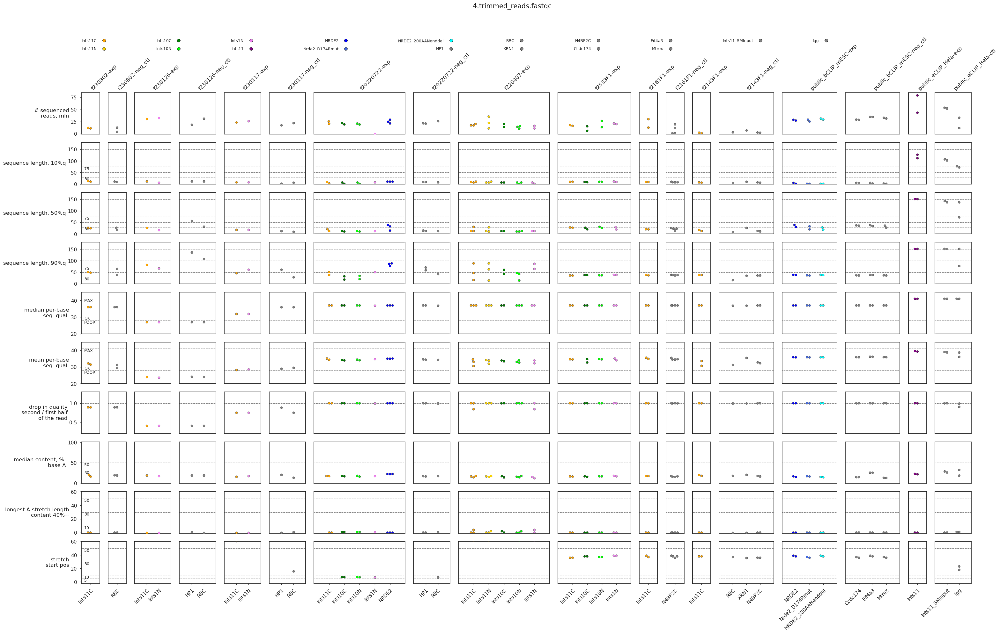

In [23]:
analyzed_category = 'trimmed'
label = '4.1.trimmed_reads.fastqc'
data = all_fastqc_reports.loc[all_fastqc_reports['category']==analyzed_category].reset_index(drop=True)

features_to_plot = ['Total_Sequences_number_mln','Sequence_Length_10percQuant','Sequence_Length_50percQuant','Sequence_Length_90percQuant',
                    'median_Per_base_sequence_quality','mean_Per_base_sequence_quality','drop_Per_base_sequence_quality',
                   'A_content','A_stretch_length','A_stretch_start_pos']
feature_labels = ['# sequenced\nreads, mln','sequence length, 10%q','sequence length, 50%q','sequence length, 90%q',
                  'median per-base\nseq. qual.','mean per-base\nseq. qual.','drop in quality\nsecond / first half\nof the read',
                 'median content, %:\nbase A','longest A-stretch length\ncontent 40%+','stretch\nstart pos']
feature_plot_type = ['swarmplot']*(len(features_to_plot))
hide_yticks = [False]*(len(features_to_plot))

ylims = [(-1,85),(0,180),(0,180),(0,180),(20,45),(20,45),(0.2,1.3),(-1,101),(-1,60),(-2,60)]
horizontal_lines = [None,[30,50,75,100,150],[30,50,75,100,150],[30,50,75,100,150],[41,28],[41,28],[1],[30,50],[10,30,50],[5,10,30,50]]
texts = [None,
         [{'y_pos':30,'text':'30','ha':'left','va':'top','size':9},{'y_pos':75,'text':'75','ha':'left','va':'top','size':9}],
         [{'y_pos':30,'text':'30','ha':'left','va':'top','size':9},{'y_pos':75,'text':'75','ha':'left','va':'top','size':9}],
         [{'y_pos':30,'text':'30','ha':'left','va':'top','size':9},{'y_pos':75,'text':'75','ha':'left','va':'top','size':9}],
         [{'y_pos':41,'text':'MAX','ha':'left','va':'top','size':9},{'y_pos':28,'text':'POOR','ha':'left','va':'top','size':9},{'y_pos':28,'text':'OK','ha':'left','va':'bottom','size':9}],
         [{'y_pos':41,'text':'MAX','ha':'left','va':'top','size':9},{'y_pos':28,'text':'POOR','ha':'left','va':'top','size':9},{'y_pos':28,'text':'OK','ha':'left','va':'bottom','size':9}],
         None,
         [{'y_pos':30,'text':'30','ha':'left','va':'top','size':9},{'y_pos':50,'text':'50','ha':'left','va':'top','size':9}],
         [{'y_pos':10,'text':'10','ha':'left','va':'top','size':9},{'y_pos':30,'text':'30','ha':'left','va':'top','size':9},{'y_pos':50,'text':'50','ha':'left','va':'top','size':9}],
         [{'y_pos':5,'text':'5','ha':'left','va':'top','size':9},{'y_pos':10,'text':'10','ha':'left','va':'top','size':9},{'y_pos':30,'text':'30','ha':'left','va':'top','size':9},{'y_pos':50,'text':'50','ha':'left','va':'top','size':9}]
        ]

marker_sizes = [5]*len(group_1_x_group_2)

plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size)

In [8]:
# copy fastqc html files to the reports

suffices = ['_fastqc.html']
categories = ['trimmed']
category_subdirs = ['fastqc_trimmed']

i = 0
for suffix in suffices:
    sample_file_name = subdirs['temp_dir']+'fastqc_file_paths.tsv'
    os.system("""find """+subdirs['results']+""" -name '*"""+suffix+"""' | grep '/"""+category_subdirs[i]+"""/' > """+sample_file_name)
    fastqc_file_paths = pd.read_csv(sample_file_name,delimiter="\t",
                                       index_col=None,header=None)
    fastqc_file_paths.columns = ['path']
    fastqc_file_paths = fastqc_file_paths.loc[fastqc_file_paths['path'].str.contains(category_subdirs[i])].reset_index(drop=True)
    
    out = subprocess.check_output('mkdir -p '+subdirs['reports_dir']+'/1_mapping_QC/'+'4.2.trimmed_reads_fastqc_reports/', shell=True)
    fastqc_file_paths['copy_to'] = fastqc_file_paths.apply(lambda x: subdirs['reports_dir']+'/1_mapping_QC/'+'4.2.trimmed_reads_fastqc_reports/'+os.path.basename(x['path']),1)
    
    for index, row in fastqc_file_paths.iterrows():
        out = subprocess.check_output('cp -f '+row['path']+' '+row['copy_to'], shell=True)

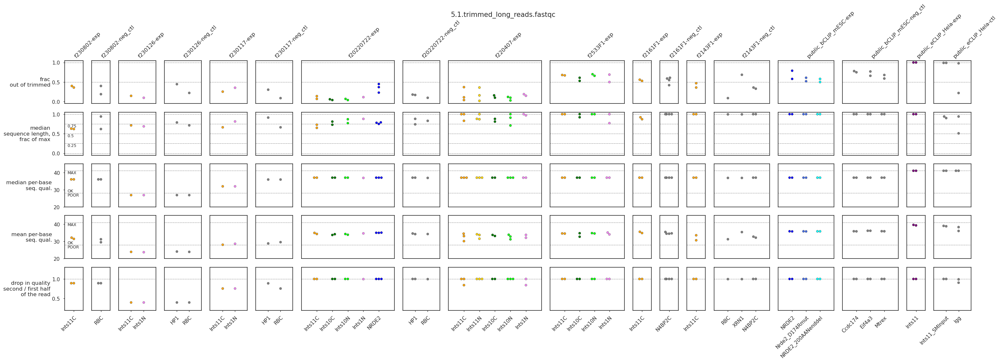

In [45]:
analyzed_category = 'trimmed_long'
label = '5.1.trimmed_long_reads.fastqc'
data = pd.merge(
all_fastqc_reports.loc[all_fastqc_reports['category']==analyzed_category].rename(columns={'Total_Sequences_number':'#selected'}),
all_fastqc_reports.loc[all_fastqc_reports['category']=='trimmed'][['sample','Total_Sequences_number']].rename(columns={'Total_Sequences_number':'#total'}),
how='inner',on='sample')

data = pd.merge(
data,
all_fastqc_reports.loc[all_fastqc_reports['category']=='DEmultiplexed'][['sample','Sequence_Length_50percQuant']].rename(columns={'Sequence_Length_50percQuant':'max_read_length'}),
how='inner',on='sample')

data['frac'] = np.round(data['#selected']/data['#total'],2)
data['rel_seq_length'] = np.round(data['Sequence_Length_50percQuant']/data['max_read_length'],2)

features_to_plot = ['frac','rel_seq_length',
                    'median_Per_base_sequence_quality','mean_Per_base_sequence_quality','drop_Per_base_sequence_quality'
                  ]
feature_labels = ['frac\nout of trimmed','median\nsequence length,\nfrac of max',
                  'median per-base\nseq. qual.','mean per-base\nseq. qual.','drop in quality\nsecond / first half\nof the read'
                 ]
feature_plot_type = ['swarmplot']*(len(features_to_plot))
hide_yticks = [False]*(len(features_to_plot))

ylims = [(-0.05,1.05),(-0.05,1.05),(20,45),(20,45),(0.2,1.3)]
horizontal_lines = [[1,0.5],[0,0.25,0.5,0.75,1],[41,28],[41,28],[1]]
texts = [None,
         [{'y_pos':0.25,'text':'0.25','ha':'left','va':'top','size':9},{'y_pos':0.5,'text':'0.5','ha':'left','va':'top','size':9},{'y_pos':0.75,'text':'0.75','ha':'left','va':'top','size':9}],
         [{'y_pos':41,'text':'MAX','ha':'left','va':'top','size':9},{'y_pos':28,'text':'POOR','ha':'left','va':'top','size':9},{'y_pos':28,'text':'OK','ha':'left','va':'bottom','size':9}],
         [{'y_pos':41,'text':'MAX','ha':'left','va':'top','size':9},{'y_pos':28,'text':'POOR','ha':'left','va':'top','size':9},{'y_pos':28,'text':'OK','ha':'left','va':'bottom','size':9}],
         None
        ]

marker_sizes = [5]*len(group_1_x_group_2)

plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size)

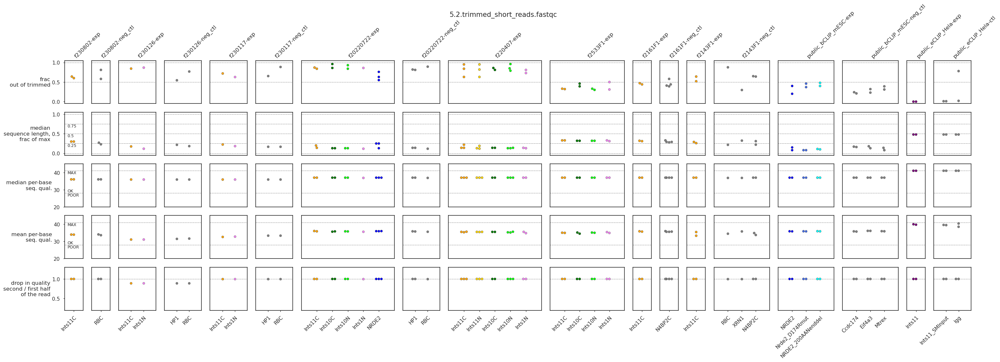

In [46]:
analyzed_category = 'trimmed_short'
label = '5.2.trimmed_short_reads.fastqc'
data = pd.merge(
all_fastqc_reports.loc[all_fastqc_reports['category']==analyzed_category].rename(columns={'Total_Sequences_number':'#selected'}),
all_fastqc_reports.loc[all_fastqc_reports['category']=='trimmed'][['sample','Total_Sequences_number']].rename(columns={'Total_Sequences_number':'#total'}),
how='inner',on='sample')

data = pd.merge(
data,
all_fastqc_reports.loc[all_fastqc_reports['category']=='DEmultiplexed'][['sample','Sequence_Length_50percQuant']].rename(columns={'Sequence_Length_50percQuant':'max_read_length'}),
how='inner',on='sample')

data['frac'] = np.round(data['#selected']/data['#total'],2)
data['rel_seq_length'] = np.round(data['Sequence_Length_50percQuant']/data['max_read_length'],2)

features_to_plot = ['frac','rel_seq_length',
                    'median_Per_base_sequence_quality','mean_Per_base_sequence_quality','drop_Per_base_sequence_quality'
                  ]
feature_labels = ['frac\nout of trimmed','median\nsequence length,\nfrac of max',
                  'median per-base\nseq. qual.','mean per-base\nseq. qual.','drop in quality\nsecond / first half\nof the read'
                 ]
feature_plot_type = ['swarmplot']*(len(features_to_plot))
hide_yticks = [False]*(len(features_to_plot))

ylims = [(-0.05,1.05),(-0.05,1.05),(20,45),(20,45),(0.2,1.3)]
horizontal_lines = [[1,0.5],[0,0.25,0.5,0.75,1],[41,28],[41,28],[1]]
texts = [None,
         [{'y_pos':0.25,'text':'0.25','ha':'left','va':'top','size':9},{'y_pos':0.5,'text':'0.5','ha':'left','va':'top','size':9},{'y_pos':0.75,'text':'0.75','ha':'left','va':'top','size':9}],
         [{'y_pos':41,'text':'MAX','ha':'left','va':'top','size':9},{'y_pos':28,'text':'POOR','ha':'left','va':'top','size':9},{'y_pos':28,'text':'OK','ha':'left','va':'bottom','size':9}],
         [{'y_pos':41,'text':'MAX','ha':'left','va':'top','size':9},{'y_pos':28,'text':'POOR','ha':'left','va':'top','size':9},{'y_pos':28,'text':'OK','ha':'left','va':'bottom','size':9}],
         None
        ]

marker_sizes = [5]*len(group_1_x_group_2)

plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size)

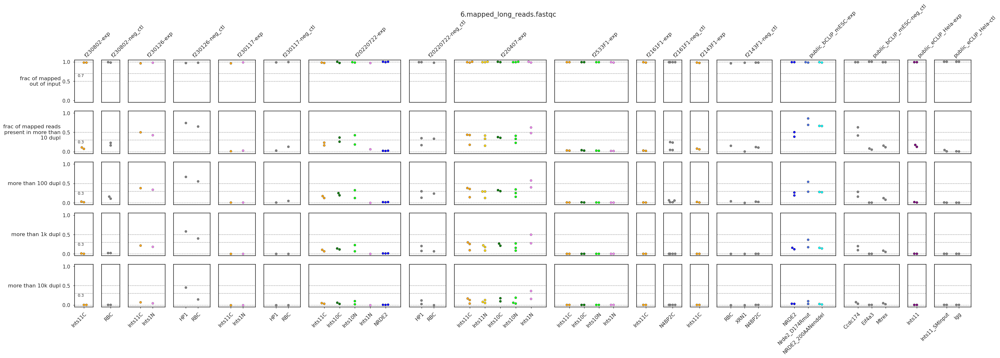

In [50]:
analyzed_category = 'mapped_long'
label = '6.1.mapped_long_reads.fastqc'

mapping_stats_df = pd.merge(
all_fastqc_reports.loc[all_fastqc_reports['category']==analyzed_category.replace('mapped','trimmed')][['sample','Total_Sequences_number']].rename(columns={'Total_Sequences_number':'#total'}),
all_fastqc_reports.loc[all_fastqc_reports['category']==analyzed_category][['sample','Total_Sequences_number','more_10_dupl','more_100_dupl','more_1k_dupl','more_10k_dupl']].rename(columns={'Total_Sequences_number':'#mapped'}),
how='inner',on='sample')
mapping_stats_df['mapped_frac'] = np.round(mapping_stats_df['#mapped']/mapping_stats_df['#total'],2)

data = mapping_stats_df[['sample','mapped_frac','more_10_dupl','more_100_dupl','more_1k_dupl','more_10k_dupl']]
data = pd.merge(data,metadata,how='inner',on='sample')

features_to_plot = ['mapped_frac','more_10_dupl','more_100_dupl','more_1k_dupl','more_10k_dupl']
feature_labels = ['frac of mapped\nout of input','frac of mapped reads\npresent in more than\n10 dupl','more than 100 dupl','more than 1k dupl','more than 10k dupl']
feature_plot_type = ['swarmplot']*(len(features_to_plot))
hide_yticks = [False]*(len(features_to_plot))

ylims = [(-0.05,1.05)]*(len(features_to_plot))
horizontal_lines = [[1,0.7,0.5]]+[[0,0.3,0.5]]*(len(features_to_plot)-1)
texts = [[{'y_pos':0.7,'text':'0.7','ha':'left','va':'top','size':9}]]+[[{'y_pos':0.3,'text':'0.3','ha':'left','va':'top','size':9}]]*(len(features_to_plot)-1)

marker_sizes = [5]*len(group_1_x_group_2)

plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size)

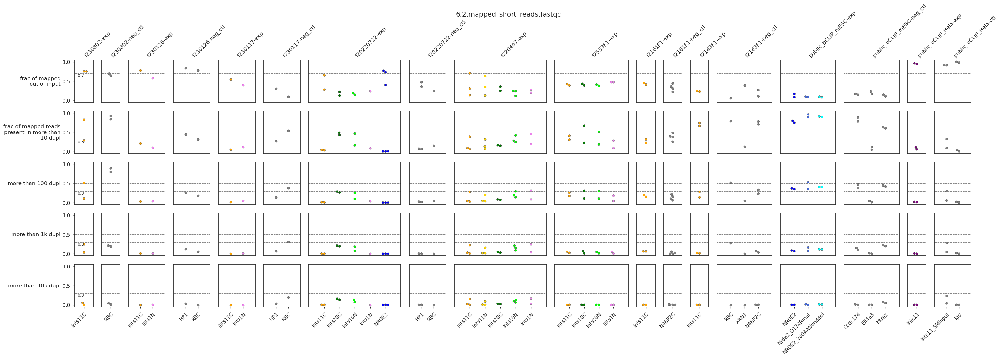

In [51]:
analyzed_category = 'mapped_short'
label = '6.2.mapped_short_reads.fastqc'

mapping_stats_df = pd.merge(
all_fastqc_reports.loc[all_fastqc_reports['category']==analyzed_category.replace('mapped','trimmed')][['sample','Total_Sequences_number']].rename(columns={'Total_Sequences_number':'#total'}),
all_fastqc_reports.loc[all_fastqc_reports['category']==analyzed_category][['sample','Total_Sequences_number','more_10_dupl','more_100_dupl','more_1k_dupl','more_10k_dupl']].rename(columns={'Total_Sequences_number':'#mapped'}),
how='inner',on='sample')
mapping_stats_df['mapped_frac'] = np.round(mapping_stats_df['#mapped']/mapping_stats_df['#total'],2)

data = mapping_stats_df[['sample','mapped_frac','more_10_dupl','more_100_dupl','more_1k_dupl','more_10k_dupl']]
data = pd.merge(data,metadata,how='inner',on='sample')

features_to_plot = ['mapped_frac','more_10_dupl','more_100_dupl','more_1k_dupl','more_10k_dupl']
feature_labels = ['frac of mapped\nout of input','frac of mapped reads\npresent in more than\n10 dupl','more than 100 dupl','more than 1k dupl','more than 10k dupl']
feature_plot_type = ['swarmplot']*(len(features_to_plot))
hide_yticks = [False]*(len(features_to_plot))

ylims = [(-0.05,1.05)]*(len(features_to_plot))
horizontal_lines = [[1,0.7,0.5]]+[[0,0.3,0.5]]*(len(features_to_plot)-1)
texts = [[{'y_pos':0.7,'text':'0.7','ha':'left','va':'top','size':9}]]+[[{'y_pos':0.3,'text':'0.3','ha':'left','va':'top','size':9}]]*(len(features_to_plot)-1)

marker_sizes = [5]*len(group_1_x_group_2)

plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size)

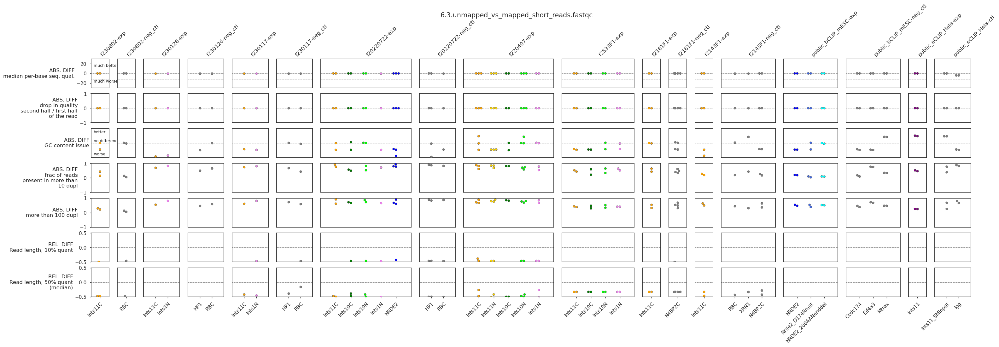

In [68]:
analyzed_category = 'unmapped_vs_mapped'
label = '6.3.unmapped_vs_mapped_short_reads.fastqc'

# create diff df for absolute differences
diff_features = ['median_Per_base_sequence_quality','drop_Per_base_sequence_quality','Per_sequence_GC_content_flag_int',
                'more_10_dupl','more_100_dupl']
a = []
for category in ['mapped_short','unmapped_short']:
    tmp = all_fastqc_reports.loc[all_fastqc_reports['category']==category].reset_index(drop=True)
    renaming_dict = {}
    for diff_feature in diff_features:
        renaming_dict[diff_feature] = diff_feature+'_'+category.replace('_short','').replace('_long','')
    tmp = tmp[['sample']+diff_features].rename(columns=renaming_dict)
    a.append(tmp)
tmp = pd.merge(a[0],a[1],how='inner',on='sample')
for diff_feature in diff_features:
    tmp[diff_feature+'_diff'] = tmp[diff_feature+'_unmapped']-tmp[diff_feature+'_mapped']
    tmp[diff_feature+'_diff'] = tmp[diff_feature+'_diff'].fillna(0)
    tmp = tmp.drop([diff_feature+'_unmapped',diff_feature+'_mapped'],1)
    
data = tmp.copy()

# create diff df for relative differences

rel_diff_features = ['Sequence_Length_10percQuant','Sequence_Length_50percQuant']

a = []
for category in ['mapped_short','unmapped_short']:
    tmp = all_fastqc_reports.loc[all_fastqc_reports['category']==category].reset_index(drop=True)
    renaming_dict = {}
    for diff_feature in rel_diff_features:
        renaming_dict[diff_feature] = diff_feature+'_'+category.replace('_short','').replace('_long','')
    tmp = tmp[['sample']+rel_diff_features].rename(columns=renaming_dict)
    a.append(tmp)
tmp = pd.merge(a[0],a[1],how='inner',on='sample')
for diff_feature in rel_diff_features:
    tmp[diff_feature+'_diff'] = (tmp[diff_feature+'_unmapped']-tmp[diff_feature+'_mapped'])/tmp[diff_feature+'_mapped']
    tmp[diff_feature+'_diff'] = tmp[diff_feature+'_diff'].fillna(1)
    tmp = tmp.drop([diff_feature+'_unmapped',diff_feature+'_mapped'],1)

data = pd.merge(data,tmp,how='inner',on='sample')
data = pd.merge(data,metadata,how='inner',on='sample')

features_to_plot = [diff_feature+'_diff' for diff_feature in (diff_features+rel_diff_features)]

feature_labels = ['ABS. DIFF\nmedian per-base seq. qual.','ABS. DIFF\ndrop in quality\nsecond half / first half\nof the read',
                  'ABS. DIFF\nGC content issue','ABS. DIFF\nfrac of reads\npresent in more than\n10 dupl','ABS. DIFF\nmore than 100 dupl']+\
                ['REL. DIFF\nRead length, 10% quant','REL. DIFF\nRead length, 50% quant\n(median)']
feature_plot_type = ['swarmplot']*(len(features_to_plot))

hide_yticks = [False]*2+[True]+[False]*4

ylims = [(-30,30),(-1,1),(-11.05,11.05),(-1,1),(-1,1)]+[(-0.5,0.5),(-0.5,0.5)]
horizontal_lines = [[0,-12,12]]+[[0]]*(len(features_to_plot)-1)
texts = [[{'y_pos':12,'text':'much better','ha':'left','va':'bottom','size':9},
            {'y_pos':-12,'text':'much worse','ha':'left','va':'top','size':9}]]+\
                    [None]+\
                    [[{'y_pos':10,'text':'better','ha':'left','va':'top','size':9},
                   {'y_pos':0,'text':'no difference','ha':'left','va':'bottom','size':9},
                   {'y_pos':-10,'text':'worse','ha':'left','va':'bottom','size':9}]]+\
                    [None]*4

marker_sizes = [5]*len(group_1_x_group_2)

plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size,subplot_height=1.4)

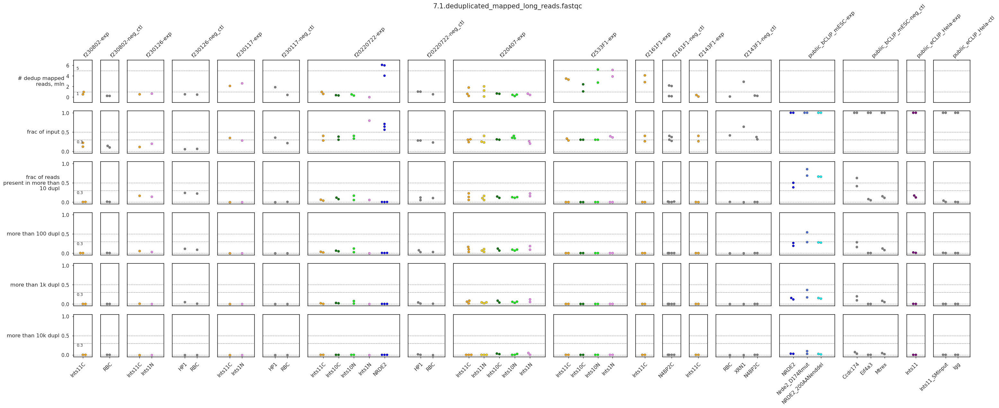

In [12]:
analyzed_category = 'dedup_mapped_long'
label = '7.1.deduplicated_mapped_long_reads.fastqc'

data = all_fastqc_reports.loc[all_fastqc_reports['category']==analyzed_category].reset_index(drop=True)

data = pd.merge(
data,
all_fastqc_reports.loc[all_fastqc_reports['category']==analyzed_category.replace('dedup_mapped','mapped')][['sample','Total_Sequences_number']].rename(columns={'Total_Sequences_number':'#total'}),
how='inner',on='sample')
data['frac'] = np.round(data['Total_Sequences_number']/data['#total'],2)

features_to_plot = ['Total_Sequences_number_mln','frac','more_10_dupl','more_100_dupl','more_1k_dupl','more_10k_dupl']
feature_labels = ['# dedup mapped\nreads, mln','frac of input','frac of reads\npresent in more than\n10 dupl','more than 100 dupl','more than 1k dupl','more than 10k dupl']
feature_plot_type = ['swarmplot']*(len(features_to_plot))
hide_yticks = [False]*(len(features_to_plot))

ylims = [(-1,7)]+[(-0.05,1.05)]*(len(features_to_plot)-1)
horizontal_lines = [[1,5]]+[[0,0.3,0.5]]*(len(features_to_plot)-1)
texts = [[{'y_pos':1,'text':'1','ha':'left','va':'top','size':9},{'y_pos':5,'text':'5','ha':'left','va':'bottom','size':9}]]+[[{'y_pos':0.3,'text':'0.3','ha':'left','va':'top','size':9}]]*(len(features_to_plot)-1)

marker_sizes = [5]*len(group_1_x_group_2)

plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size)

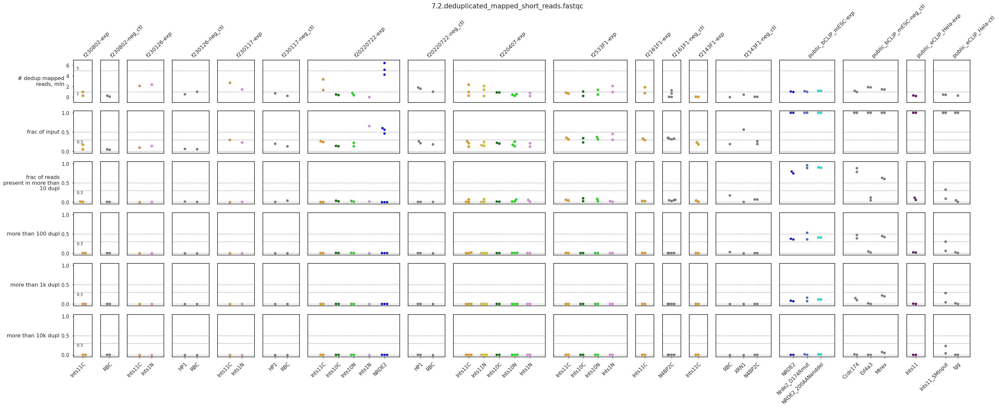

In [13]:
analyzed_category = 'dedup_mapped_short'
label = '7.2.deduplicated_mapped_short_reads.fastqc'

data = all_fastqc_reports.loc[all_fastqc_reports['category']==analyzed_category].reset_index(drop=True)

data = pd.merge(
data,
all_fastqc_reports.loc[all_fastqc_reports['category']==analyzed_category.replace('dedup_mapped','mapped')][['sample','Total_Sequences_number']].rename(columns={'Total_Sequences_number':'#total'}),
how='inner',on='sample')
data['frac'] = np.round(data['Total_Sequences_number']/data['#total'],2)

features_to_plot = ['Total_Sequences_number_mln','frac','more_10_dupl','more_100_dupl','more_1k_dupl','more_10k_dupl']
feature_labels = ['# dedup mapped\nreads, mln','frac of input','frac of reads\npresent in more than\n10 dupl','more than 100 dupl','more than 1k dupl','more than 10k dupl']
feature_plot_type = ['swarmplot']*(len(features_to_plot))
hide_yticks = [False]*(len(features_to_plot))

ylims = [(-1,7)]+[(-0.05,1.05)]*(len(features_to_plot)-1)
horizontal_lines = [[1,5]]+[[0,0.3,0.5]]*(len(features_to_plot)-1)
texts = [[{'y_pos':1,'text':'1','ha':'left','va':'top','size':9},{'y_pos':5,'text':'5','ha':'left','va':'bottom','size':9}]]+[[{'y_pos':0.3,'text':'0.3','ha':'left','va':'top','size':9}]]*(len(features_to_plot)-1)

marker_sizes = [5]*len(group_1_x_group_2)

plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size)

# Categorization of mapped reads

In [14]:
def get_class_label(class_name,dupl_cats_dict):
    mm_cat = class_name.split(';')[0]
    mm_cat = ('uniquely mapped' if mm_cat=='uniquely_mapped' else mm_cat)
    dupl_level = dupl_cats_dict[int(class_name.split(';')[1])]
    return mm_cat+'\n'+dupl_level+' dups'

# long_short_cats = ['long','short']
dupl_cats_dict = {0:'1-10',1:'10-100',2:'100-1k',3:'1k-10k',4:'10k-100k',5:'100k-1mln'}
multi_mapped_cats = ['uniquely_mapped','multimapped']

tmp1 = pd.DataFrame(dupl_cats_dict.keys(),columns=['dupl_cat'])
tmp1['t']=1
tmp2 = pd.DataFrame(multi_mapped_cats,columns=['mm_cat'])
tmp2['t']=1
tmp = pd.merge(tmp1,tmp2,how='inner',on='t')
# tmp3 = pd.DataFrame(long_short_cats,columns=['long_short_cat'])
# tmp3['t']=1
# tmp = pd.merge(tmp,tmp3,how='inner',on='t')

tmp['count_col'] = tmp['mm_cat']+';'+tmp['dupl_cat'].astype('str')
count_cols_df = tmp.copy()
count_cols = list(count_cols_df['count_col'].unique())

a = []
for organism in list(metadata['organism'].unique()):
    modified_annotation = pd.read_csv(subdirs['results']+'transcriptome/'+organism+'/modified_annotation.gtf',delimiter="\t",index_col=None,header=None)
    ### get gene biotypes
    gene_annotation = modified_annotation.loc[modified_annotation[2]=='gene'][[0,8]]
    gene_annotation['gene_id'] = gene_annotation[8].str.split('gene_id "',expand=True)[1].str.split('";',expand=True)[0]
    gene_annotation['gene_name'] = gene_annotation[8].str.split('gene_name "',expand=True)[1].str.split('";',expand=True)[0]
    gene_annotation['gene_biotype'] = gene_annotation[8].str.replace('gene_type','gene_biotype').str.split('gene_biotype "',expand=True)[1].str.split('";',expand=True)[0]
    gene_annotation['gene_biotype'] = gene_annotation['gene_biotype']+(gene_annotation[0]=='chrM').astype('str').str.replace('True',';Mito').replace('False',';Nuclear')
    gene_annotation = gene_annotation[['gene_id','gene_name','gene_biotype']]
    gene_annotation['organism'] = organism
    a.append(gene_annotation)
    
gene_annotation = pd.concat(a).reset_index(drop=True)

gene_biotypes_hiararchy = list(pd.Series(['Mt_rRNA','Mt_tRNA','protein_coding'])+';Mito')+\
list(pd.Series(['rRNA$','rRNA_pseudogene','miRNA','snoRNA','tRNA','snRNA','ncRNA','other_RNA','lncRNA','TR_','IG_','pseudogene','protein_coding'])+';Nuclear')

def get_gene_biotype_shortened(x,gene_biotypes_hiararchy):
    gene_biotype = x['gene_biotype']
    gene_biotype_shortened = 'other_RNA'
    for elem in gene_biotypes_hiararchy:
        if elem.split(';')[1] == gene_biotype.split(';')[1]:
            if '$' in elem:
                if gene_biotype.split(';')[0].endswith(elem.split(';')[0].replace('$','')):
                    return elem.replace('$','')
            else:
                if elem.split(';')[0] in gene_biotype.split(';')[0]:
                    return elem
    return gene_biotype_shortened
    
gene_annotation['gene_biotype_shortened'] = gene_annotation.apply(lambda x:get_gene_biotype_shortened(x,gene_biotypes_hiararchy),1)
# for optimized storage
gene_annotation['gene_id'] = gene_annotation['gene_id'].astype('int32')
gene_annotation['gene_biotype'] = gene_annotation['gene_biotype'].astype('category')
gene_annotation['organism'] = gene_annotation['organism'].astype('category')
gene_annotation['gene_biotype_shortened'] = gene_annotation['gene_biotype_shortened'].astype('category')

In [32]:
# find paths to quantification of EXONIC-INTRONIC-INTERGENIC segments
sample_file_name = subdirs['temp_dir']+'wd_counts_file_paths.tsv'
os.system("""find """+subdirs['results']+""" -name '*.wd_counts.tsv' > """+sample_file_name)
wd_counts_file_paths = pd.read_csv(sample_file_name,delimiter="\t",index_col=None,header=None)
wd_counts_file_paths.columns = ['path']
wd_counts_file_paths = wd_counts_file_paths.loc[wd_counts_file_paths['path'].str.contains('exon_intron')].reset_index(drop=True)

wd_counts_file_paths['short_long'] = wd_counts_file_paths['path'].str.contains('segment_counts_long').astype('str').str.replace('True','long').replace('False','short')

wd_counts_file_paths = wd_counts_file_paths.loc[wd_counts_file_paths['short_long']=='long'].reset_index(drop=True).drop('short_long',1) # we only quantified correctly for long reads!

wd_counts_file_paths['sample'] = wd_counts_file_paths.apply(lambda x:os.path.basename(x['path']).replace('.wd_counts.tsv',''),1)

wd_counts_file_paths = pd.merge(wd_counts_file_paths,metadata[['sample','organism']],how='left',on='sample')

In [55]:
for organism in list(metadata['organism'].unique()):
# for organism in ['human']:
    # get an example file from this organism. Define the correspondance of segment_name to gene_biotype
    example_file = wd_counts_file_paths.loc[wd_counts_file_paths['organism']==organism].iloc[0]['path']
    wd_counts = pd.read_csv(example_file,delimiter="\t",index_col=None,header=0)
    
    tmp1 = wd_counts[['segment_name']].drop_duplicates()
    tmp1 = tmp1.loc[~tmp1['segment_name'].str.contains(';nan')].reset_index(drop=True)
    tmp = tmp1['segment_name'].str.split(';',expand=True)[1]
    tmp = tmp.str.split(',',expand=True)
    tmp = pd.concat([tmp1[['segment_name']],tmp],axis=1)
    tmp = pd.melt(tmp,id_vars=['segment_name']).drop('variable',1).rename(columns={'value':'gene_id'})
    tmp = tmp.loc[~tmp['gene_id'].isna()].reset_index(drop=True)
    tmp['gene_id'] = tmp['gene_id'].astype('int32')
    tmp = pd.merge(tmp,gene_annotation.loc[gene_annotation['organism']==organism][['gene_id','gene_biotype_shortened']],how='inner',on=['gene_id'])

    gene_biotypes_hiararchy_df = pd.DataFrame(gene_biotypes_hiararchy,columns=['gene_biotype_shortened'])
    gene_biotypes_hiararchy_df['order'] = gene_biotypes_hiararchy_df.index+1

    tmp = pd.merge(tmp,gene_biotypes_hiararchy_df,how='inner',on='gene_biotype_shortened')
    tmp = tmp.sort_values(['segment_name','order']).drop_duplicates(['segment_name'],keep='first')[['segment_name','gene_biotype_shortened']].reset_index(drop=True)
    
    out = subprocess.check_output('mkdir -p '+subdirs['reports_dir']+'/2_categorization_of_mapped_reads/', shell=True)
    tmp.to_csv(subdirs['reports_dir']+'/2_categorization_of_mapped_reads/'+organism+'.gene_biotypes_for_segments.tsv', sep=str('\t'),header=True,index=None,quoting=csv.QUOTE_NONE)
    
    print(organism+' done')

ParserError: Error tokenizing data. C error: Calling read(nbytes) on source failed. Try engine='python'.

In [56]:
tmp.memory_usage()

Index                          128
segment_name              11912296
gene_biotype_shortened     1489433
dtype: int64

In [54]:
sum(tmp.memory_usage())/10**6

13.401857

In [63]:
gene_biotypes_for_segments = {}
for organism in list(metadata['organism'].unique()):
    tmp = pd.read_csv(subdirs['reports_dir']+'/2_categorization_of_mapped_reads/'+organism+'.gene_biotypes_for_segments.tsv',delimiter="\t",index_col=None,header=0)
    tmp['gene_biotype_shortened'] = tmp['gene_biotype_shortened'].astype('category')
    gene_biotypes_for_segments[organism] = tmp

In [68]:
stats_report = []
k=0
WD = {}
for index, row in wd_counts_file_paths.iterrows():
    sample_id = os.path.basename(row['path']).replace('.wd_counts.tsv','')
    organism = metadata.loc[metadata['sample']==sample_id,'organism'].iloc[0]
    wd_counts = pd.read_csv(row['path'],delimiter="\t",index_col=None,header=0)

    # optimize column types for decreased storage
    for count_col in count_cols:
        if count_col not in list(wd_counts.columns):
            wd_counts[count_col] = 0
            wd_counts[count_col] = wd_counts[count_col].astype('int8')
    for col in ['chr','strand']:
        wd_counts[col] = wd_counts[col].astype('category')
    
    ### GENERAL STATS ON THE COUNTS
    tmp = pd.DataFrame(wd_counts[count_cols].sum(),columns = ['#reads'])
    tmp['count_col'] = tmp.index
    tmp = tmp.reset_index(drop=True)
    tmp['frac_of_ALL_reads'] = tmp['#reads']/tmp['#reads'].sum()
    
    tmp1 = pd.DataFrame(wd_counts[count_cols].astype(bool).sum(axis=0),columns=['#expr_segments'])
    tmp1['count_col'] = tmp1.index
    tmp1 = tmp1.reset_index(drop=True)
    tmp1['frac_of_segments_with_expression'] = tmp1['#expr_segments']/len(wd_counts)
    
    tmp = pd.merge(tmp,tmp1,how='inner',on=['count_col'])
    stats_cur = tmp[['count_col','frac_of_ALL_reads','frac_of_segments_with_expression']].copy()

    ### fraction of intergenic
    int_df = pd.concat(
    [wd_counts[count_cols].sum(),wd_counts.loc[wd_counts['segment_name'].str.contains('intergenic')][count_cols].sum()],
    axis=1)
    int_df.columns = ['total','intergenic']
    int_df['intergenic'] = (int_df['intergenic']/int_df['total']).fillna(0)
    int_df['count_col'] = int_df.index
    int_df = int_df.rename(columns={'intergenic':'frac_intergenic'})
    int_df = int_df.drop('total',1)
    stats_cur = pd.merge(stats_cur,int_df,how='inner',on='count_col')
    
    # fraction of intergenic segments with expression
    tmp1 = pd.DataFrame(wd_counts.loc[wd_counts['segment_name'].str.contains('intergenic')][count_cols].astype(bool).sum(axis=0),columns=['#expr_intergenic_segments'])
    tmp1['count_col'] = tmp1.index
    tmp1 = tmp1.reset_index(drop=True)
    tmp1['frac_of_intergenic_segments_with_expression'] = tmp1['#expr_intergenic_segments']/len(wd_counts.loc[wd_counts['segment_name'].str.contains('intergenic')])
    
    stats_cur = pd.merge(stats_cur,tmp1.drop('#expr_intergenic_segments',1),how='inner',on='count_col')

    ### fraction of 5' or 3' gene flanking
    int_df = pd.concat(
    [wd_counts[count_cols].sum(),wd_counts.loc[wd_counts['segment_name'].str.contains('five_or_three_prime_gene_flank')][count_cols].sum()],
    axis=1)
    int_df.columns = ['total','five_or_three_prime_gene_flank']
    int_df['five_or_three_prime_gene_flank'] = (int_df['five_or_three_prime_gene_flank']/int_df['total']).fillna(0)
    int_df['count_col'] = int_df.index
    int_df = int_df.rename(columns={'five_or_three_prime_gene_flank':'frac_five_or_three_prime_gene_flank'})
    int_df = int_df.drop('total',1)
    stats_cur = pd.merge(stats_cur,int_df,how='inner',on='count_col')

    ### fraction of 5'-only gene flanking
    int_df = pd.concat(
    [wd_counts[count_cols].sum(),wd_counts.loc[wd_counts['segment_name'].str.contains('five_prime_only_gene_flank')][count_cols].sum()],
    axis=1)
    int_df.columns = ['total','five_prime_only_gene_flank']
    int_df['five_prime_only_gene_flank'] = (int_df['five_prime_only_gene_flank']/int_df['total']).fillna(0)
    int_df['count_col'] = int_df.index
    int_df = int_df.rename(columns={'five_prime_only_gene_flank':'frac_five_prime_only_gene_flank'})
    int_df = int_df.drop('total',1)
    stats_cur = pd.merge(stats_cur,int_df,how='inner',on='count_col')

    ### fraction of 3'-only gene flanking
    int_df = pd.concat(
    [wd_counts[count_cols].sum(),wd_counts.loc[wd_counts['segment_name'].str.contains('three_prime_only_gene_flank')][count_cols].sum()],
    axis=1)
    int_df.columns = ['total','three_prime_only_gene_flank']
    int_df['three_prime_only_gene_flank'] = (int_df['three_prime_only_gene_flank']/int_df['total']).fillna(0)
    int_df['count_col'] = int_df.index
    int_df = int_df.rename(columns={'three_prime_only_gene_flank':'frac_three_prime_only_gene_flank'})
    int_df = int_df.drop('total',1)
    stats_cur = pd.merge(stats_cur,int_df,how='inner',on='count_col')
    
    # take only genic regions
    wd_counts = wd_counts.loc[wd_counts['segment_name'].str.contains('|'.join(['alw_exonic','alw_intronic','exonic_or_intronic']))].reset_index(drop=True)
    
    # how many reads are left
    tmp = pd.DataFrame(wd_counts[count_cols].sum(),columns = ['#non-intergenic_mln'])
    tmp['#non-intergenic_mln'] = np.round(tmp['#non-intergenic_mln']/10**6,2)
    tmp['count_col'] = tmp.index
    tmp = tmp.reset_index(drop=True)
    stats_cur = pd.merge(stats_cur,tmp,how='inner',on=['count_col'])
    
    ### SENSE-ANTISENSE ANALYSIS
    sense_antisense_report = []
    
    rename_dict = {}
    for count_col in count_cols:
        rename_dict[count_col]=count_col+';anti'
    tmp_anti = wd_counts.loc[wd_counts['segment_name'].str.contains('ANTISENSE:')].reset_index(drop=True)[['chr','start','end','strand','segment_name']+count_cols].rename(columns = rename_dict)
    tmp_anti['segment_name'] = tmp_anti['segment_name'].str.replace('ANTISENSE:','')

    rename_dict = {}
    for count_col in count_cols:
        rename_dict[count_col]=count_col+';sense'

    tmp = pd.merge(wd_counts[['chr','start','end','strand','segment_name']+count_cols].rename(columns = rename_dict),tmp_anti.drop('strand',1),how='inner',on=['chr','start','end','segment_name'])
    for count_col in count_cols:
        N_expr_segm = len(tmp.loc[tmp[count_col+';sense']+tmp[count_col+';anti']>0])
        frac_of_expressed_segments_sense = len(tmp.loc[tmp[count_col+';sense']>tmp[count_col+';anti']])/N_expr_segm if N_expr_segm>0 else 0
        frac_sense = (tmp[count_col+';sense'].sum())/(tmp[count_col+';anti'].sum()+tmp[count_col+';sense'].sum()) if N_expr_segm>0 else 0
        
        sense_antisense_report.append([count_col,frac_sense,frac_of_expressed_segments_sense])
    
    sense_antisense_report = pd.DataFrame(sense_antisense_report,columns=['count_col','frac_sense','frac_of_expressed_segments_sense_more_anti'])
    stats_cur = pd.merge(stats_cur,sense_antisense_report,how='inner',on=['count_col'])

    # take only sense segments
    wd_counts = wd_counts.loc[~wd_counts['segment_name'].str.contains('ANTISENSE')].reset_index(drop=True)
    
    # how many reads are left
    tmp = pd.DataFrame(wd_counts[count_cols].sum(),columns = ['#sense_non-intergenic_mln'])
    tmp['#sense_non-intergenic_mln'] = np.round(tmp['#sense_non-intergenic_mln']/10**6,2)
    tmp['count_col'] = tmp.index
    tmp = tmp.reset_index(drop=True)
    stats_cur = pd.merge(stats_cur,tmp,how='inner',on=['count_col'])
    
    ### rRNA, other non-mRNA or ncRNA
    wd_counts = pd.merge(wd_counts,gene_biotypes_for_segments[organism],how='inner',on='segment_name')
    
    biotypes_df = pd.concat([wd_counts[count_cols].sum()]+[wd_counts.loc[wd_counts['gene_biotype_shortened']==gene_biotype][count_cols].sum() for gene_biotype in gene_biotypes_hiararchy],axis=1)
    biotypes_df.columns = ['total_sense']+gene_biotypes_hiararchy
    biotypes_df['count_col'] = biotypes_df.index
    biotypes_df = biotypes_df.reset_index(drop=True)
    for gene_biotype in gene_biotypes_hiararchy:
        biotypes_df[gene_biotype] = biotypes_df[gene_biotype]/biotypes_df['total_sense']
    biotypes_df[gene_biotypes_hiararchy] = biotypes_df[gene_biotypes_hiararchy].fillna(0)
    biotypes_df = biotypes_df.drop('total_sense',1)    
    rename_dict = {}
    for gene_biotype in gene_biotypes_hiararchy:
        rename_dict[gene_biotype] = 'frac_of_'+gene_biotype
    biotypes_df = biotypes_df.rename(columns=rename_dict)
    stats_cur = pd.merge(stats_cur,biotypes_df,how='inner',on=['count_col'])
    
    for gene_biotype in gene_biotypes_hiararchy:
        tmp1 = pd.DataFrame(wd_counts.loc[wd_counts['gene_biotype_shortened']==gene_biotype][count_cols].astype(bool).sum(axis=0),columns=['#expr_segments'])
        tmp1['count_col'] = tmp1.index
        tmp1 = tmp1.reset_index(drop=True)
        tmp1['frac_of_'+gene_biotype+'_segments_with_expression'] = tmp1['#expr_segments']/len(wd_counts.loc[wd_counts['gene_biotype_shortened']==gene_biotype])
        stats_cur = pd.merge(stats_cur,tmp1[['count_col','frac_of_'+gene_biotype+'_segments_with_expression']],how='inner',on='count_col')
    
    # take only protein-coding genes
    wd_counts = wd_counts.loc[wd_counts['gene_biotype_shortened'].isin(['protein_coding;Nuclear','protein_coding;Mito'])].reset_index(drop=True)
    
    # how many reads are left
    tmp = pd.DataFrame(wd_counts[count_cols].sum(),columns = ['#protein_coding_mln'])
    tmp['#protein_coding_mln'] = np.round(tmp['#protein_coding_mln']/10**6,2)
    tmp['count_col'] = tmp.index
    tmp = tmp.reset_index(drop=True)
    stats_cur = pd.merge(stats_cur,tmp,how='inner',on=['count_col'])
    
    ### exonic - intronic - exonic/intronic
    cats = ['alw_exonic','alw_intronic','exonic_or_intronic']
    
    int_exonic_intr_df = pd.concat(
    [wd_counts[count_cols].sum()]+[wd_counts.loc[wd_counts['segment_name'].str.contains(cat)][count_cols].sum() for cat in cats],
    axis=1)
    int_exonic_intr_df.columns = ['total_sense']+cats
    int_exonic_intr_df['count_col'] = int_exonic_intr_df.index
    int_exonic_intr_df = int_exonic_intr_df.reset_index(drop=True)

    for cat in cats:
        int_exonic_intr_df[cat] = int_exonic_intr_df[cat]/int_exonic_intr_df['total_sense']
    
    int_exonic_intr_df[cats] = int_exonic_intr_df[cats].fillna(0)
    int_exonic_intr_df = int_exonic_intr_df.drop('total_sense',1)
    rename_dict = {}
    for cat in cats:
        rename_dict[cat] = 'frac_of_'+cat
    int_exonic_intr_df = int_exonic_intr_df.rename(columns=rename_dict)
    
    stats_cur = pd.merge(stats_cur,int_exonic_intr_df,how='inner',on=['count_col'])
    
    stats_cur['sample'] = sample_id
    stats_report.append(stats_cur)
    
    # take alw exonic segments for mouse samples and save counts for them
    # if organism=='mouse':
    #     wd_counts = wd_counts.loc[wd_counts['segment_name'].str.contains('alw_exonic')].reset_index(drop=True)
    #     for count_col in count_cols:
    #         if count_col not in WD.keys():
    #             WD[count_col] = wd_counts[['chr','start','end','strand','segment_name']+[count_col]].rename(columns = {count_col:sample_id})
    #         else:
    #             WD[count_col] = pd.merge(WD[count_col],wd_counts[['chr','start','end','strand','segment_name']+[count_col]].rename(columns = {count_col:sample_id}),how='outer',
    #                                      on=['chr','start','end','strand','segment_name'])
    
    print(str(k+1)+' out of '+str(len(wd_counts_file_paths)))
    k=k+1

1 out of 76
2 out of 76
3 out of 76
4 out of 76
5 out of 76
6 out of 76
7 out of 76
8 out of 76
9 out of 76
10 out of 76
11 out of 76
12 out of 76
13 out of 76
14 out of 76
15 out of 76
16 out of 76
17 out of 76
18 out of 76
19 out of 76
20 out of 76
21 out of 76
22 out of 76
23 out of 76
24 out of 76
25 out of 76
26 out of 76
27 out of 76
28 out of 76
29 out of 76
30 out of 76
31 out of 76
32 out of 76
33 out of 76
34 out of 76
35 out of 76
36 out of 76
37 out of 76
38 out of 76
39 out of 76
40 out of 76
41 out of 76
42 out of 76
43 out of 76
44 out of 76
45 out of 76
46 out of 76
47 out of 76
48 out of 76
49 out of 76
50 out of 76
51 out of 76
52 out of 76
53 out of 76
54 out of 76
55 out of 76
56 out of 76
57 out of 76
58 out of 76
59 out of 76
60 out of 76
61 out of 76
62 out of 76
63 out of 76
64 out of 76
65 out of 76
66 out of 76
67 out of 76
68 out of 76
69 out of 76
70 out of 76
71 out of 76
72 out of 76
73 out of 76
74 out of 76
75 out of 76
76 out of 76


In [69]:
data = pd.concat(stats_report)
data = pd.merge(metadata,data,how='inner',on='sample')
out = subprocess.check_output('mkdir -p '+subdirs['reports_dir']+'/2_categorization_of_mapped_reads/', shell=True)
data.to_csv(subdirs['reports_dir']+'/2_categorization_of_mapped_reads/'+'categorization.tsv', sep=str('\t'),header=True,index=None,quoting=csv.QUOTE_NONE)

In [20]:
# out = subprocess.check_output('mkdir -p '+subdirs['reports_dir']+'/2_categorization_of_mapped_reads/expression_matrices/', shell=True)
# for count_col in count_cols:
#     WD[count_col].to_csv(subdirs['reports_dir']+'/2_categorization_of_mapped_reads/expression_matrices/'+count_col+'.tsv', sep=str('\t'),header=True,index=None,quoting=csv.QUOTE_NONE)

In [71]:
stats_report_df = pd.read_csv(subdirs['reports_dir']+'/2_categorization_of_mapped_reads/'+'categorization.tsv',delimiter="\t",index_col=None,header=0)

In [76]:
count_cols[:6]

['uniquely_mapped;0',
 'multimapped;0',
 'uniquely_mapped;1',
 'multimapped;1',
 'uniquely_mapped;2',
 'multimapped;2']

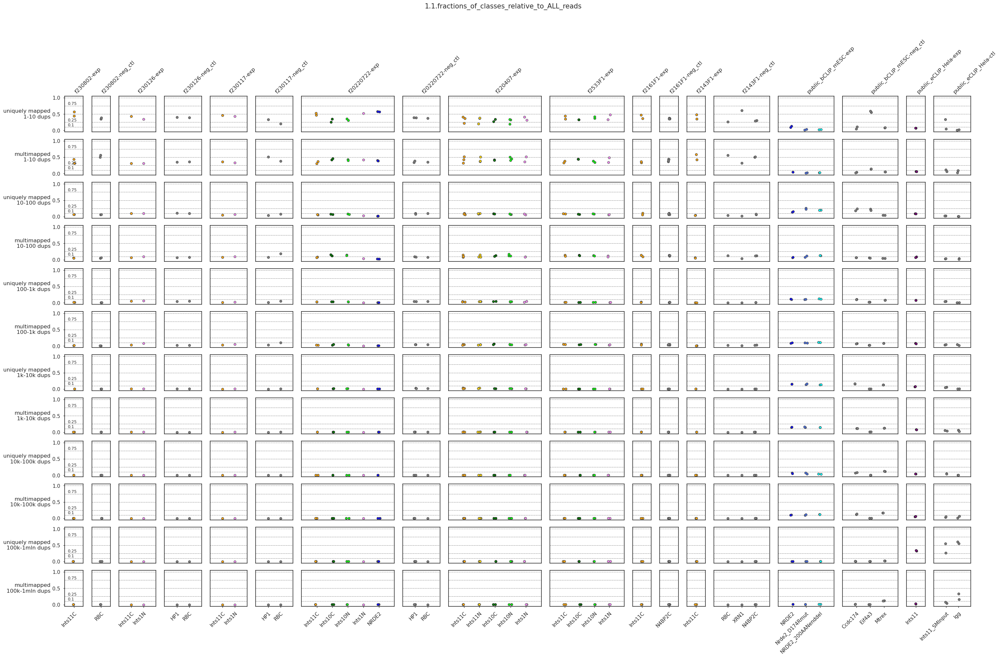

In [78]:
label = '1.1.fractions_of_classes_relative_to_ALL_reads'

data = stats_report_df.copy()
data = pd.pivot_table(data[['sample','count_col','frac_of_ALL_reads']],index='sample',columns='count_col',values='frac_of_ALL_reads').reset_index()
data = pd.merge(data,metadata,how='inner',on='sample')

features_to_plot = count_cols
feature_labels = [get_class_label(feature,dupl_cats_dict) for feature in features_to_plot]
feature_plot_type = ['stripplot']*(len(features_to_plot))
hide_yticks = [False]*(len(features_to_plot))

ylims = [(-0.05,1.05)]*(len(features_to_plot))
horizontal_lines = [[1,0.75,0.5,0.25,0.1]]*(len(features_to_plot))
texts = [[{'y_pos':0.75,'text':'0.75','ha':'left','va':'bottom','size':9},{'y_pos':0.25,'text':'0.25','ha':'left','va':'bottom','size':9},{'y_pos':0.1,'text':'0.1','ha':'left','va':'bottom','size':9}]]*(len(features_to_plot))

marker_sizes = [5]*len(group_1_x_group_2)

plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size,
            subplot_height=1.7,output_dir=subdirs['reports_dir']+'/2_categorization_of_mapped_reads/')

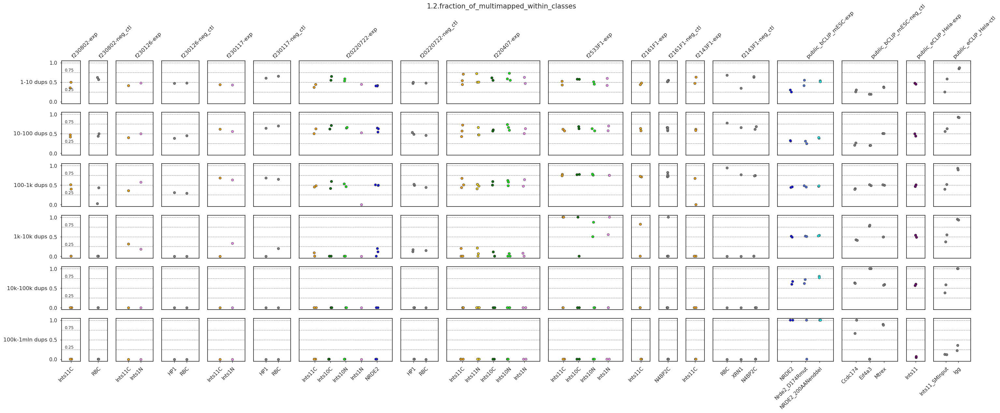

In [79]:
label = '1.2.fraction_of_multimapped_within_classes'

data = stats_report_df.copy()
data = pd.pivot_table(data[['sample','count_col','frac_of_ALL_reads']],index='sample',columns='count_col',values='frac_of_ALL_reads').reset_index()
data = pd.merge(data,metadata,how='inner',on='sample')

features_to_plot = []
feature_labels = []
for dupl_level in list(dupl_cats_dict.keys()):
    mm_col = 'multimapped;'+str(dupl_level)
    um_col = 'uniquely_mapped;'+str(dupl_level)
    data['ratio;'+str(dupl_level)] = (data[mm_col]/(data[mm_col]+data[um_col])).fillna(0)
    features_to_plot.append('ratio;'+str(dupl_level))
    feature_labels.append(dupl_cats_dict[dupl_level]+' dups')

feature_plot_type = ['stripplot']*(len(features_to_plot))
hide_yticks = [False]*(len(features_to_plot))

ylims = [(-0.05,1.05)]*(len(features_to_plot))
horizontal_lines = [[1,0.75,0.5,0.25]]*(len(features_to_plot))
texts = [[{'y_pos':0.75,'text':'0.75','ha':'left','va':'bottom','size':9},{'y_pos':0.25,'text':'0.25','ha':'left','va':'bottom','size':9}]]*(len(features_to_plot))

marker_sizes = [5]*len(group_1_x_group_2)

plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size,
            subplot_height=2,output_dir=subdirs['reports_dir']+'/2_categorization_of_mapped_reads/')

## Detailed analysis of mapping patterns in different read categories

In [385]:
# see another notebook

## Continue here

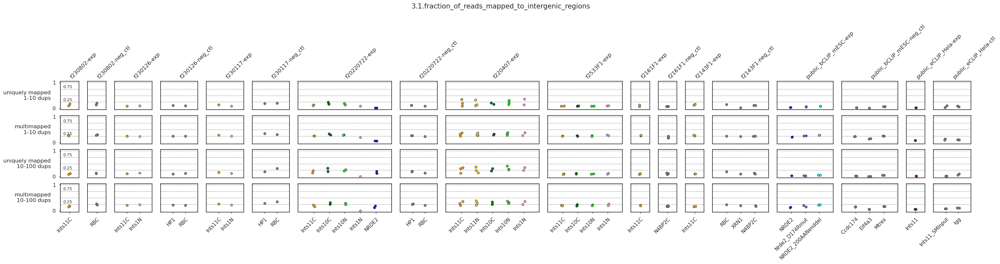

In [87]:
label = '3.1.fraction_of_reads_mapped_to_intergenic_regions'

col_of_interest = 'frac_intergenic'

data = stats_report_df.copy()
data = pd.pivot_table(data[['sample','count_col',col_of_interest]],index='sample',columns='count_col',values=col_of_interest).reset_index()
data = pd.merge(data,metadata,how='inner',on='sample')

features_to_plot = count_cols[:4]
feature_labels = [get_class_label(feature,dupl_cats_dict) for feature in features_to_plot]
feature_plot_type = ['stripplot']*(len(features_to_plot))
hide_yticks = [False]*(len(features_to_plot))

ylims = [(-0.05,1.05)]*(len(features_to_plot))
horizontal_lines = [[1,0.75,0.5,0.25]]*(len(features_to_plot))
texts = [[{'y_pos':0.75,'text':'0.75','ha':'left','va':'bottom','size':9},{'y_pos':0.25,'text':'0.25','ha':'left','va':'bottom','size':9}]]*(len(features_to_plot))

marker_sizes = [5]*len(group_1_x_group_2)

plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size,
            subplot_height=1.3,output_dir=subdirs['reports_dir']+'/2_categorization_of_mapped_reads/')

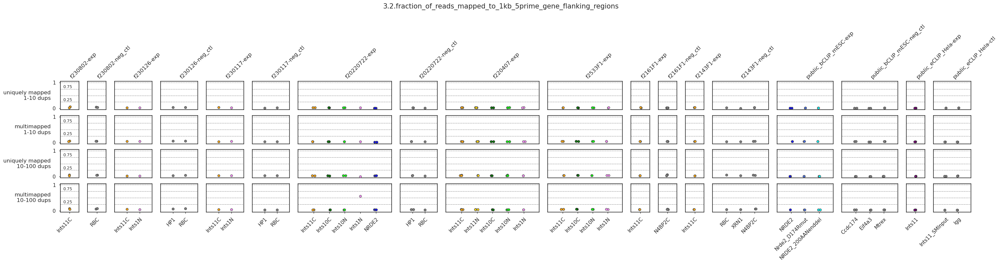

In [88]:
label = '3.2.fraction_of_reads_mapped_to_1kb_5prime_gene_flanking_regions'

col_of_interest = 'frac_five_prime_only_gene_flank'

data = stats_report_df.copy()
data = pd.pivot_table(data[['sample','count_col',col_of_interest]],index='sample',columns='count_col',values=col_of_interest).reset_index()
data = pd.merge(data,metadata,how='inner',on='sample')

features_to_plot = count_cols[:4]
feature_labels = [get_class_label(feature,dupl_cats_dict) for feature in features_to_plot]
feature_plot_type = ['stripplot']*(len(features_to_plot))
hide_yticks = [False]*(len(features_to_plot))

ylims = [(-0.05,1.05)]*(len(features_to_plot))
horizontal_lines = [[1,0.75,0.5,0.25]]*(len(features_to_plot))
texts = [[{'y_pos':0.75,'text':'0.75','ha':'left','va':'bottom','size':9},{'y_pos':0.25,'text':'0.25','ha':'left','va':'bottom','size':9}]]*(len(features_to_plot))

marker_sizes = [5]*len(group_1_x_group_2)

plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size,
            subplot_height=1.3,output_dir=subdirs['reports_dir']+'/2_categorization_of_mapped_reads/')

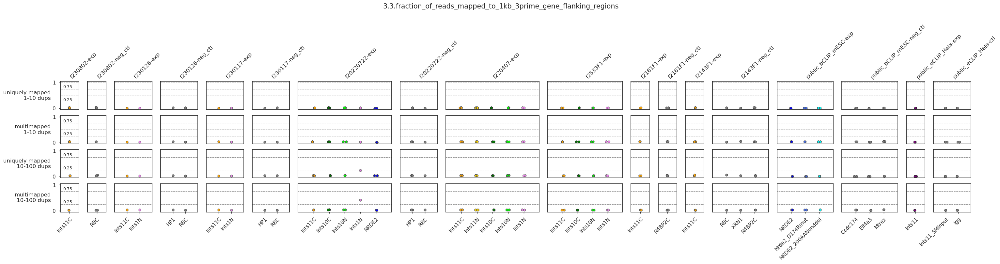

In [90]:
label = '3.3.fraction_of_reads_mapped_to_1kb_3prime_gene_flanking_regions'

col_of_interest = 'frac_three_prime_only_gene_flank'

data = stats_report_df.copy()
data = pd.pivot_table(data[['sample','count_col',col_of_interest]],index='sample',columns='count_col',values=col_of_interest).reset_index()
data = pd.merge(data,metadata,how='inner',on='sample')

features_to_plot = count_cols[:4]
feature_labels = [get_class_label(feature,dupl_cats_dict) for feature in features_to_plot]
feature_plot_type = ['stripplot']*(len(features_to_plot))
hide_yticks = [False]*(len(features_to_plot))

ylims = [(-0.05,1.05)]*(len(features_to_plot))
horizontal_lines = [[1,0.75,0.5,0.25]]*(len(features_to_plot))
texts = [[{'y_pos':0.75,'text':'0.75','ha':'left','va':'bottom','size':9},{'y_pos':0.25,'text':'0.25','ha':'left','va':'bottom','size':9}]]*(len(features_to_plot))

marker_sizes = [5]*len(group_1_x_group_2)

plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size,
            subplot_height=1.3,output_dir=subdirs['reports_dir']+'/2_categorization_of_mapped_reads/')

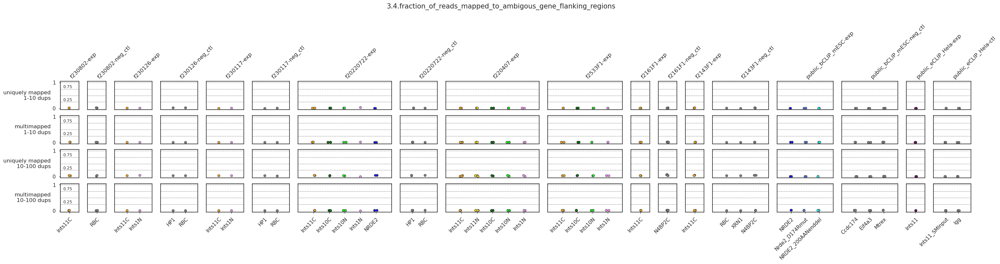

In [91]:
label = '3.4.fraction_of_reads_mapped_to_ambigous_gene_flanking_regions'

col_of_interest = 'frac_five_or_three_prime_gene_flank'

data = stats_report_df.copy()
data = pd.pivot_table(data[['sample','count_col',col_of_interest]],index='sample',columns='count_col',values=col_of_interest).reset_index()
data = pd.merge(data,metadata,how='inner',on='sample')

features_to_plot = count_cols[:4]
feature_labels = [get_class_label(feature,dupl_cats_dict) for feature in features_to_plot]
feature_plot_type = ['stripplot']*(len(features_to_plot))
hide_yticks = [False]*(len(features_to_plot))

ylims = [(-0.05,1.05)]*(len(features_to_plot))
horizontal_lines = [[1,0.75,0.5,0.25]]*(len(features_to_plot))
texts = [[{'y_pos':0.75,'text':'0.75','ha':'left','va':'bottom','size':9},{'y_pos':0.25,'text':'0.25','ha':'left','va':'bottom','size':9}]]*(len(features_to_plot))

marker_sizes = [5]*len(group_1_x_group_2)

plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size,
            subplot_height=1.3,output_dir=subdirs['reports_dir']+'/2_categorization_of_mapped_reads/')

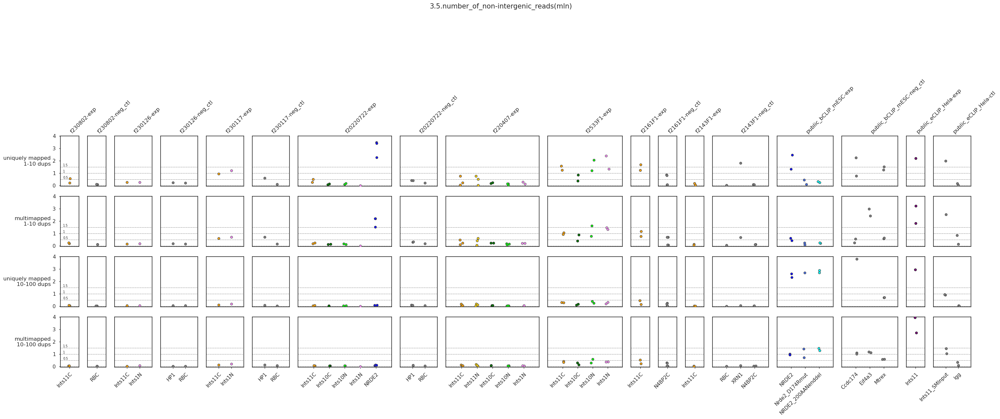

In [98]:
label = '3.5.number_of_non-intergenic_reads(mln)'

col_of_interest = '#non-intergenic_mln'

data = stats_report_df.copy()
data = pd.pivot_table(data[['sample','count_col',col_of_interest]],index='sample',columns='count_col',values=col_of_interest).reset_index()
data = pd.merge(data,metadata,how='inner',on='sample')

features_to_plot = count_cols[:4]
feature_labels = [get_class_label(feature,dupl_cats_dict) for feature in features_to_plot]
feature_plot_type = ['stripplot']*(len(features_to_plot))
hide_yticks = [False]*(len(features_to_plot))

ylims = [(-0.05,4)]*(len(features_to_plot))
horizontal_lines = [[1.5,1,0.5,0]]*(len(features_to_plot))
texts = [[{'y_pos':0.5,'text':'0.5','ha':'left','va':'bottom','size':7},
          {'y_pos':1,'text':'1','ha':'left','va':'bottom','size':7},
         {'y_pos':1.5,'text':'1.5','ha':'left','va':'bottom','size':7}]]*(len(features_to_plot))

marker_sizes = [5]*len(group_1_x_group_2)

plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size,
            subplot_height=2.3,output_dir=subdirs['reports_dir']+'/2_categorization_of_mapped_reads/')

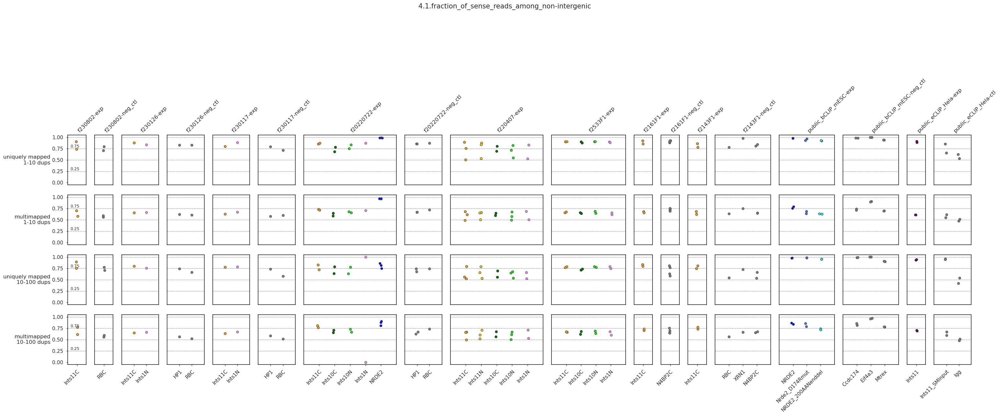

In [99]:
label = '4.1.fraction_of_sense_reads_among_non-intergenic'

col_of_interest = 'frac_sense'

data = stats_report_df.copy()
data = pd.pivot_table(data[['sample','count_col',col_of_interest]],index='sample',columns='count_col',values=col_of_interest).reset_index()
data = pd.merge(data,metadata,how='inner',on='sample')

features_to_plot = count_cols[:4]
feature_labels = [get_class_label(feature,dupl_cats_dict) for feature in features_to_plot]
feature_plot_type = ['stripplot']*(len(features_to_plot))
hide_yticks = [False]*(len(features_to_plot))

ylims = [(-0.05,1.05)]*(len(features_to_plot))
horizontal_lines = [[1,0.75,0.5,0.25]]*(len(features_to_plot))
texts = [[{'y_pos':0.75,'text':'0.75','ha':'left','va':'bottom','size':9},{'y_pos':0.25,'text':'0.25','ha':'left','va':'bottom','size':9}]]*(len(features_to_plot))

marker_sizes = [5]*len(group_1_x_group_2)

plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size,
            subplot_height=2.3,output_dir=subdirs['reports_dir']+'/2_categorization_of_mapped_reads/')

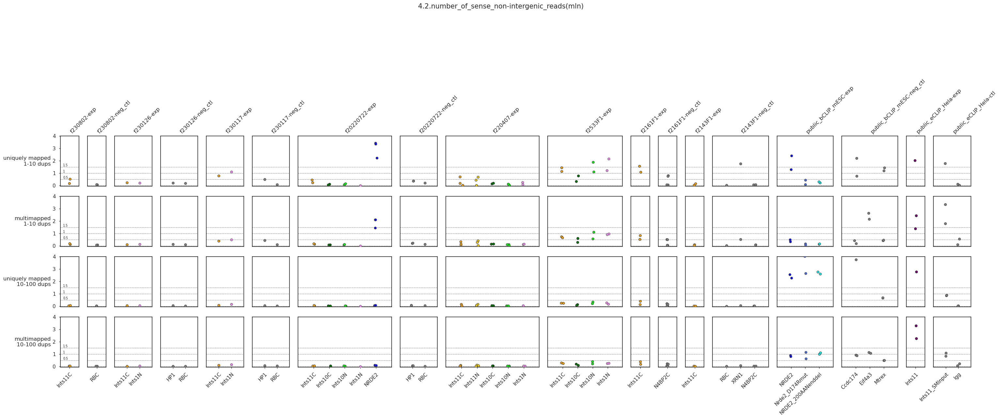

In [102]:
label = '4.2.number_of_sense_non-intergenic_reads(mln)'

col_of_interest = '#sense_non-intergenic_mln'

data = stats_report_df.copy()
data = pd.pivot_table(data[['sample','count_col',col_of_interest]],index='sample',columns='count_col',values=col_of_interest).reset_index()
data = pd.merge(data,metadata,how='inner',on='sample')

features_to_plot = count_cols[:4]
feature_labels = [get_class_label(feature,dupl_cats_dict) for feature in features_to_plot]
feature_plot_type = ['stripplot']*(len(features_to_plot))
hide_yticks = [False]*(len(features_to_plot))

ylims = [(-0.05,4)]*(len(features_to_plot))
horizontal_lines = [[1.5,1,0.5,0]]*(len(features_to_plot))
texts = [[{'y_pos':0.5,'text':'0.5','ha':'left','va':'bottom','size':7},
          {'y_pos':1,'text':'1','ha':'left','va':'bottom','size':7},
         {'y_pos':1.5,'text':'1.5','ha':'left','va':'bottom','size':7}]]*(len(features_to_plot))

marker_sizes = [5]*len(group_1_x_group_2)

plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size,
            subplot_height=2.3,output_dir=subdirs['reports_dir']+'/2_categorization_of_mapped_reads/')

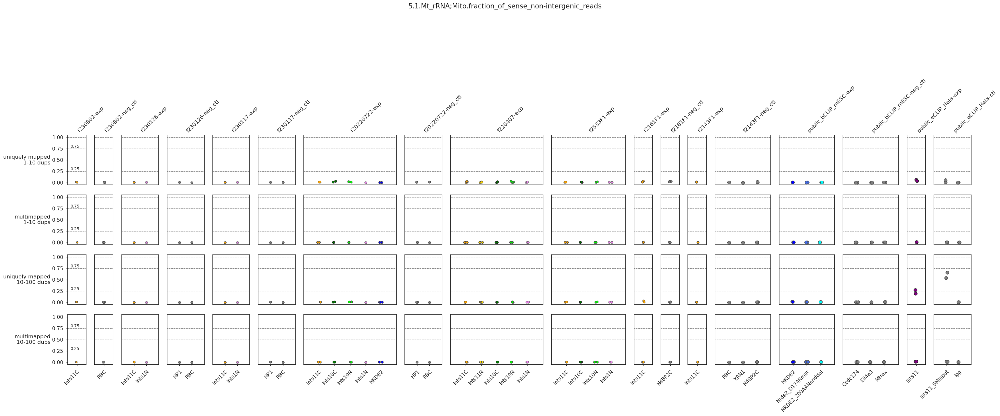

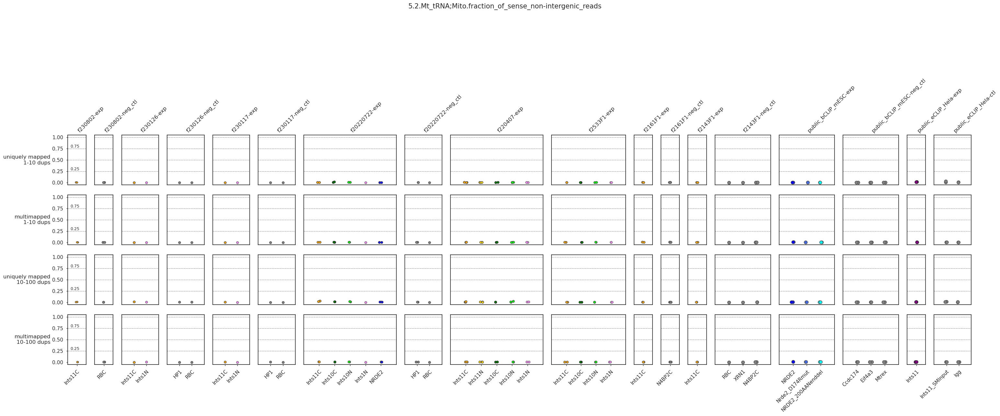

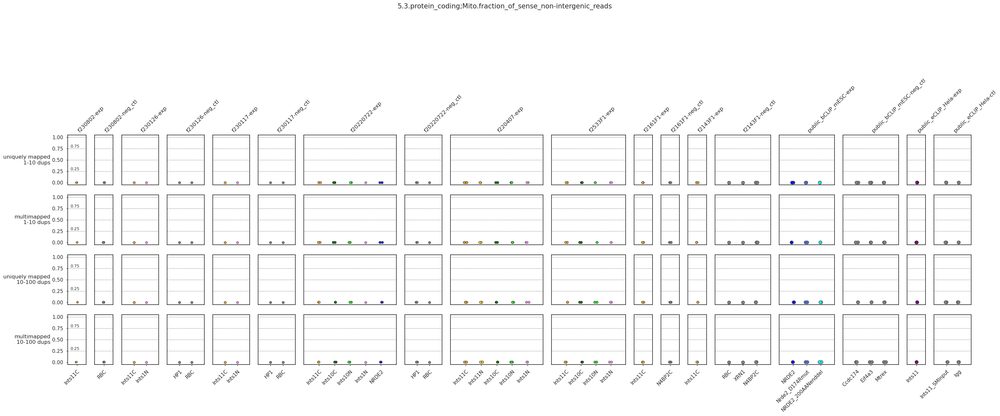

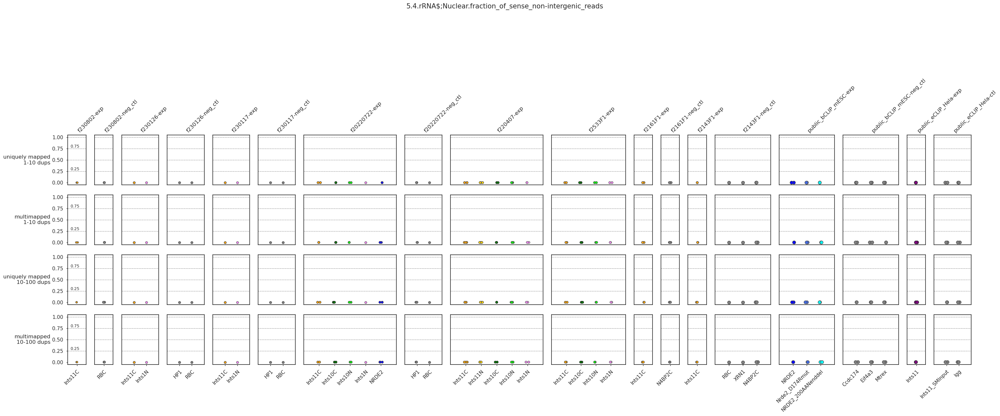

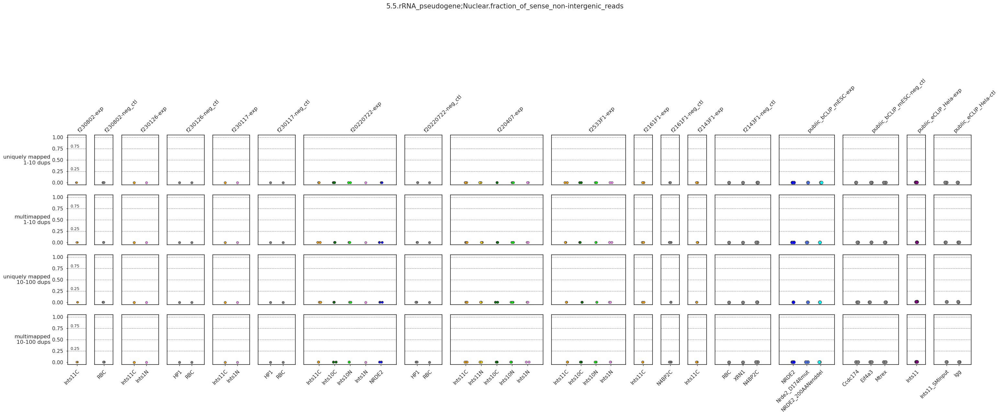

...

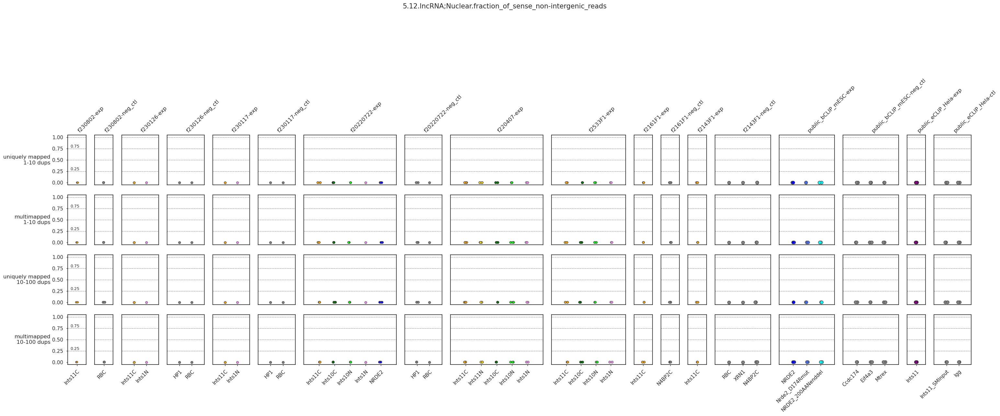

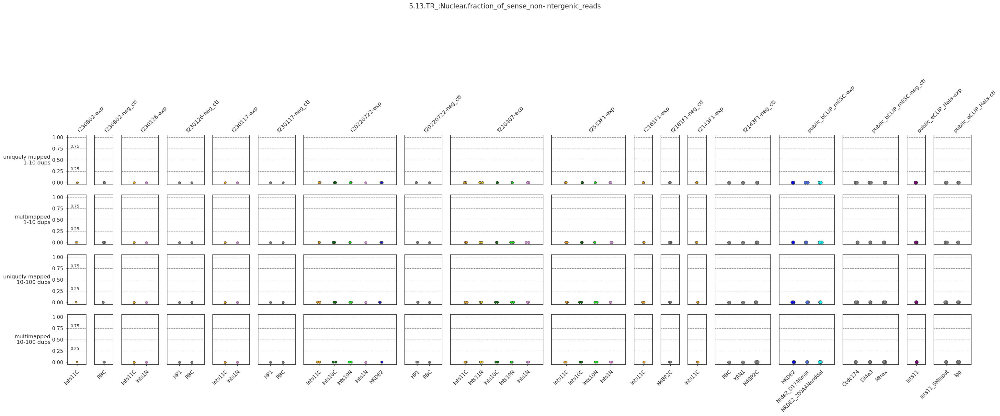

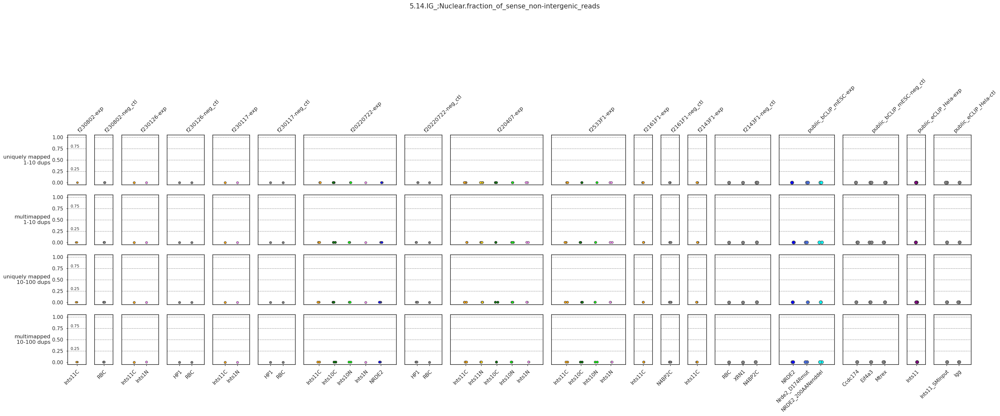

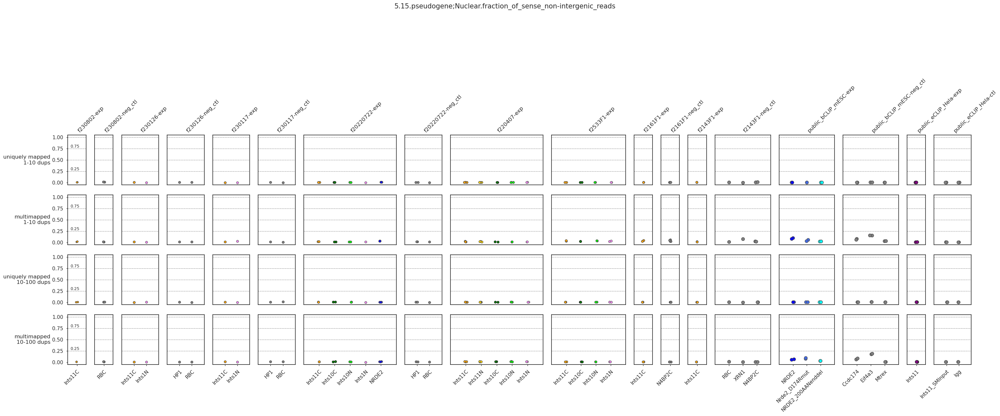

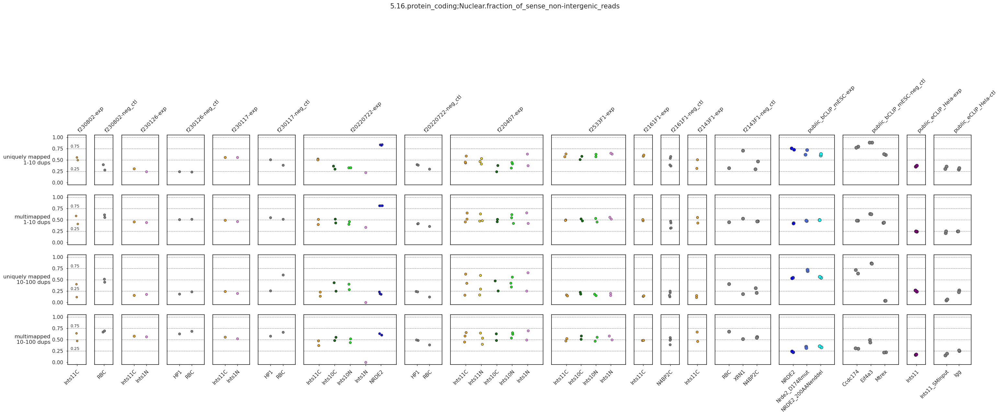

In [104]:
k=1
for gene_biotype in gene_biotypes_hiararchy:
    label = '5.'+str(k)+'.'+gene_biotype+'.fraction_of_sense_non-intergenic_reads'

    col_of_interest = 'frac_of_'+gene_biotype

    data = stats_report_df.copy()
    data = pd.pivot_table(data[['sample','count_col',col_of_interest]],index='sample',columns='count_col',values=col_of_interest).reset_index()
    data = pd.merge(data,metadata,how='inner',on='sample')

    features_to_plot = count_cols[:4]
    feature_labels = [get_class_label(feature,dupl_cats_dict) for feature in features_to_plot]
    feature_plot_type = ['stripplot']*(len(features_to_plot))
    hide_yticks = [False]*(len(features_to_plot))

    ylims = [(-0.05,1.05)]*(len(features_to_plot))
    horizontal_lines = [[1,0.75,0.5,0.25]]*(len(features_to_plot))
    texts = [[{'y_pos':0.75,'text':'0.75','ha':'left','va':'bottom','size':9},{'y_pos':0.25,'text':'0.25','ha':'left','va':'bottom','size':9}]]*(len(features_to_plot))

    marker_sizes = [4]+[5]*(len(group_1_x_group_2)-6)+[7]*5

    plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size,
                subplot_height=2.3,output_dir=subdirs['reports_dir']+'/2_categorization_of_mapped_reads/')
        
    k=k+1

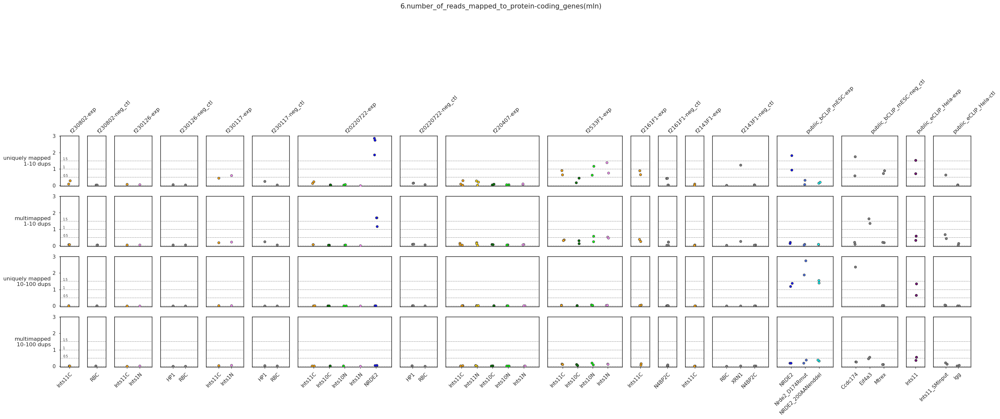

In [109]:
label = '6.number_of_reads_mapped_to_protein-coding_genes(mln)'

col_of_interest = '#protein_coding_mln'

data = stats_report_df.copy()
data = pd.pivot_table(data[['sample','count_col',col_of_interest]],index='sample',columns='count_col',values=col_of_interest).reset_index()
data = pd.merge(data,metadata,how='inner',on='sample')

features_to_plot = count_cols[:4]
feature_labels = [get_class_label(feature,dupl_cats_dict) for feature in features_to_plot]
feature_plot_type = ['stripplot']*(len(features_to_plot))
hide_yticks = [False]*(len(features_to_plot))

ylims = [(-0.1,3)]*(len(features_to_plot))
horizontal_lines = [[1.5,1,0.5,0]]*(len(features_to_plot))
texts = [[{'y_pos':0.5,'text':'0.5','ha':'left','va':'bottom','size':7},
          {'y_pos':1,'text':'1','ha':'left','va':'bottom','size':7},
         {'y_pos':1.5,'text':'1.5','ha':'left','va':'bottom','size':7}]]*(len(features_to_plot))

marker_sizes = [5]*len(group_1_x_group_2)

plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size,
            subplot_height=2.3,output_dir=subdirs['reports_dir']+'/2_categorization_of_mapped_reads/')

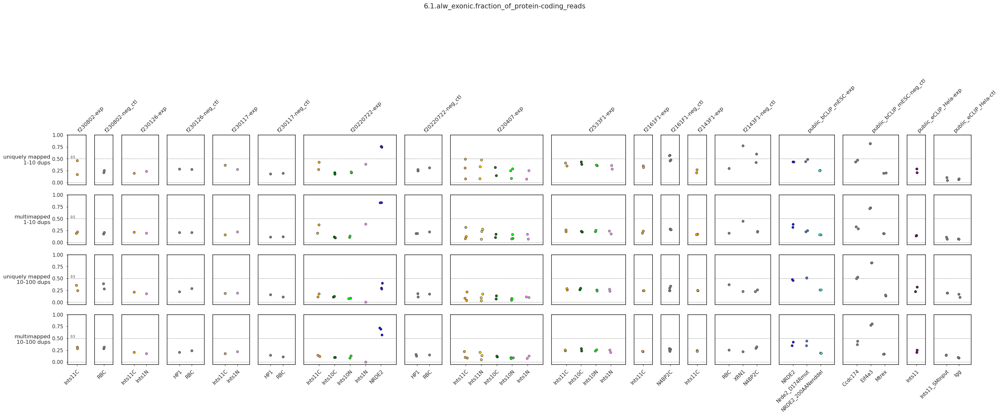

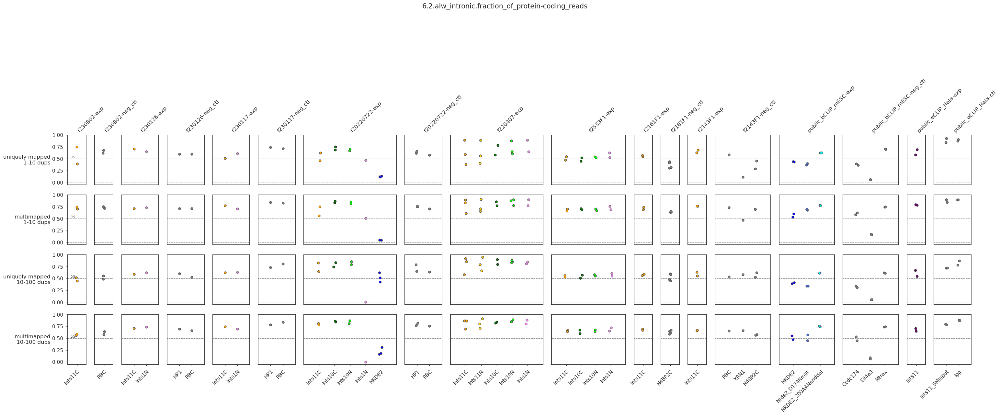

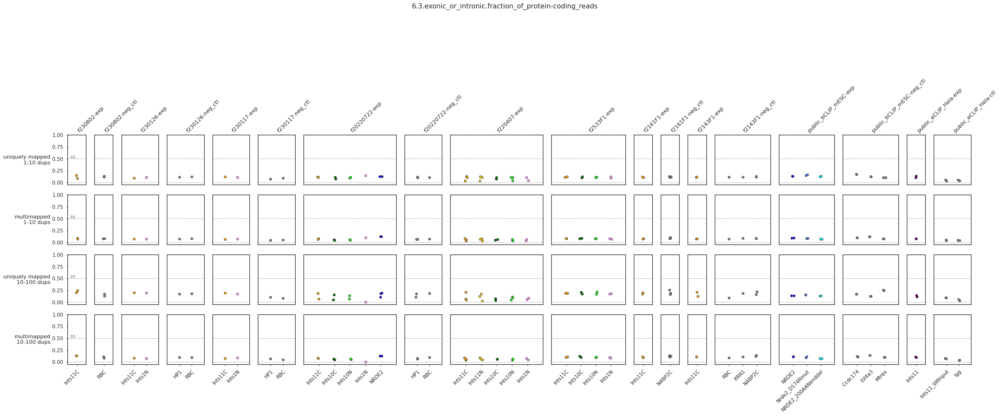

In [111]:
cats = ['alw_exonic','alw_intronic','exonic_or_intronic']

k=1
for cat in cats:
    label = '6.'+str(k)+'.'+cat+'.fraction_of_protein-coding_reads'

    col_of_interest = 'frac_of_'+cat

    data = stats_report_df.copy()
    data = pd.pivot_table(data[['sample','count_col',col_of_interest]],index='sample',columns='count_col',values=col_of_interest).reset_index()
    data = pd.merge(data,metadata,how='inner',on='sample')

    features_to_plot = count_cols[:4]
    feature_labels = [get_class_label(feature,dupl_cats_dict) for feature in features_to_plot]
    feature_plot_type = ['stripplot']*(len(features_to_plot))
    hide_yticks = [False]*(len(features_to_plot))

    ylims = [(-0.05,1)]*(len(features_to_plot))
    horizontal_lines = [[1,0.5,0]]*(len(features_to_plot))
    texts = [[{'y_pos':0.5,'text':'0.5','ha':'left','va':'bottom','size':7}]]*(len(features_to_plot))

    marker_sizes = [5]*len(group_1_x_group_2)

    plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size,
                subplot_height=2.3,output_dir=subdirs['reports_dir']+'/2_categorization_of_mapped_reads/')
        
    k=k+1

# Metaplots

In [ ]:
# copy to reports dir



# PCA and UMAPs on TSS measures

In [66]:
# find paths to quantification of EXONIC-INTRONIC-INTERGENIC segments
sample_file_name = subdirs['temp_dir']+'sel_TSSs_counts_file_paths.tsv'
os.system("""find """+subdirs['results']+""" -name '*.wd_counts.tsv' > """+sample_file_name)

In [8]:
sample_file_name = subdirs['temp_dir']+'sel_TSSs_counts_file_paths.tsv'
wd_counts_file_paths = pd.read_csv(sample_file_name,delimiter="\t",index_col=None,header=None)
wd_counts_file_paths.columns = ['path']
wd_counts_file_paths = wd_counts_file_paths.loc[wd_counts_file_paths['path'].str.contains('sel_TSSs')].reset_index(drop=True)
wd_counts_file_paths['sample'] = wd_counts_file_paths.apply(lambda x:os.path.basename(x['path']).split('.')[0],1)
wd_counts_file_paths['chr'] = wd_counts_file_paths.apply(lambda x:os.path.basename(x['path']).split('.')[1],1)
wd_counts_file_paths = pd.merge(wd_counts_file_paths,metadata[['sample','organism','group_1','group_2','group_3','group_1_x_group_2','replicate','color']],how='left',on=['sample'])

In [9]:
col_name = 'uniquely_mapped;0'

# analyze mouse
big_expression_dict = {}
sample_metadata_dict = {}
for organism in ['mouse','human']:
    sel_files = wd_counts_file_paths.loc[(wd_counts_file_paths['organism']==organism)].reset_index(drop=True)
    cur_sample_metadata = sel_files[['sample','organism','group_1','group_2','group_3','group_1_x_group_2','replicate','color']].drop_duplicates().reset_index(drop=True)
    
    big_expression_matrix_list = []
    for chr in list(sel_files['chr'].unique()):
        a = []
        i=0
        for index,row in sel_files.loc[sel_files['chr']==chr].iterrows():
            tmp = pd.read_csv(row['path'],delimiter="\t",index_col=None,header=0)
            if col_name not in list(tmp.columns):
                tmp[col_name] = 0
            tmp = tmp.rename(columns={col_name:row['sample']})
            if i==0:
                cols_to_include = ['segment_name','strand',row['sample']]
            else:
                cols_to_include = [row['sample']]
            a.append(tmp[cols_to_include])
            i=i+1
        expr_matrix = pd.concat(a,axis=1)
        expr_matrix['region'] = expr_matrix['segment_name'].str.split(';',expand=True)[0]
        expr_matrix['TSS'] = expr_matrix['segment_name'].str.split(';',expand=True)[1]
        expr_matrix['gene_name'] = expr_matrix['segment_name'].str.split(';',expand=True)[3]
        big_expression_matrix_list.append(expr_matrix)
        print(organism+' '+chr+' done')
    big_expression_matrix = pd.concat(big_expression_matrix_list,axis=0).reset_index(drop=True)
    list_of_samples = list(cur_sample_metadata['sample'])
    big_expression_matrix[list_of_samples] = big_expression_matrix[list_of_samples].astype('int')
    
    big_expression_dict[organism] = big_expression_matrix.copy()
    sample_metadata_dict[organism] = cur_sample_metadata.copy()

mouse chr16 done
mouse chr6 done
mouse chr18 done
mouse chr12 done
mouse chr15 done
mouse chr8 done
mouse chr1 done
mouse chr10 done
mouse chrM done
mouse chr2 done
mouse chr19 done
mouse chr14 done
mouse chr7 done
mouse chr13 done
mouse chrY done
mouse chr3 done
mouse chr5 done
mouse chr11 done
mouse chr17 done
mouse chr9 done
mouse chr4 done
mouse chrX done
human chr14 done
human chr13 done
human chr15 done
human chr4 done
human chr22 done
human chr1 done
human chr16 done
human chr18 done
human chr10 done
human chr12 done
human chr2 done
human chr6 done
human chr17 done
human chr19 done
human chrM done
human chrY done
human chr8 done
human chr7 done
human chr21 done
human chr5 done
human chrX done
human chr9 done
human chr11 done
human chr3 done
human chr20 done


In [10]:
%%time

# set parallelization parameters
from swifter import set_defaults
set_defaults(
    npartitions=200,
    dask_threshold=0.001,
    scheduler="processes",
    progress_bar=False,
    progress_bar_desc=None,
    allow_dask_on_strings=True,
    force_parallel=True,
)

# expected are signal, control down, control up
def get_dirichlet_rvs_pval(obs_conc):
    alpha = np.array(obs_conc)  # specify concentration parameters
    size = 100000
    a = dirichlet.rvs(alpha,size=size,random_state=1)
    a = pd.DataFrame(a)
    pval = len(a.loc[~((a[0]>a[1]+a[2])|((a[0]>=a[1])&(a[1]>=a[2])))])/size
    return pval

def get_dirichlet_pdf(x1,x2,t0,t1,t2):
    alpha = [t0,t1,t2]  # concentration parameters
    if not((x1>0.5) or ((x1>=x2)&(2*x2+x1>=1))) and x1+x2<=1:
        return dirichlet.pdf([x1,x2,max(1-x1-x2,0)], alpha)
    else:
        return 0

def get_dirichlet_pval(obs_conc,needs_accurate_calcs=False):
    total_count = np.sum(obs_conc)
    if needs_accurate_calcs:
        epsabs = 10**((total_count/5)*(-1))
        limit = max(min(total_count,25),5)
    else:
        epsabs = 0.1
        limit = 4
    lim1,lim2 = [0,1],[0,1]
    warnings.filterwarnings("ignore")
    pval = integrate.nquad(get_dirichlet_pdf, [lim1,lim2], opts = {'epsabs':epsabs,'limit':limit}, args=obs_conc)[0]
    return pval

pseudocount = 1
genes_of_interest = ['GM3854', 'MEF2B', 'GM14401', 'ZBTB2', 'BC025920', 'ZFP872', 'AW146154', 'CEBPD', 
                     '2610044O15RIK8', 'HES6', 'JAZF1', 'ZFP119A', 'ZFP53', 'EBF1', 'AI987944', 'ZFP747', 
                     'JUN', 'ZFP52', 'ZSCAN29', 'ZBTB7C', 'CSRNP2', 'SNAI1', 'ID1', 'SOX5', 'ARID5A', 'CEBPA', 'GBX2', 'ZFP707', 
                     'EOMES', 'ZKSCAN14', 'FOSL2', 'ZBTB49', 'CREB3L1', 'ATF3', 'DACH2', 'DDIT3', 'ZFP521', 'ZFP51', 'ZFP54', 
                     'RUNX1', 'HES1', 'MYC', 'ID4', 'TFAP2A', 'FOS', 'ID2', 'PAX5', 'ID3']
log2FCs_ProSeq = [0.675, 0.611, 0.693, 0.605, 0.789, 1.056, 0.681, 0.91, 0.624, 0.925, 0.682, 0.589, 0.657, 0.85, 0.601, 0.777, 
            0.948, 0.634, 0.739, 0.693, 0.867, 0.924, 1.151, 0.728, 0.669, 0.89, 0.831, 0.817, 0.639, 0.887, 0.832, 0.664, 
            0.703, 0.655, 0.588, 0.644, 0.585, 0.676, 1.098, 0.837, 0.723, 0.628, 0.854, 0.888, 1.347, 1.423, 0.995, 0.73]
# genes_of_interest = ['GM3854', 'MEF2B', 'GM14401', 'ZBTB2', 'BC025920']

melted_list = []
for organism in list(metadata['organism'].unique()):
    tmp = big_expression_dict[organism]
    
    cur_sample_metadata = sample_metadata_dict[organism]
    list_of_samples = list(cur_sample_metadata['sample'])
    
    sel = tmp.loc[tmp['gene_name'].str.upper().isin(genes_of_interest)].reset_index(drop=True)
    
    k=0
    for region in ['signal','control_down','control_up']:
        melted_tmp = pd.melt(sel.loc[sel['region']==region],id_vars=['TSS','gene_name','strand'],value_vars=list_of_samples,var_name='sample',value_name=region)
        if k==0:
            melted = melted_tmp.copy()
        else:
            melted = pd.merge(melted,melted_tmp,how='outer',on=['TSS','gene_name','strand','sample'])
        k=k+1
    melted_list.append(melted)
melted = pd.concat(melted_list).reset_index(drop=True)

# add logs
melted['log2_signal'] = np.log2(melted['signal']+pseudocount)
melted['log2_control_down'] = np.log2(melted['control_down']+pseudocount)
melted['log2_control_up'] = np.log2(melted['control_up']+pseudocount)
melted['log2FC_rel_down'] = melted['log2_signal']-melted['log2_control_down']
melted['log2FC_rel_up'] = melted['log2_signal']-melted['log2_control_up']
melted['needs_accurate_calcs'] = ((melted['signal']>melted['control_down']+melted['control_up'])|((melted['signal']>melted['control_down'])&(melted['control_down']>melted['control_up']))).astype('boolean')
# add dirichlet score
tmp = melted[['signal','control_down','control_up','needs_accurate_calcs']].drop_duplicates().reset_index(drop=True)

tmp['dirichlet_pval'] = tmp.swifter.apply(lambda x:get_dirichlet_pval([x['signal']+pseudocount,x['control_down']+pseudocount,x['control_up']+pseudocount],x['needs_accurate_calcs']),1)
# melted['dirichlet_pval'] = melted.apply(lambda x:get_dirichlet_pval([x['signal']+pseudocount,x['control_down']+pseudocount,x['control_up']+pseudocount]),1)
tmp['dirichlet_score'] = np.log10(tmp['dirichlet_pval'])*(-1)
melted = pd.merge(melted,tmp,how='left',on=['signal','control_down','control_up','needs_accurate_calcs'])

# add metadata labels
melted = pd.merge(melted,metadata[['sample','organism','group_1','group_2','group_3','color','group_1_x_group_2','replicate']],how='left',on=['sample'])

melted['gene_name'] = melted['gene_name'].str.upper()
melted['TSS'] = melted['TSS'].astype('int')

CPU times: user 25.3 s, sys: 7.24 s, total: 32.6 s
Wall time: 1min 42s


In [11]:
tmp = melted[['organism','gene_name','strand','TSS']].drop_duplicates().sort_values(['organism','gene_name','strand','TSS']).reset_index(drop=True)
tmp['t']=1
tmp = pd.merge(tmp.drop('t',1),tmp.groupby(['organism','gene_name','strand']).agg({'t':sum}).reset_index(),how='left',on=['organism','gene_name','strand'])

cur_TSS_index = 1
prev_gene = ''
prev_organism = ''
a = []
for index,row in tmp.iterrows():
    if row['gene_name']!=prev_gene or row['organism']!=prev_organism:
        cur_TSS_index = 1
    if row['strand']=='+':
        TSS_label = cur_TSS_index
    else:
        TSS_label = row['t']-cur_TSS_index+1
    a.append(TSS_label)
    cur_TSS_index = cur_TSS_index+1
    prev_gene = row['gene_name']
    prev_organism = row['organism']
tmp['TSS_label'] = a
if 'TSS_label' in list(melted.columns):
    melted = melted.drop('TSS_label',1)
melted = pd.merge(melted,tmp[['organism','gene_name','strand','TSS','TSS_label']],how='left',on=['organism','gene_name','strand','TSS'])

melted['t']=1
melted = pd.merge(melted.drop('t',1),melted.groupby(['gene_name','TSS_label']).agg({'t':sum}).reset_index(),how='left',on=['gene_name','TSS_label'])

CPU times: user 4min 25s, sys: 16.4 s, total: 4min 42s
Wall time: 4min 21s


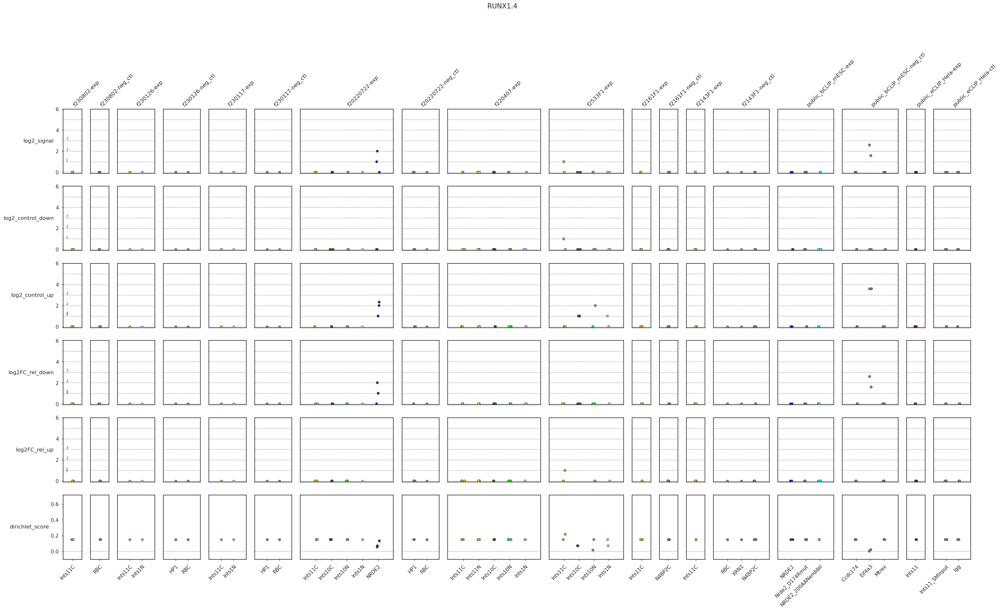

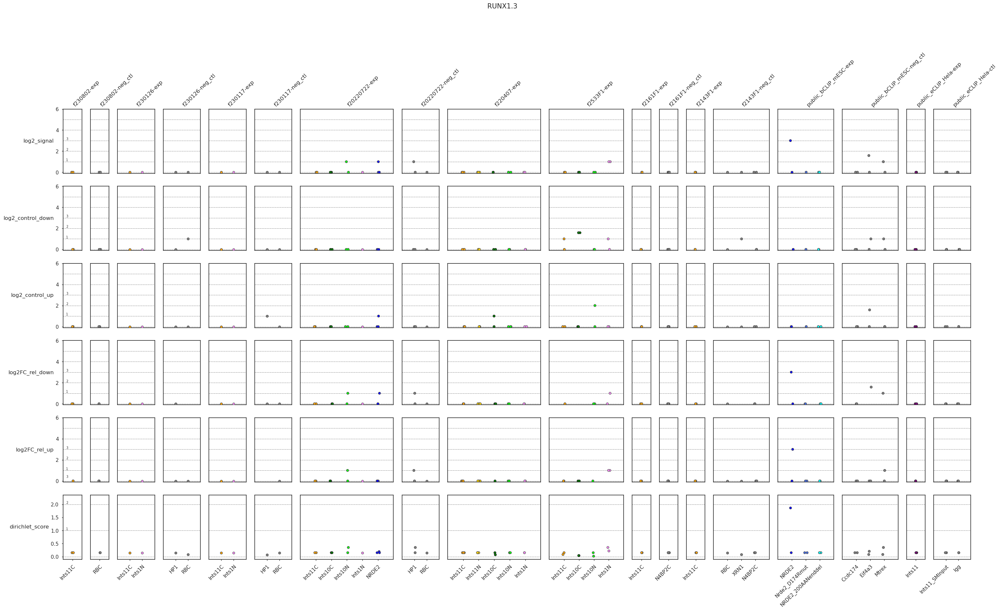

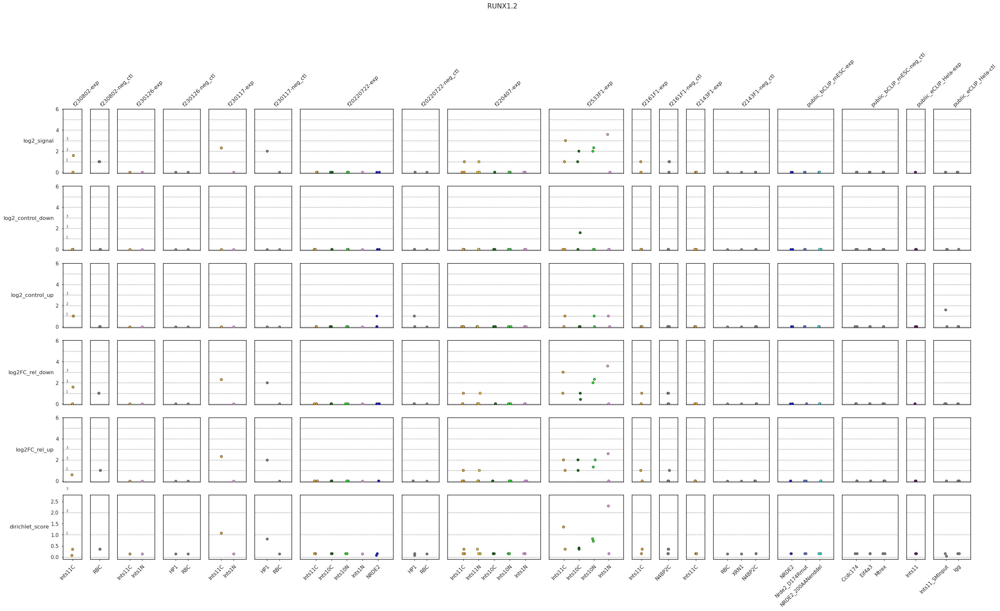

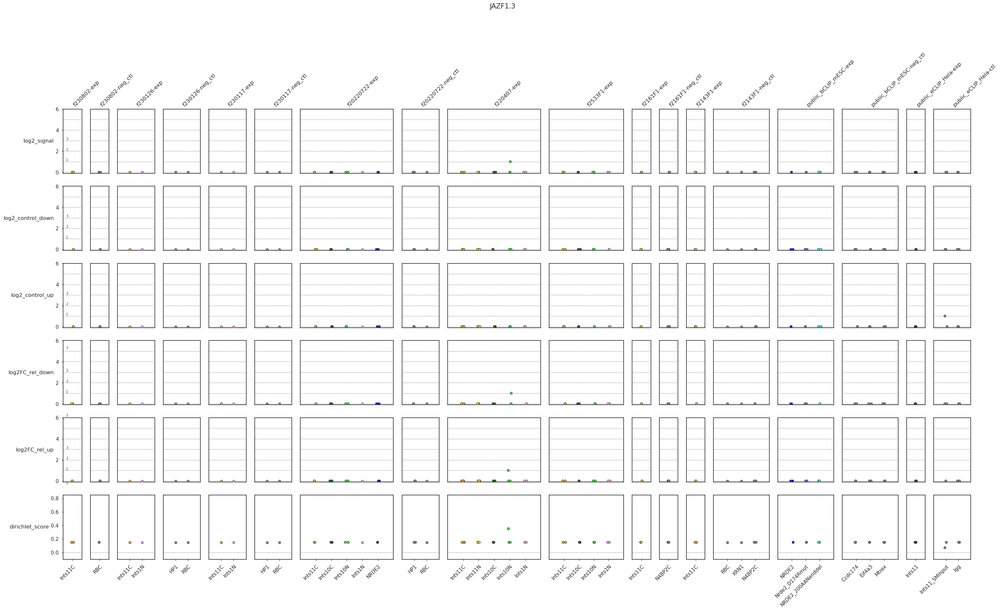

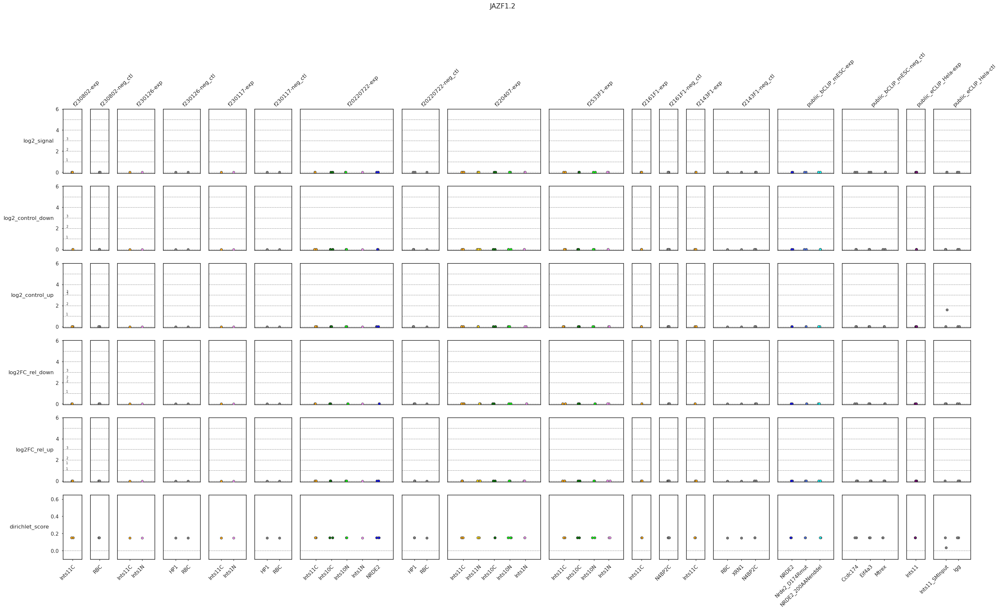

...

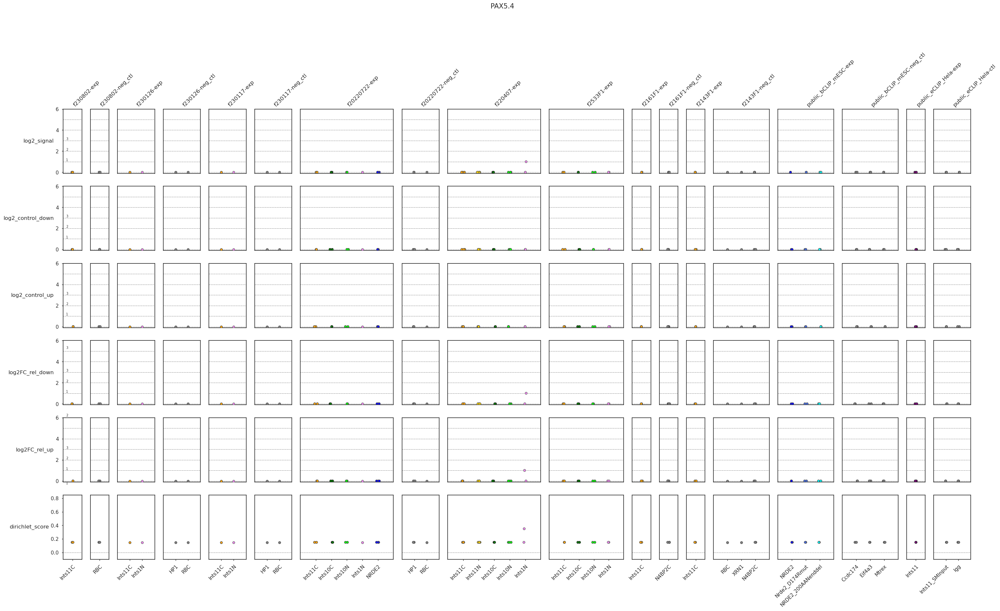

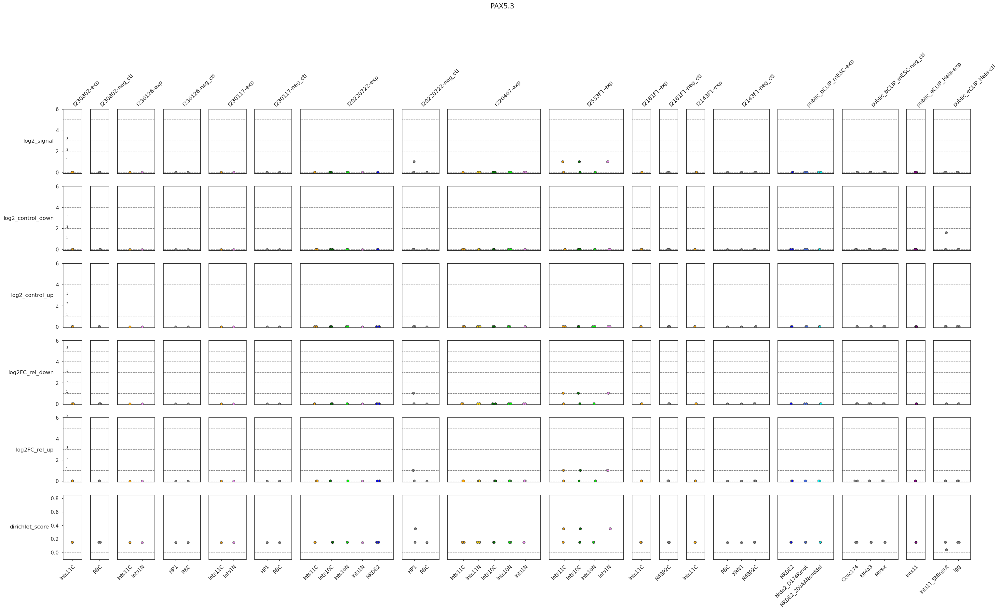

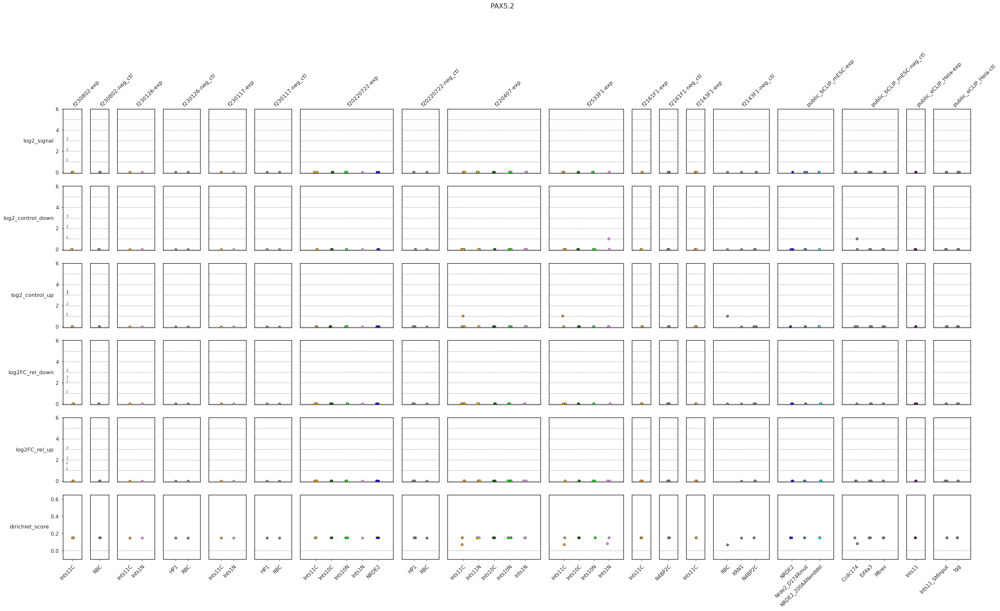

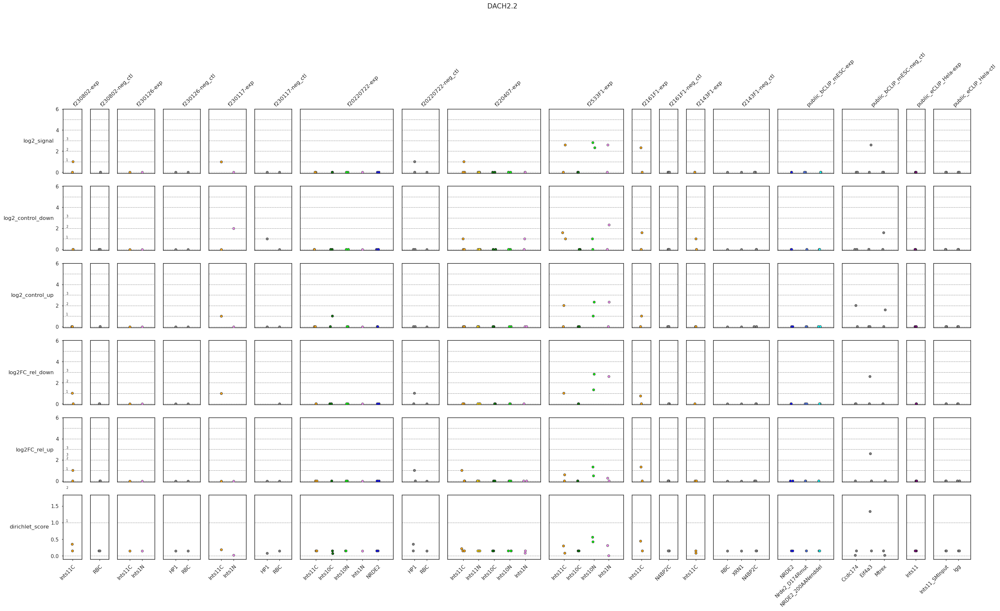

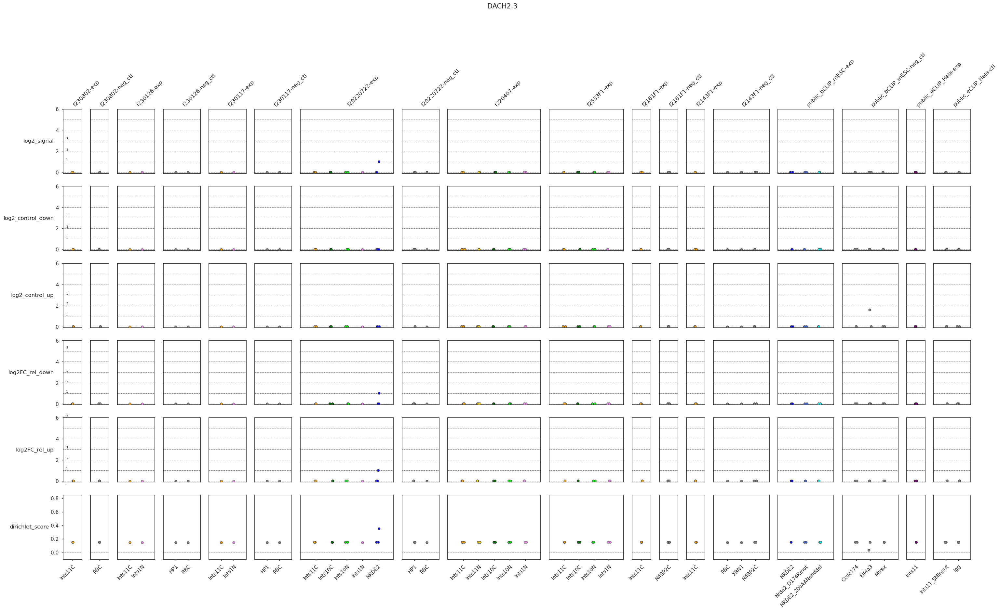

In [22]:
%%time
set_to_analyze = melted.loc[(melted['t']==melted['t'].max())&(melted['TSS_label']!=1)][['gene_name','TSS_label']].drop_duplicates().reset_index(drop=True)

for index,row in set_to_analyze.iterrows():
    data = melted.loc[(melted['gene_name']==row['gene_name'])&(melted['TSS_label']==row['TSS_label'])].reset_index(drop=True).copy()
    label = row['gene_name']+'.'+str(row['TSS_label'])
    
    features_to_plot = ['log2_signal','log2_control_down','log2_control_up','log2FC_rel_down','log2FC_rel_up','dirichlet_score']
    feature_labels = [feature for feature in features_to_plot]
    feature_plot_type = ['stripplot']*(len(features_to_plot))
    hide_yticks = [False]*(len(features_to_plot))

    ylims = []
    for feature in features_to_plot:
        if feature=='dirichlet_score':
            ylims.append((-0.1,data[feature].max()+0.5))
        else:
            ylims.append((-0.1,6))
    horizontal_lines = [[5,4,3,2,1,0]]*(len(features_to_plot))
    texts = [[{'y_pos':1,'text':'1','ha':'left','va':'bottom','size':7},
              {'y_pos':2,'text':'2','ha':'left','va':'bottom','size':7},
             {'y_pos':3,'text':'3','ha':'left','va':'bottom','size':7}]]*(len(features_to_plot))
    
    marker_sizes = [5]*len(group_1_x_group_2)
    
    plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size,
                subplot_height=3.0,output_dir=subdirs['reports_dir']+'/5_quantification_of_TSSs/by_TSS/')

CPU times: user 2.42 s, sys: 282 ms, total: 2.7 s
Wall time: 2.33 s
CPU times: user 265 ms, sys: 3.02 ms, total: 269 ms
Wall time: 267 ms
CPU times: user 300 ms, sys: 45.2 ms, total: 345 ms
Wall time: 287 ms
CPU times: user 294 ms, sys: 52.2 ms, total: 346 ms
Wall time: 264 ms
CPU times: user 667 ms, sys: 148 ms, total: 816 ms
Wall time: 612 ms
CPU times: user 327 ms, sys: 59.7 ms, total: 386 ms
Wall time: 316 ms
CPU times: user 2.02 s, sys: 142 ms, total: 2.17 s
Wall time: 1.97 s
CPU times: user 347 ms, sys: 44.9 ms, total: 392 ms
Wall time: 333 ms
CPU times: user 616 ms, sys: 152 ms, total: 768 ms
Wall time: 547 ms
CPU times: user 2.13 s, sys: 172 ms, total: 2.3 s
Wall time: 2.08 s
CPU times: user 2.34 s, sys: 138 ms, total: 2.48 s
Wall time: 2.28 s
CPU times: user 551 ms, sys: 70.3 ms, total: 621 ms
Wall time: 515 ms
CPU times: user 1.27 s, sys: 161 ms, total: 1.43 s
Wall time: 1.19 s
CPU times: user 478 ms, sys: 9.13 ms, total: 487 ms
Wall time: 477 ms
CPU times: user 697 ms, sys: 

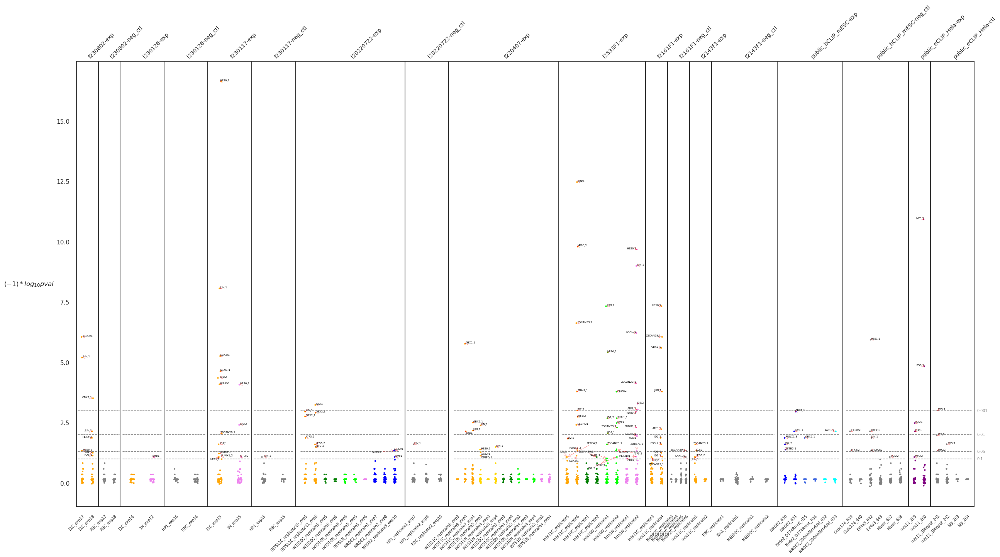

In [137]:
group_1_x_group_2_df = pd.DataFrame(group_1_x_group_2,columns = ['group_1','group_2'])
group_1_x_group_2_df['group_1_x_group_2'] = group_1_x_group_2_df['group_1']+'-'+group_1_x_group_2_df['group_2']
group_1_x_group_2_df['order_gr1xgr2'] = group_1_x_group_2_df.index+1

group_3_df = pd.DataFrame(group_3_order,columns=['group_3'])
group_3_df['order_gr3'] = group_3_df.index+1

sample_order_df = pd.merge(metadata[['sample','replicate','color','group_1_x_group_2','group_3']],group_1_x_group_2_df[['group_1_x_group_2','order_gr1xgr2']],how='left',on=['group_1_x_group_2'])
sample_order_df = pd.merge(sample_order_df,group_3_df[['group_3','order_gr3']],how='left',on=['group_3'])
sample_order_df = sample_order_df.sort_values(['order_gr1xgr2','order_gr3']).reset_index(drop=True)

excl_genes = ['ARID5A','ZBTB49','DDIT3']

data = melted.loc[(~melted['gene_name'].isin(excl_genes))&(melted['t']==melted['t'].max())].reset_index(drop=True).copy()
# data['dirichlet_fdr'] = multipletests(pvals = data['dirichlet_pval'],method='fdr_bh')[1]
data['dirichlet_fdr'] = data['dirichlet_pval']
data['dirichlet_fdr_score'] = np.log10(data['dirichlet_fdr'])*(-1)
hor_lines = [0.001,0.01,0.05,0.1]
hor_lines_vals = np.log10(hor_lines)*(-1)

xfeature, yfeature = 'replicate','dirichlet_fdr_score'
yfeature_label = r'$(-1)*log_{10}pval$'
yfeature_thr = np.log10(0.1)*(-1)

sns.set(font_scale=1)
sns.set_style("white")
fig, axes = plt.subplots(1, len(group_1_x_group_2), sharey=True, sharex=False, figsize=(30,15),gridspec_kw={'width_ratios': point_plots_width_ratios})

j=0
for index,row in group_1_x_group_2_df.iterrows():
    data_cur = data.loc[data['group_1_x_group_2']==row['group_1_x_group_2']].reset_index(drop=True).copy()
    sample_order_df_cur = sample_order_df.loc[sample_order_df['sample'].isin(list(data_cur['sample']))].sort_values(['order_gr1xgr2','order_gr3']).reset_index(drop=True)
    ax = sns.stripplot(ax=axes[j],data = data_cur,x=xfeature,y=yfeature,s=3,palette = list(sample_order_df_cur['color']),order = list(sample_order_df_cur[xfeature]))
    
    ax.set_xticklabels(labels = ax.get_xticklabels(), rotation=rotation_degree, ha='right',va='top',rotation_mode='anchor',size=7)
    ax.set_ylabel(ylabel=(yfeature_label if j==0 else None),rotation=0,ha='right',va='center',rotation_mode='anchor')
    ax.set_title(row['group_1_x_group_2'], 
             y=1., \
             rotation = rotation_degree, 
             ha='left',
             fontsize=10,
            )
    ax.set(xlabel='',)
    lims = (ax.get_xlim()[0],ax.get_xlim()[1])
    k=0
    for hor_lines_val in hor_lines_vals:
        ax.hlines(y=hor_lines_val,xmin=lims[0],xmax=lims[1],color='grey',linestyles='--',linewidth=1)
        if j==(len(group_1_x_group_2_df)-1):
            ax.text(len(sample_order_df_cur),hor_lines_val,hor_lines[k],color='grey',ha='left',va='center',size=7)
        k=k+1

    l=0
    texts=[]
    for xfeature_val in list(sample_order_df_cur[xfeature]):
        data_to_annotate = data_cur.loc[(data_cur[xfeature]==xfeature_val)&(data_cur[yfeature]>yfeature_thr)]
        if len(data_to_annotate)>0:
            for index,row in data_to_annotate.iterrows():
                texts.append(ax.text(l,row[yfeature],row['gene_name']+';'+str(row['TSS_label']),size=5,color='black',ha='left',va='center'))
        l=l+1
    %time adjust_text(texts,arrowprops=dict(arrowstyle='->', color='red',lw=0.3),ax=ax,force_points=(0.1,0.1),force_text=(2,2))
    j=j+1

plt.subplots_adjust(wspace=0, hspace=0)

os.system('mkdir -p '+subdirs['reports_dir']+'/5_quantification_of_TSSs/')
fig.savefig(subdirs['reports_dir']+'/5_quantification_of_TSSs/2.known_targets_pvals_with_excluded_genes.png',bbox_inches='tight',dpi=300)

CPU times: user 4.27 s, sys: 181 ms, total: 4.45 s
Wall time: 4.19 s


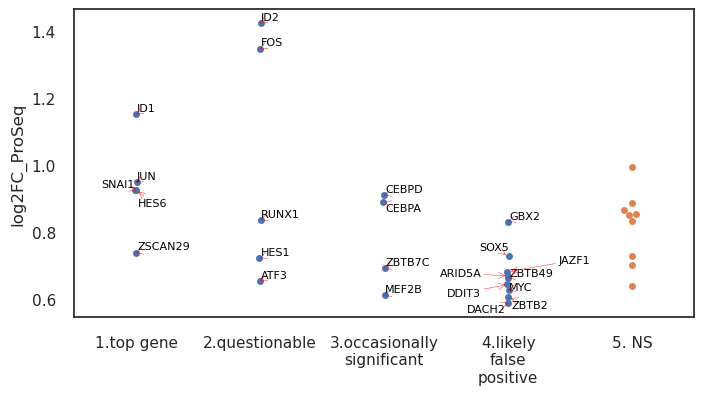

In [185]:
data = pd.DataFrame([genes_of_interest,log2FCs_ProSeq]).transpose()
data.columns=['gene_name','log2FC_ProSeq']
data = data.loc[data['gene_name'].isin(list(melted.loc[(melted['t']==melted['t'].max())]['gene_name'].unique()))].reset_index(drop=True)

def get_gene_category(x):
    top_genes = ['JUN','HES6','SNAI1','ZSCAN29','ID1']
    questionable = ['RUNX1','ID2','FOS','HES1','ATF3']
    occasionally_significant = ['ZBTB7C','CEBPA','MEF2B','CEBPD']
    likely_FP_genes = ['ARID5A','ZBTB49','DDIT3','GBX2','MYC','ZBTB2','JAZF1','DACH2','SOX5']

    if x['gene_name'] in top_genes:
        return '1.top gene'
    elif x['gene_name'] in questionable:
        return '2.questionable'
    elif x['gene_name'] in occasionally_significant:
        return '3.occasionally\nsignificant'
    elif x['gene_name'] in likely_FP_genes:
        return '4.likely\nfalse\npositive'
    else:
        return '5. NS'
data['gene_category'] = data.apply(lambda x:get_gene_category(x),1)

xfeature,yfeature = 'gene_category','log2FC_ProSeq'
order = list(data[xfeature].unique())
order.sort()

sns.set(font_scale=1)
sns.set_style("white")
fig, axes = plt.subplots(1, 1, sharey=False, sharex=False, figsize=(8,4))

ax = sns.stripplot(data = data.loc[data[xfeature]!='5. NS'],x=xfeature,y=yfeature,order = order,jitter=0.01)
ax = sns.swarmplot(data = data.loc[data[xfeature]=='5. NS'],x=xfeature,y=yfeature,order = order)

l=0
texts=[]
for xfeature_val in order[:-1]:
    data_to_annotate = data.loc[(data[xfeature]==xfeature_val)]
    if len(data_to_annotate)>0:
        for index,row in data_to_annotate.iterrows():
            texts.append(ax.text(l,row[yfeature],row['gene_name'],size=8,color='black',ha='left',va='center'))
    l=l+1
%time adjust_text(texts,arrowprops=dict(arrowstyle='->', color='red',lw=0.3),ax=ax,force_points=(0.1,0.1),force_text=(1,1))

ax.set(xlabel='')

os.system('mkdir -p '+subdirs['reports_dir']+'/5_quantification_of_TSSs/')
fig.savefig(subdirs['reports_dir']+'/5_quantification_of_TSSs/3.Comparison_with_ProSeq_log2FC_INTS11degron.png',bbox_inches='tight',dpi=300)

In [186]:
2.5/1.5, 1.3/0.5

(1.6666666666666667, 2.6)

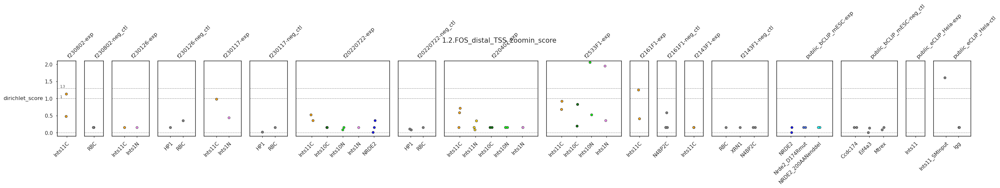

In [160]:
label = '1.2.FOS_distal_TSS_zoomin_score'

data = melted.loc[melted['TSS_label']=='distal'].copy()

features_to_plot = ['dirichlet_score']
feature_labels = [feature for feature in features_to_plot]
feature_plot_type = ['stripplot']*(len(features_to_plot))
hide_yticks = [False]*(len(features_to_plot))

ylims = [(-0.1,2.1)]*(len(features_to_plot))
horizontal_lines = [[1,1.3,0]]*(len(features_to_plot))
texts = [[{'y_pos':1,'text':'1','ha':'left','va':'bottom','size':7},
         {'y_pos':1.3,'text':'1.3','ha':'left','va':'bottom','size':7}]]*(len(features_to_plot))

marker_sizes = [5]*len(group_1_x_group_2)

plot_points(label,subdirs,data,features_to_plot,feature_labels,feature_plot_type,hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2,group_3_order,point_plots_width_ratios,alpha_param,rotation_degree,major_text_size,
            subplot_height=3.0,output_dir=subdirs['reports_dir']+'/5_quantification_of_TSSs/')

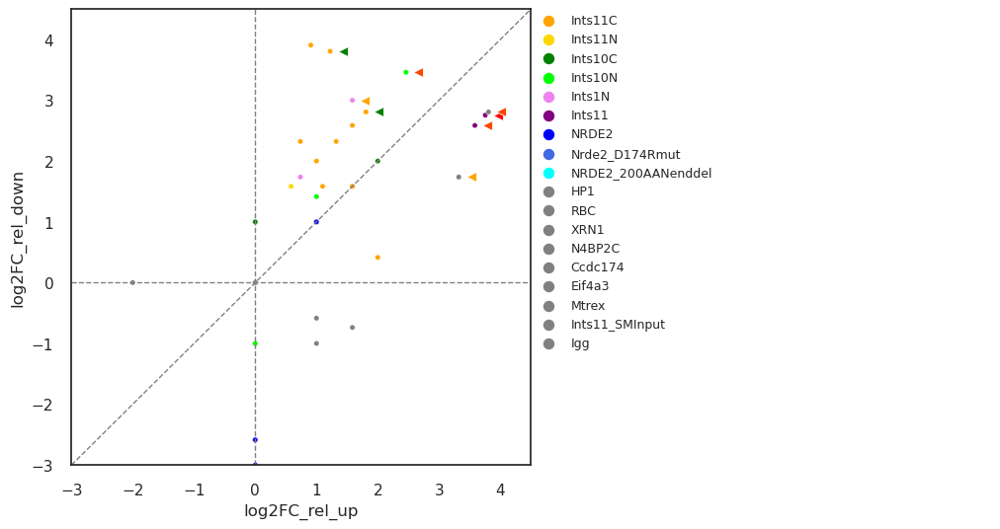

In [200]:
hue = 'group_3'
sign_feature = 'dirichlet_pval'
xfeature, yfeature = 'log2FC_rel_up','log2FC_rel_down'
lims = (-3,4.5)

data = melted.loc[melted['TSS_label']=='distal'].copy()
palette_df = pd.DataFrame(group_3_order,columns=[hue])
palette_df['order'] = palette_df.index
palette_df = pd.merge(palette_df,metadata[[hue,'color']].drop_duplicates(),how='left',on=hue)

sns.set(font_scale=1)
sns.set_style("white")
fig, axes = plt.subplots(1, 1, sharey=False, sharex=False, figsize=(6,6))

ax = sns.scatterplot(data = data,x=xfeature,y=yfeature,hue=hue,hue_order = list(palette_df[hue]),palette = list(palette_df['color']),s=15)
ax = sns.lineplot(data = pd.DataFrame([[lims[0],lims[0]],[lims[1],lims[1]]],columns=[xfeature,yfeature]), x=xfeature, y=yfeature,linestyle='--',color='grey',linewidth=1)
ax.vlines(x=0,ymin=lims[0],ymax=lims[1],color='grey',linestyles='--',linewidth=1)
ax.hlines(y=0,xmin=lims[0],xmax=lims[1],color='grey',linestyles='--',linewidth=1)
ax.set(xlim=lims,ylim=lims)

pval_borders = [0.001,0.01,0.05,0.1]
pval_colors = ['red','orangered','orange','green']
pval_prev = 2
k=0
for pval_border in pval_borders:
    if pval_prev>1:
        data_sign = data.loc[data[sign_feature]<pval_border].reset_index(drop=True)
    else:
        data_sign = data.loc[(data[sign_feature]>=pval_prev)&(data[sign_feature]<pval_border)].reset_index(drop=True)
    if len(data_sign)>0:
        data_sign[xfeature] = data_sign[xfeature]+0.2
        ax = sns.scatterplot(data = data_sign,x='log2FC_rel_up',y='log2FC_rel_down',color=pval_colors[k],s=50,alpha=1,marker='<')
        # add text labels
    pval_prev = pval_border
    k=k+1
    
ax.legend(bbox_to_anchor=(1, 0, 1, 1),loc='upper left',borderaxespad=0,title='',markerscale=1.2,ncols=1,fontsize=9,mode='expand')

In [98]:
data.loc[data['dirichlet_pval']<0.1]

,TSS,TSS_label,sample,signal,control_down,control_up,log2_signal,log2_control_down,log2_control_up,log2FC_rel_down,log2FC_rel_up,dirichlet_score,dirichlet_pval,organism,group_1,group_2,group_3,group_1_x_group_2,replicate,color
46,85520664,distal,11C_exp18,6,0,1,2.807355,0.000000,1.000000,2.807355,1.807355,1.129169,0.074273,mouse,f230802,exp,Ints11C,f230802-exp,11C_exp18,orange
82,85520664,distal,Ints11C_replicate4,13,0,5,3.807355,0.000000,2.584963,3.807355,1.222392,1.245789,0.056782,mouse,f2161F1,exp,Ints11C,f2161F1-exp,Ints11C_replicate4,orange
114,85520664,distal,Ints1N_replicate2,23,2,7,4.584963,1.584963,3.000000,3.000000,1.584963,1.935579,0.011599,mouse,f2533F1,exp,Ints1N,f2533F1-exp,Ints1N_replicate2,violet
118,85520664,distal,Ints10N_replicate1,10,0,1,3.459432,0.000000,1.000000,3.459432,2.459432,2.062984,0.008650,mouse,f2533F1,exp,Ints10N,f2533F1-exp,Ints10N_replicate1,lime
140,75278826,distal,SRR11551259,11,1,0,3.584963,1.000000,0.000000,2.584963,3.584963,2.473273,0.003363,human,public_eCLIP_Hela,exp,Ints11,public_eCLIP_Hela-exp,Ints11_259,purple
142,75278826,distal,SRR11551262,9,2,0,3.321928,1.584963,0.000000,1.736966,3.321928,1.605023,0.024830,human,public_eCLIP_Hela,ctl,Ints11_SMInput,public_eCLIP_Hela-ctl,Ints11_SMInput_262,grey
146,75278826,distal,SRR11551260,26,3,1,4.754888,2.000000,1.000000,2.754888,3.754888,5.000000,0.000010,human,public_eCLIP_Hela,exp,Ints11,public_eCLIP_Hela-exp,Ints11_260,purple
148,75278826,distal,SRR11551261,13,1,0,3.807355,1.000000,0.000000,2.807355,3.807355,2.982967,0.001040,human,public_eCLIP_Hela,ctl,Ints11_SMInput,public_eCLIP_Hela-ctl,Ints11_SMInput_261,grey


In [ ]:
data_log2FC['log2_signal'] = np.log2(data_log2FC['signal']+pseudocount)
data_log2FC['log2_control_down'] = np.log2(data_log2FC['control_down']+pseudocount)
data_log2FC['log2_control_up'] = np.log2(data_log2FC['control_up']+pseudocount)
data_log2FC['log2FC_rel_down'] = data_log2FC['log2_signal']-data_log2FC['log2_control_down']
data_log2FC['log2FC_rel_up'] = data_log2FC['log2_signal']-data_log2FC['log2_control_up']

In [43]:
sample_metadata_dict[organism]

,sample,organism,group_1,group_2,group_3,group_1_x_group_2,replicate,color
0,SRR11551259,human,public_eCLIP_Hela,exp,Ints11,public_eCLIP_Hela-exp,Ints11_259,purple
1,SRR11551262,human,public_eCLIP_Hela,ctl,Ints11_SMInput,public_eCLIP_Hela-ctl,Ints11_SMInput_262,grey
2,SRR11551263,human,public_eCLIP_Hela,ctl,Igg,public_eCLIP_Hela-ctl,Igg_263,grey
3,SRR11551260,human,public_eCLIP_Hela,exp,Ints11,public_eCLIP_Hela-exp,Ints11_260,purple
4,SRR11551261,human,public_eCLIP_Hela,ctl,Ints11_SMInput,public_eCLIP_Hela-ctl,Ints11_SMInput_261,grey
5,SRR11551264,human,public_eCLIP_Hela,ctl,Igg,public_eCLIP_Hela-ctl,Igg_264,grey


In [39]:
sel.loc[sel['region']==region]

,segment_name,N4BP2C_replicate1,INTS11N_replicate4_exp3,INTS10N_replicate3_exp1,RBC_replicate2_exp10,SRR15070632,Ints10C_replicate1,N4BP2C_replicate4,INTS1N_replicate4_exp4,INTS11C_replicate10_exp5,...,SRR15070642,HP1_exp15,RBC_exp15,Ints11C_replicate6,N4BP2C_replicate2,INTS10N_replicate4_exp4,region,TSS,gene_name,TSS_label
0,control_up;85520664;630190;Fos,0,0,0,0,0,1,0,0,0,...,0,3,0,6,0,0,control_up,85520664,Fos,distal
3,control_up;85521465;630190;Fos,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,control_up,85521465,Fos,proximal


0      distal
1      distal
2      distal
3    proximal
4    proximal
5    proximal
Name: TSS, dtype: object

In [61]:
big_expression_matrix['median'] = big_expression_matrix[list_of_samples].median(1)

In [70]:
# Try LDA
import gensim
import scipy

LdaModel = gensim.models.ldamodel.LdaModel

data = big_expression_matrix.loc[big_expression_matrix['median']>1].reset_index(drop=True)
corpus = data[list_of_samples].values
corpus = scipy.sparse.csr_matrix(corpus)
corpus = gensim.matutils.Sparse2Corpus(corpus)
lda = LdaModel(corpus=corpus, num_topics=10)

In [73]:
data.loc[473]

segment_name               control_down;86280028;1494;Ncl
N4BP2C_replicate1                                      10
INTS11N_replicate4_exp3                                 4
INTS10N_replicate3_exp1                                44
RBC_replicate2_exp10                                   11
                                        ...              
INTS10N_replicate4_exp4                                19
region                                       control_down
TSS                                              86280028
gene_name                                             Ncl
median                                               44.0
Name: 473, Length: 75, dtype: object

In [89]:
lda.get_document_topics(corpus)[0]

[(0, 0.010253483),
 (2, 0.013555835),
 (4, 0.3861722),
 (5, 0.024011796),
 (6, 0.017296098),
 (7, 0.025349427),
 (8, 0.5120322)]

In [26]:
corpus

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [1, 0, 1, ..., 0, 0, 5],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [ ]:
(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=20, 
                                           random_state=100,
                                           update_every=1,
                                           chunksize=100,
                                           passes=10,
                                           alpha='auto',
                                           per_word_topics=True)

In [ ]:
# Calculate scores based on Dirichlet distribution

# signal, control down, control up
obs_conc = [6, 3, 3]
# obs_conc = np.log2(obs_conc)
alpha = np.array(obs_conc)  # specify concentration parameters
size = 1000000
a = dirichlet.rvs(alpha,size=size)
a = pd.DataFrame(a)
pval = len(a.loc[~((a[0]>a[1]+a[2])|((a[0]>=a[1])&(a[1]>=a[2])))])/size
score = np.log10(pval)*(-1)

[Text(0.5, 16.388888888888886, 'median gene expression level, $log_2$ normalized count'),
 Text(14.513888888888888, 0.5, 'IQR')]

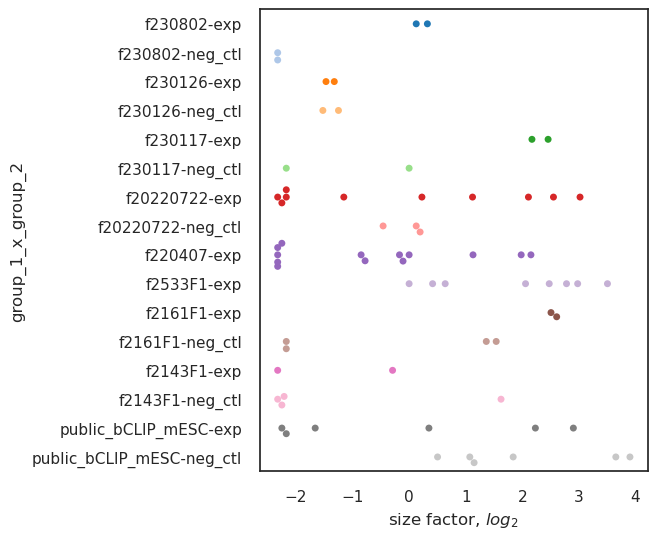

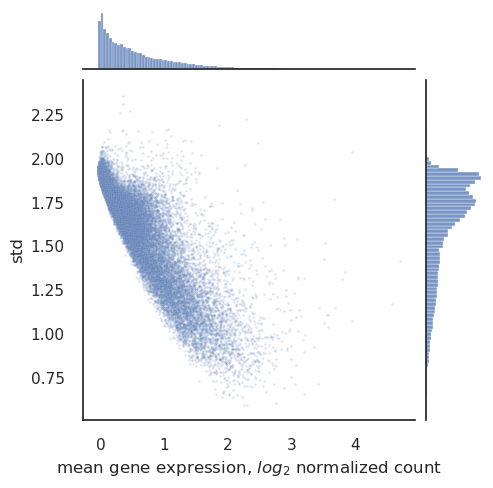

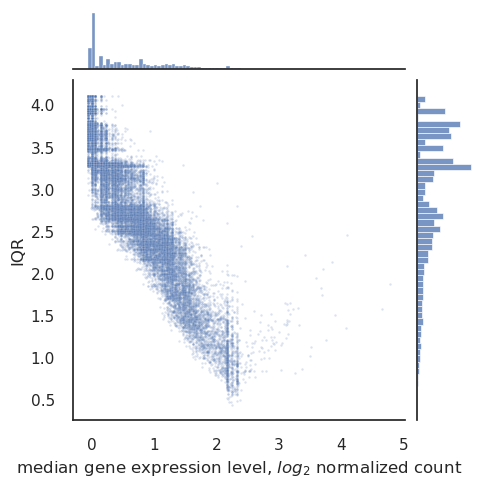

In [70]:
pseudocount = 1
label = col_name

x = big_expression_matrix.loc[big_expression_matrix['region']=='signal'].reset_index(drop=True)
list_of_samples = list(cur_sample_metadata['sample'])

group_1_x_group_2_filtered = [elem for elem in group_1_x_group_2 if elem in (cur_sample_metadata[['group_1','group_2']].drop_duplicates().values).tolist()]

# normalize

# add pseudocount to exclude zeros
x[list_of_samples] = x[list_of_samples]+pseudocount

# estimate size factors in a two-step procedure
# first, take subset of genes with at least <first_step_thr> reads across (almost) all samples
# then do median-median normalization and select genes with the smallest fluctuations
# then use only those to do second step - calculate size factors using this small set of genes
    
x['median'] = x[list_of_samples].quantile(axis=1,q=0.5) # take median for each segment across samples
first_step_thr = x['median'].quantile(0.995) # take the highest-expressing genes for normalization

if len(x.loc[x['median']>first_step_thr])<30:
    print(label+' cannot estimate size factors, too many genes with near-zero counts across the dataset')
else:
    x_sel = x.loc[x['median']>first_step_thr].reset_index(drop=True)

x_sel_stand = pd.concat([x_sel[['segment_name']],
                         (x_sel[list_of_samples]).div(x_sel['median'], axis=0)],axis=1).reset_index(drop=True) # divide each row value over its median and save in a different dataframe
    
size_factors = np.median(x_sel_stand[list_of_samples],axis=0) # get medians over columns

x_sel = pd.concat([x_sel[['segment_name']],
                       (x_sel[list_of_samples]).div(size_factors, axis=1)],axis=1).reset_index(drop=True) # divide each column value of raw counts over its size factor

x_sel['iqr'] = x_sel[list_of_samples].quantile(axis=1,q=0.75)-x_sel[list_of_samples].quantile(axis=1,q=0.25)
x_sel['median'] = x_sel[list_of_samples].median(1)
x_sel['iqr_over_median'] = x_sel['iqr']/x_sel['median']
LQ,UQ = x_sel['median'].quantile(0.05),x_sel['median'].quantile(0.95)
    
if UQ==LQ:
    print(label+' cannot estimate size factors, can not get stable seqments')
stable_segments = x_sel.loc[(x_sel['median']>LQ)&(x_sel['median']<UQ)].sort_values('iqr_over_median').head(100)[['segment_name']].reset_index(drop=True)

# end of first step

# # now do second step - take only raw counts of stable segments and get the size factors using those
x_sel = pd.merge(stable_segments,x,how='inner',on=['segment_name'])
x_sel['median'] = x_sel[list_of_samples].median(1)
x_sel_stand = pd.concat([x_sel[['segment_name']],(x_sel[list_of_samples]).div(x_sel['median'], axis=0)],axis=1).reset_index(drop=True)
size_factors = np.median(x_sel_stand[list_of_samples],axis=0)

# size factor plot
sns.set(font_scale=1)
sns.set_style("white")
fig, axes = plt.subplots(1, 1, sharey=False, sharex=False, figsize=(5,6))

tmp = pd.DataFrame(list_of_samples,columns=['sample'])
tmp = pd.merge(tmp,metadata,how='left',on='sample')

group_1_x_group_2_vals = ['-'.join(elem) for elem in group_1_x_group_2_filtered]
palette = sns.color_palette('tab20',len(group_1_x_group_2_vals))

tmp['sf_log2'] = list(np.log2(size_factors))

ax = sns.swarmplot(data=tmp,x='sf_log2',y='group_1_x_group_2',order=group_1_x_group_2_vals,palette=palette)
ax.set(xlabel=r'size factor, $log_2$')

# remove too lowly expressed segments
x['max'] = x[list_of_samples].quantile(axis=1,q=0.95)
x_sel = x.loc[x['max']>pseudocount].reset_index(drop=True)

# final normalization for library size
x_sel = pd.concat([x_sel[['segment_name']],(x_sel[list_of_samples]).div(size_factors, axis=1)],axis=1).reset_index(drop=True)
x_sel[list_of_samples] = np.log2(x_sel[list_of_samples]) # taking the log

x_sel['mean'] = x_sel[list_of_samples].mean(1)
x_sel['std'] = x_sel[list_of_samples].std(1)

# diagnostic plot mean expression vs std
g = sns.jointplot(data = x_sel,x='mean',y='std',alpha=0.2,s=3,height=5)
ax = g.ax_joint
ax.set(xlabel='mean gene expression, $log_2$ normalized count',ylabel='std')

x_sel['median'] = x_sel[list_of_samples].median(1)
x_sel['iqr'] = x_sel[list_of_samples].quantile(axis=1,q=0.75)-x_sel[list_of_samples].quantile(axis=1,q=0.25)

# diagnostic plot median expression vs iqr
g = sns.jointplot(data = x_sel,x='median',y='iqr',alpha=0.2,s=3,height=5)
ax = g.ax_joint
ax.set(xlabel='median gene expression level, $log_2$ normalized count',ylabel='IQR')


In [100]:
starndardized_matrix_df.head()

,N4BP2C_replicate1,INTS11N_replicate4_exp3,INTS10N_replicate3_exp1,RBC_replicate2_exp10,SRR15070632,Ints10C_replicate1,N4BP2C_replicate4,INTS1N_replicate4_exp4,INTS11C_replicate10_exp5,INTS10C_replicate6_exp6,...,SRR15070635,RBC_replicate1,11C_exp16,SRR15070637,SRR15070642,HP1_exp15,RBC_exp15,Ints11C_replicate6,N4BP2C_replicate2,INTS10N_replicate4_exp4
0,2.985038,0.338839,1.088465,-1.191958,0.156702,0.423182,0.156702,0.467585,0.382818,1.834160,...,-2.862612,1.537082,0.338839,1.118020,-0.722799,-0.544225,0.156702,-0.160514,0.250168,-1.427290
1,0.066944,0.136613,0.613804,-0.033700,0.043334,0.114198,0.043334,-0.608673,2.346722,0.704867,...,-1.502971,0.136613,0.495584,-0.718913,-1.490540,-0.060943,0.043334,0.494541,0.091201,0.657000
2,0.309653,-0.576901,-2.121365,0.467590,0.271175,1.178150,1.730742,-0.469445,-0.955271,0.671143,...,-2.248843,0.423192,0.423192,-0.511587,0.659209,0.188705,1.078605,0.507524,0.934202,-2.050969
3,0.165398,1.424558,-1.452518,0.231421,0.783358,1.383255,1.252675,-2.210325,-1.926289,0.210096,...,1.795695,0.293774,0.955240,-1.090530,1.314938,0.293774,1.252675,-0.044760,0.210096,-0.242139
4,0.126425,-0.353928,-0.312517,0.114196,-0.508808,-0.282207,0.510114,-2.014280,-0.912562,0.589592,...,1.088534,0.664993,-1.372850,0.067121,2.258342,0.031745,1.106145,0.543261,1.185623,-1.855748


<AxesSubplot: xlabel='6', ylabel='Count'>

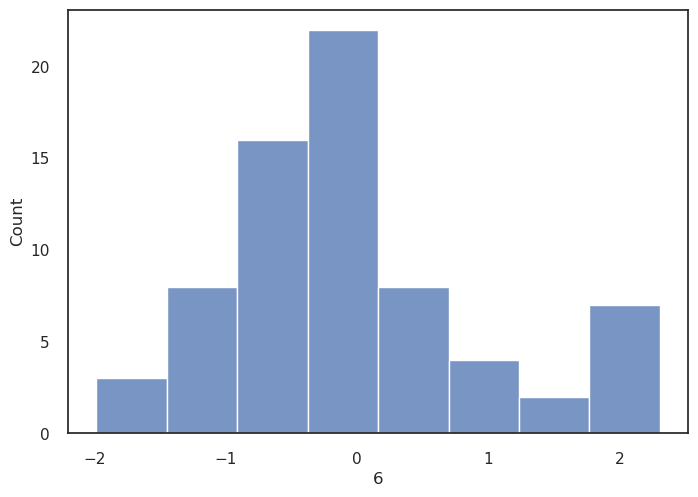

In [99]:
sns.histplot(starndardized_matrix_df.iloc[6])

TypeError: 'AxesSubplot' object is not subscriptable

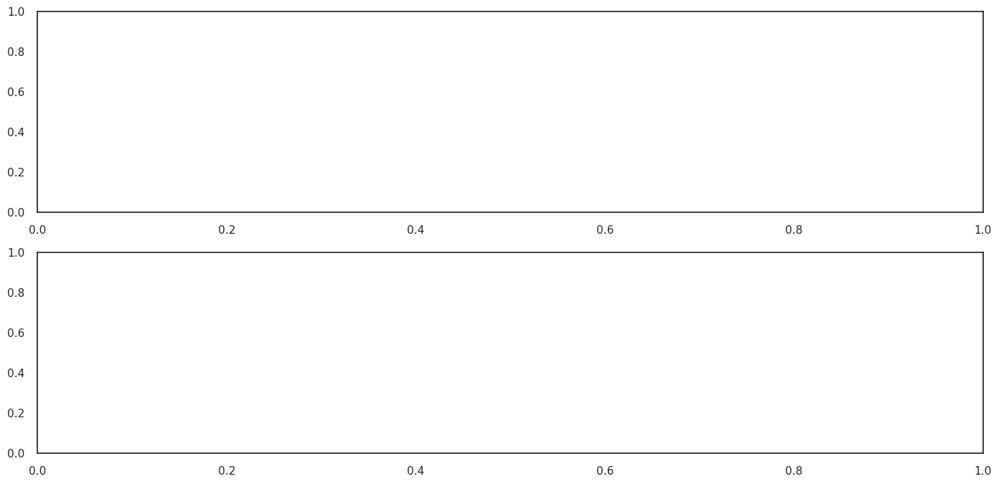

In [80]:
cur_list_of_samples = list_of_samples.copy()

expr_thr_for_dim_reduc = 2

x_sel_vals = (x_sel.loc[x_sel['mean']>expr_thr_for_dim_reduc][cur_list_of_samples].values).transpose()
x_sel_vals = StandardScaler().fit_transform(x_sel_vals)
starndardized_matrix_df = pd.DataFrame(x_sel_vals).transpose()
starndardized_matrix_df.columns = cur_list_of_samples

pca = PCA(n_components=2)
principalComponents = pca.fit_transform(x_sel_vals)
principalDf = pd.DataFrame(data = principalComponents, columns = ['PC1', 'PC2'])
principalDf['sample'] = cur_list_of_samples

Reduced_representation_df = principalDf
Reduced_representation_df = pd.merge(metadata,Reduced_representation_df,how='inner',on='sample')

Reduced_representation_df['group_1_x_group_2'] = Reduced_representation_df['group_1']+'-'+Reduced_representation_df['group_2']
group_1_x_group_2_vals = ['-'.join(elem) for elem in group_1_x_group_2_filtered]

data = Reduced_representation_df.copy()

xy_combs = [['PC1','PC2']]
hues = ['group_1_x_group_2','group_3']

# set lims
lims = []
for xy_comb in xy_combs:
    iqr_x = data[xy_comb[0]].quantile(q=0.75)-data[xy_comb[0]].quantile(q=0.25)
    iqr_y = data[xy_comb[1]].quantile(q=0.75)-data[xy_comb[1]].quantile(q=0.25)
    lims.append([(data[xy_comb[0]].min()-iqr_x*0.5,data[xy_comb[0]].max()+iqr_x*0.5),(data[xy_comb[1]].min()-iqr_y*0.5,data[xy_comb[1]].max()+iqr_y*0.5)])

sns.set(font_scale=1)
sns.set_style("white")
fig, axes = plt.subplots(len(hues), len(xy_combs), sharey=False, sharex=False, figsize=(17,8))

i=0
for hue in hues:
    if hue=='group_1_x_group_2':
        hue_order_cur = group_1_x_group_2_vals
        palette = sns.color_palette('tab20',len(group_1_x_group_2_vals))
    else:
        present_treatments = list(data['group_3'].unique())
        group_3_order_cur = [treatment for treatment in group_3_order if treatment in present_treatments] 
        palette = [metadata.loc[metadata['group_3']==treatment]['color'].iloc[0] for treatment in group_3_order_cur]
        hue_order_cur = group_3_order_cur
    j=0
    for xy_comb in xy_combs:

        texts = []
        if hue=='group_3':
            for group_1_x_group_2_val in group_1_x_group_2_vals:
                k=0
                for hue_var in hue_order_cur:
                    data_cur = data.loc[(data['group_1_x_group_2']==group_1_x_group_2_val)&(data[hue]==hue_var)]
                    if len(data_cur)>1:
                        ax = sns.kdeplot(ax=axes[i][j],data = data_cur,x=xy_comb[0],y=xy_comb[1],color=palette[k],fill=True,
                        levels=[0.01,1], alpha=0.1,bw_adjust=3, cut=0)
                        positioner = data_cur.sort_values([xy_comb[0],xy_comb[1]],ascending=False).iloc[0]
                        texts.append(ax.text(positioner[xy_comb[0]],positioner[xy_comb[1]],"\n".join(textwrap.wrap(positioner['group_3'],width=10)),
                                             ha='center',va='center',size=4))
                        
                    else:
                        for index,row in data_cur.iterrows():
                            texts.append(ax.text(row[xy_comb[0]],row[xy_comb[1]],"\n".join(textwrap.wrap(row['group_3'],width=10)),
                                             ha='center',va='center',size=4))
                    k=k+1
        else:
            k=0
            for hue_var in hue_order_cur:
                data_cur = data.loc[(data[hue]==hue_var)]
                if len(data_cur)>1:
                    ax = sns.kdeplot(ax=axes[i][j],data = data_cur,x=xy_comb[0],y=xy_comb[1],color=palette[k],fill=True,
                    levels=[0.01,1], alpha=0.1, bw_adjust=3, cut=0)
                else:
                    for index,row in data_cur.iterrows():
                        texts.append(ax.text(row[xy_comb[0]],row[xy_comb[1]],"\n".join(textwrap.wrap(row['group_1_x_group_2'].replace('_',' '),width=10)),
                                         ha='center',va='center',size=4))                    
                k=k+1

        ax = sns.scatterplot(ax=axes[i][j],data = data,x=xy_comb[0],y=xy_comb[1],hue=hue,hue_order=hue_order_cur,palette=palette,
                            s=9,alpha=1
                            )

        # add percentages of explained variance
        if xy_comb[0].startswith('PC'):
            ind_x = int(xy_comb[0].replace('PC',''))-1
            ind_y = int(xy_comb[1].replace('PC',''))-1
            ax.set(xlabel = xy_comb[0]+', '+str(int(np.round(pca.explained_variance_ratio_[ind_x]*100,0)))+'%')
            ax.set(ylabel = xy_comb[1]+', '+str(int(np.round(pca.explained_variance_ratio_[ind_y]*100,0)))+'%')

        ax.set(xlim = lims[j][0],ylim = lims[j][1])

        # add text labels
        %time adjust_text(texts,arrowprops=dict(arrowstyle='->', color='red',lw=0.1),ax=ax,x=list(data[xy_comb[0]]),y=list(data[xy_comb[1]]),force_points=(0.9,0.9))

        if j==(len(xy_combs)-1):
            ax.legend(bbox_to_anchor=(1, 0, 1, 1),loc='upper left',borderaxespad=0,title=hue,markerscale=1.2,ncols=1,fontsize=9,mode='expand')
        else:
            ax.legend_.remove()
        j=j+1
    i=i+1
fig.suptitle(label, x=0.5,y=1,size=major_text_size,ha='center',va='bottom')
fig.tight_layout(pad=0.5)

fig.savefig(subdirs['reports_dir']+'/4_metaplots/PCA_UMAP_high_expr.png',bbox_inches='tight',dpi=300)

,sample,organism,chromosomes
0,SRR15070630,mouse,chr1 chr2 chr3 chr4 chr5 chr6 chr7 chr8 chr9 c...
1,SRR15070631,mouse,chr1 chr2 chr3 chr4 chr5 chr6 chr7 chr8 chr9 c...
2,NRDE2_replicate1_exp7,mouse,chr1 chr2 chr3 chr4 chr5 chr6 chr7 chr8 chr9 c...
3,NRDE2_replicate2_exp8,mouse,chr1 chr2 chr3 chr4 chr5 chr6 chr7 chr8 chr9 c...
4,NRDE2_replicate3_exp10,mouse,chr1 chr2 chr3 chr4 chr5 chr6 chr7 chr8 chr9 c...
...,...,...,...
71,HP1_replicate1_exp7,mouse,chr1 chr2 chr3 chr4 chr5 chr6 chr7 chr8 chr9 c...
72,HP1_replicate2_exp8,mouse,chr1 chr2 chr3 chr4 chr5 chr6 chr7 chr8 chr9 c...
73,INTS11N_replicate3_exp1,mouse,chr1 chr2 chr3 chr4 chr5 chr6 chr7 chr8 chr9 c...
74,INTS11N_replicate4_exp3,mouse,chr1 chr2 chr3 chr4 chr5 chr6 chr7 chr8 chr9 c...


In [73]:

wd_counts_file_paths

,path,sample,chr
0,/scicore/home/zavolan/GROUP/StefanieCLIP/aleks...,N4BP2C_replicate1,chr16
1,/scicore/home/zavolan/GROUP/StefanieCLIP/aleks...,N4BP2C_replicate1,chr6
2,/scicore/home/zavolan/GROUP/StefanieCLIP/aleks...,N4BP2C_replicate1,chr18
3,/scicore/home/zavolan/GROUP/StefanieCLIP/aleks...,N4BP2C_replicate1,chr12
4,/scicore/home/zavolan/GROUP/StefanieCLIP/aleks...,N4BP2C_replicate1,chr15
...,...,...,...
1685,/scicore/home/zavolan/GROUP/StefanieCLIP/aleks...,INTS10N_replicate4_exp4,chr1
1686,/scicore/home/zavolan/GROUP/StefanieCLIP/aleks...,INTS10N_replicate4_exp4,chr7
1687,/scicore/home/zavolan/GROUP/StefanieCLIP/aleks...,INTS10N_replicate4_exp4,chr11
1688,/scicore/home/zavolan/GROUP/StefanieCLIP/aleks...,INTS10N_replicate4_exp4,chr6


In [ ]:




ylims = (ax2.get_ylim()[0],ax2.get_ylim()[1])
for window_border in window_borders:
    ax2.vlines(x=window_border,ymin=ylims[0],ymax=ylims[1],color='grey',linestyles='--',linewidth=1)
ax2.text(np.mean(window_borders[0:2]),ylims[1],'control\nup',color='grey',size=8,ha='center',va='top')
ax2.text(np.mean(window_borders[1:3]),ylims[1],'signal',color='grey',size=8,ha='center',va='top')
ax2.text(np.mean(window_borders[2:]),ylims[1],'control\ndown',color='grey',size=8,ha='center',va='top')

ax2.legend(bbox_to_anchor=(1, 0, 1, 1),loc='upper left',borderaxespad=0,title='total gene counts, $log_2$',markerscale=1.2,ncols=1,fontsize=9)

fig.tight_layout(pad=0.5)

# out = subprocess.check_output('mkdir -p '+subdirs['reports_dir']+'/4_metaplots/1_dependence_on_total_gene_expression/', shell=True)
# fig.savefig(subdirs['reports_dir']+'/4_metaplots/1_dependence_on_total_gene_expression/'+read_fraction+'.'+sample+'.1.'+count_col+'.metaplot_total_counts.pdf',bbox_inches='tight',dpi=300)

ax1.set(xlim=xlims)
ax2.set(xlim=xlims)

# out = subprocess.check_output('mkdir -p '+subdirs['reports_dir']+'/4_metaplots/1_dependence_on_total_gene_expression/', shell=True)
# fig.savefig(subdirs['reports_dir']+'/4_metaplots/1_dependence_on_total_gene_expression/'+read_fraction+'.'+sample+'.2.'+count_col+'.metaplot_total_counts.zoomin.pdf',bbox_inches='tight',dpi=300)

## MA-plot-like

bw_adjust = 1.75
kde_plot_sample = 2000

sns.set(font_scale=1)
sns.set_style("white")
fig, axes = plt.subplots(1, 3, sharey=False, sharex=False, figsize=(11,4),gridspec_kw={'width_ratios': [1,1,1]})

x_feature,y_feature = 'log2_control_down','log2_signal'
lims = (-1,6)

ax = sns.kdeplot(ax=axes[0],data = data_log2FC.sample(kde_plot_sample),x=x_feature,y=y_feature,fill=False, cut=0, levels=[0.25],bw_adjust=bw_adjust,color='purple')
ax = sns.kdeplot(ax=axes[0],data = data_log2FC.sample(kde_plot_sample),x=x_feature,y=y_feature,fill=False, cut=0, levels=[0.5],bw_adjust=bw_adjust,color='orange')
ax = sns.kdeplot(ax=axes[0],data = data_log2FC.sample(kde_plot_sample),x=x_feature,y=y_feature,fill=False, cut=0, levels=[0.75],bw_adjust=bw_adjust,color='green')

ax = sns.scatterplot(ax=axes[0],data = data_log2FC,x=x_feature,y=y_feature,s=5,alpha=0.1)
ax = sns.lineplot(ax=axes[0],data = pd.DataFrame([[lims[0],lims[0]],[lims[1],lims[1]]],columns=[x_feature,y_feature]),x=x_feature,y=y_feature,color='black',linestyle='--')

data_log2FC_of_interest = data_log2FC.loc[data_log2FC['gene_name'].isin(genes_of_interest)]
ax = sns.scatterplot(ax=axes[0],data = data_log2FC_of_interest,x=x_feature,y=y_feature,s=10,alpha=1,color='red')
for index,row in data_log2FC_of_interest.iterrows():
    ax.text(row[x_feature]-0.1,row[y_feature],row['gene_name'],color='red',size=9,ha='right',va='center')

ax.set(xlabel='$control_{down}$+1, $log_2$',ylabel='signal+1, $log_2$',xlim=lims,ylim=lims)

x_feature,y_feature = 'log2_control_up','log2_signal'
lims = (-1,6)

ax = sns.kdeplot(ax=axes[1],data = data_log2FC.sample(kde_plot_sample),x=x_feature,y=y_feature,fill=False, cut=0, levels=[0.25],bw_adjust=bw_adjust,color='purple')
ax = sns.kdeplot(ax=axes[1],data = data_log2FC.sample(kde_plot_sample),x=x_feature,y=y_feature,fill=False, cut=0, levels=[0.5],bw_adjust=bw_adjust,color='orange')
ax = sns.kdeplot(ax=axes[1],data = data_log2FC.sample(kde_plot_sample),x=x_feature,y=y_feature,fill=False, cut=0, levels=[0.75],bw_adjust=bw_adjust,color='green')

ax = sns.scatterplot(ax=axes[1],data = data_log2FC,x=x_feature,y=y_feature,s=5,alpha=0.1)
ax = sns.lineplot(ax=axes[1],data = pd.DataFrame([[lims[0],lims[0]],[lims[1],lims[1]]],columns=[x_feature,y_feature]),x=x_feature,y=y_feature,color='black',linestyle='--')

data_log2FC_of_interest = data_log2FC.loc[data_log2FC['gene_name'].isin(genes_of_interest)]
ax = sns.scatterplot(ax=axes[1],data = data_log2FC_of_interest,x=x_feature,y=y_feature,s=10,alpha=1,color='red')
for index,row in data_log2FC_of_interest.iterrows():
    ax.text(row[x_feature]-0.1,row[y_feature],row['gene_name'],color='red',size=9,ha='right',va='center')

ax.set(xlabel='$control_{up}$+1, $log_2$',ylabel='signal+1, $log_2$',xlim=lims,ylim=lims)

x_feature,y_feature = 'log2FC_rel_up','log2FC_rel_down'
lims = (-4,6)

ax = sns.kdeplot(ax=axes[2],data = data_log2FC.sample(kde_plot_sample),x=x_feature,y=y_feature,fill=False, cut=0, levels=[0.25],bw_adjust=bw_adjust,color='purple')
ax = sns.kdeplot(ax=axes[2],data = data_log2FC.sample(kde_plot_sample),x=x_feature,y=y_feature,fill=False, cut=0, levels=[0.5],bw_adjust=bw_adjust,color='orange')
ax = sns.kdeplot(ax=axes[2],data = data_log2FC.sample(kde_plot_sample),x=x_feature,y=y_feature,fill=False, cut=0, levels=[0.75],bw_adjust=bw_adjust,color='green')

ax = sns.scatterplot(ax=axes[2],data = data_log2FC,x=x_feature,y=y_feature,s=5,alpha=0.1)
ax.hlines(y=0,xmin=ax.get_xlim()[0],xmax=ax.get_xlim()[1],color='grey',linestyles='--',linewidth=1)
data_log2FC_of_interest = data_log2FC.loc[data_log2FC['gene_name'].isin(genes_of_interest)]
ax = sns.scatterplot(ax=axes[2],data = data_log2FC_of_interest,x=x_feature,y=y_feature,s=10,alpha=1,color='red')
for index,row in data_log2FC_of_interest.iterrows():
    ax.text(row[x_feature]-0.1,row[y_feature],row['gene_name'],color='red',size=9,ha='right',va='bottom')

ax.hlines(y=0,xmin=ax.get_xlim()[0],xmax=ax.get_xlim()[1],color='grey',linestyles='--',linewidth=1)
ax.vlines(x=0,ymin=ax.get_ylim()[0],ymax=ax.get_ylim()[1],color='grey',linestyles='--',linewidth=1)
ax.set(xlim=lims,ylim=lims)

fig.suptitle(count_col, x=0.5,y=1,size=11,ha='center',va='bottom')

fig.tight_layout(pad=0.5)

# out = subprocess.check_output('mkdir -p '+subdirs['reports_dir']+'/4_metaplots/1_dependence_on_total_gene_expression/', shell=True)
# fig.savefig(subdirs['reports_dir']+'/4_metaplots/1_dependence_on_total_gene_expression/'+read_fraction+'.'+sample+'.3.'+count_col+'.MA_plot_like.png',bbox_inches='tight',dpi=600)

In [7]:
%%time

# get one sample to define the windows of interest

sample = '11C_exp17'

chr_dict = {}

for chr in list(genes['chr'].unique()):
    input_file_path = '/scicore/home/zavolan/GROUP/StefanieCLIP/aleksei/output/samples/'+sample+'/segment_counts_long/binned_genome/'+sample+'.'+chr+'.wd_counts.tsv'
    bin_counts = pd.read_csv(input_file_path,delimiter="\t",index_col=None,header=0,usecols=[0,1,2,3,4], dtype={"chr": "category","strand":"category","segment_name":"category"})
    bin_counts['index'] = bin_counts.index
    bin_counts['gene_id'] = bin_counts['segment_name'].astype('str').str.split(';',expand=True)[1]
    
    bin_counts = bin_counts.loc[~bin_counts['gene_id'].str.contains(',')].reset_index(drop=True)
    bin_counts['gene_id'] = bin_counts['gene_id'].astype('int')
    bin_counts = pd.merge(bin_counts,genes[['gene_id','TSS','len']],how='inner',on='gene_id')
    
    bin_counts['pos_rel_to_TSS'] = ((bin_counts['end']+bin_counts['start'])*0.5-bin_counts['TSS']).astype('int')*((bin_counts['strand']=='+').astype('int')*2-1)
    bin_counts['pos_rel_to_TSS'] = (np.round((bin_counts['pos_rel_to_TSS']/10),0)*10).astype('int')
    
    bin_counts = bin_counts.loc[(abs(bin_counts['pos_rel_to_TSS'])<=window_limit)&(bin_counts['len']>window_limit)].reset_index(drop=True)

    # save if we need to further import other files
    rows_to_select = list(bin_counts['index']) 
    gene_id_col = list(bin_counts['gene_id'])
    gene_len_col = list(bin_counts['len'])
    pos_rel_to_TSS_col = list(bin_counts['pos_rel_to_TSS'])
    chr_dict[chr] = [rows_to_select,gene_id_col,gene_len_col,pos_rel_to_TSS_col]
    
    print(chr+' done')

chr1 done
chr10 done
chr11 done
chr12 done
chr13 done
chr14 done
chr15 done
chr16 done
chr17 done
chr18 done
chr19 done
chr2 done
chr3 done
chr4 done
chr5 done
chr6 done
chr7 done
chr8 done
chr9 done
chrM done
chrX done
chrY done
CPU times: user 6min 42s, sys: 1min 13s, total: 7min 55s
Wall time: 7min 47s


chr1 done
chr10 done
chr11 done
chr12 done
chr13 done
chr14 done
chr15 done
chr16 done
chr17 done
chr18 done
chr19 done
chr2 done
chr3 done
chr4 done
chr5 done
chr6 done
chr7 done
chr8 done
chr9 done
chrM done
chrX done
chrY done
chr1 done
chr10 done
chr11 done
chr12 done
chr13 done
chr14 done
chr15 done
chr16 done
chr17 done
chr18 done
chr19 done
chr2 done
chr3 done
chr4 done
chr5 done
chr6 done
chr7 done
chr8 done
chr9 done
chrM done
chrX done
chrY done
chr1 done
chr10 done
chr11 done
chr12 done
chr13 done
chr14 done
chr15 done
chr16 done
chr17 done
chr18 done
chr19 done
chr2 done
chr3 done
chr4 done
chr5 done
chr6 done
chr7 done
chr8 done
chr9 done
chrM done
chrX done
chrY done
chr1 done
chr10 done
chr11 done
chr12 done
chr13 done
chr14 done
chr15 done
chr16 done
chr17 done
chr18 done
chr19 done
chr2 done
chr3 done
chr4 done
chr5 done
chr6 done
chr7 done
chr8 done
chr9 done
chrM done
chrX done
chrY done
chr1 done
chr10 done
chr11 done
chr12 done
chr13 done
chr14 done
chr15 done
chr1

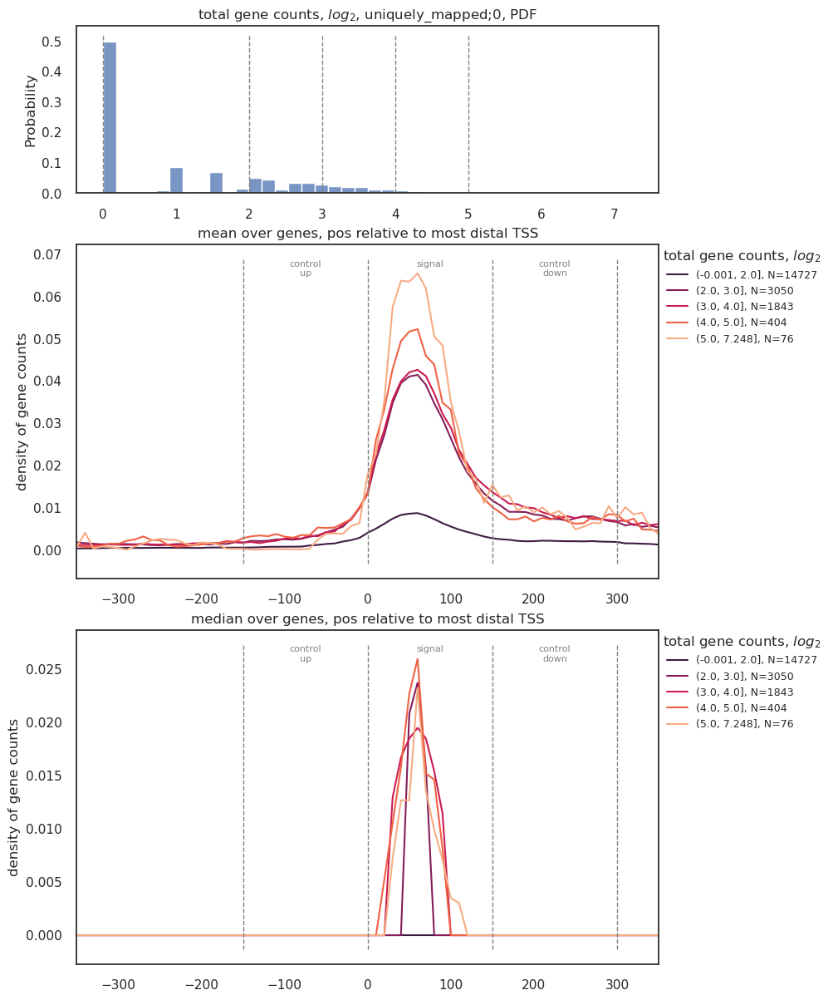

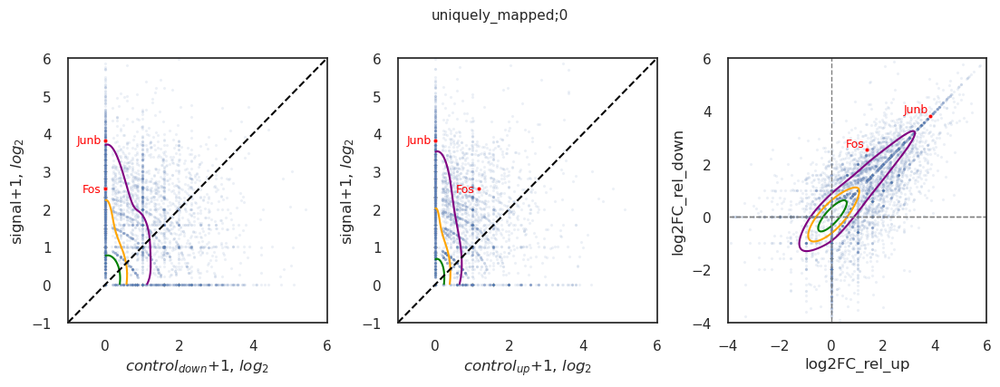

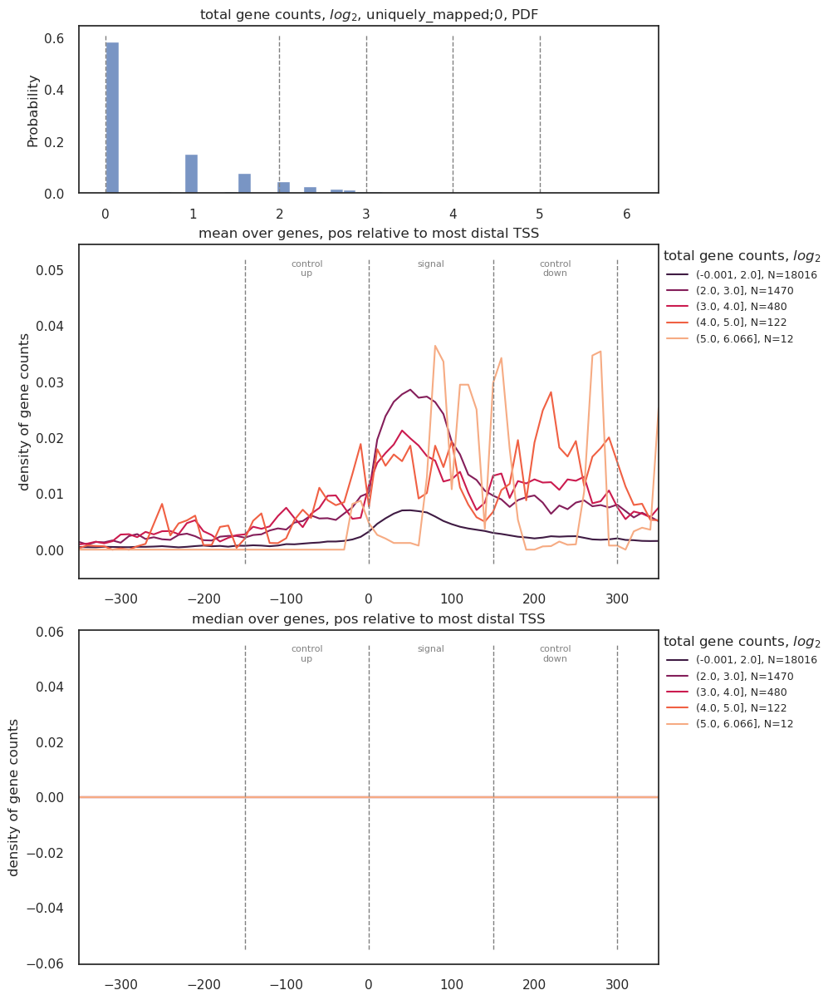

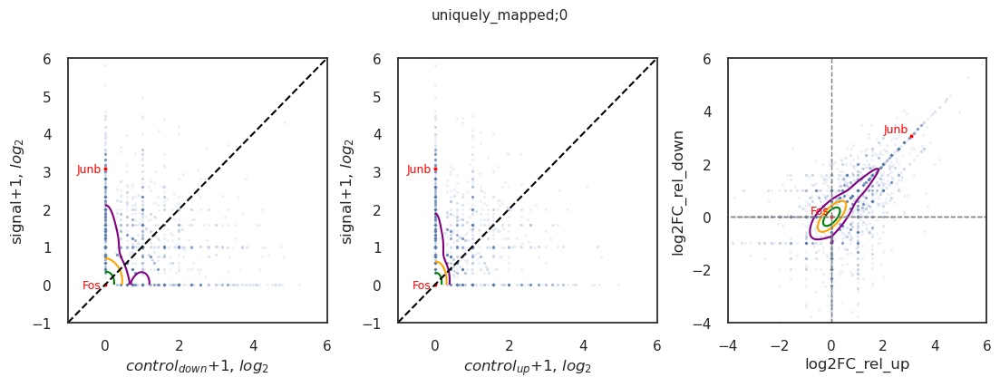

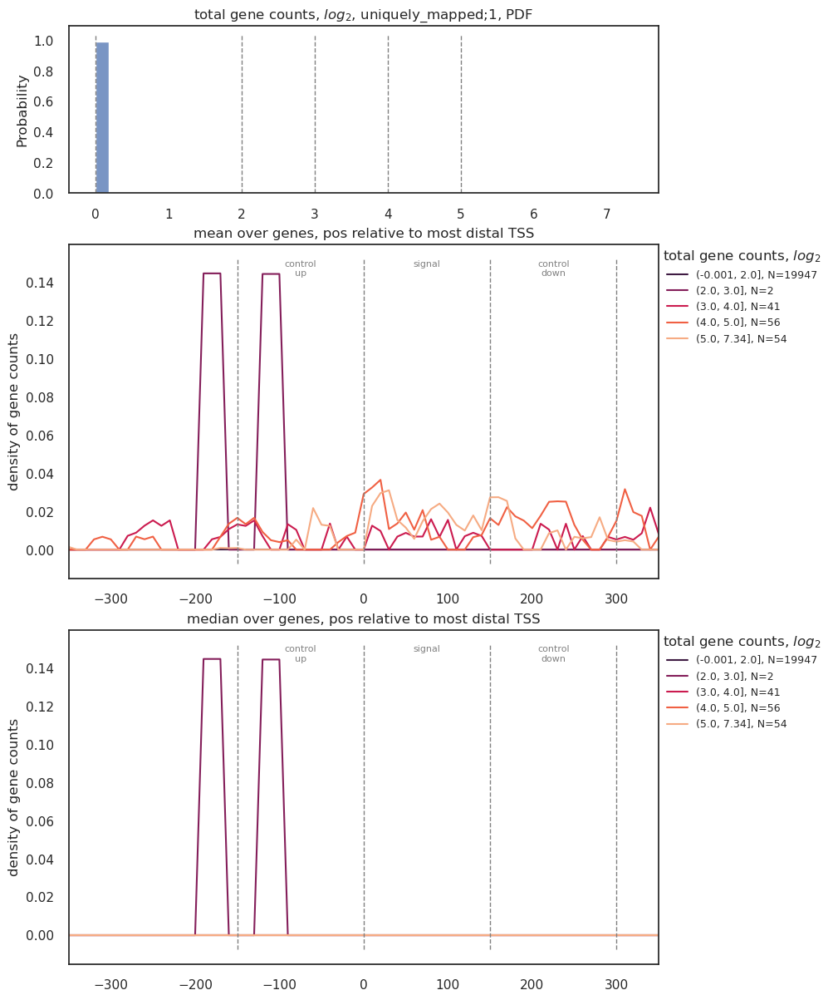

...

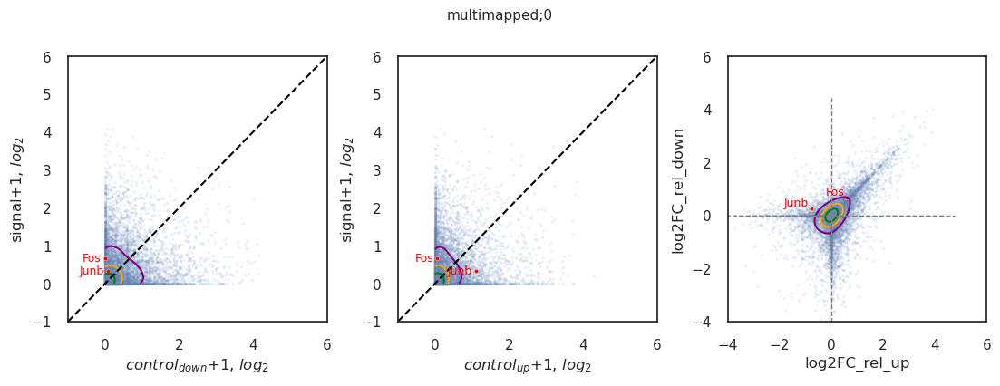

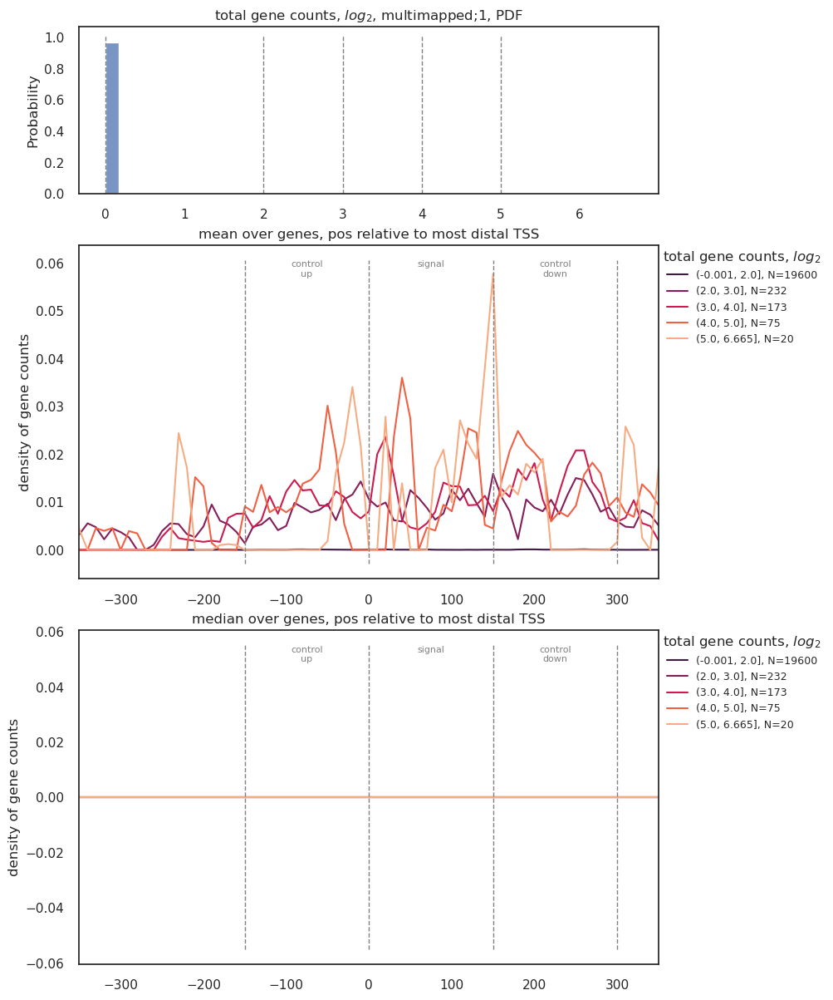

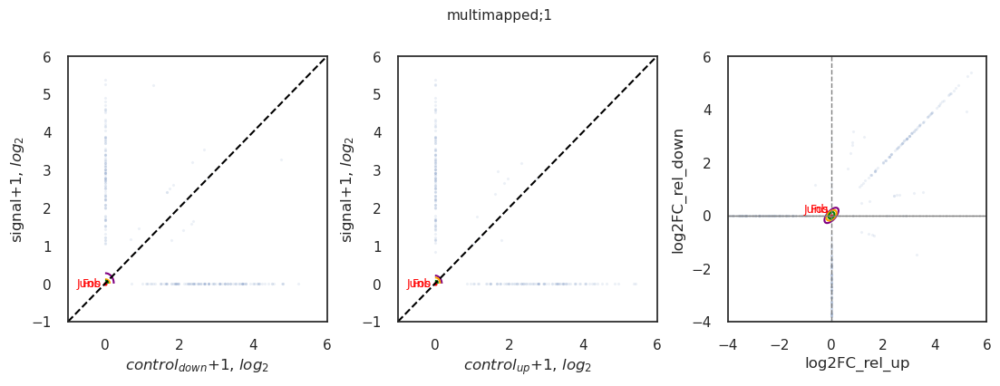

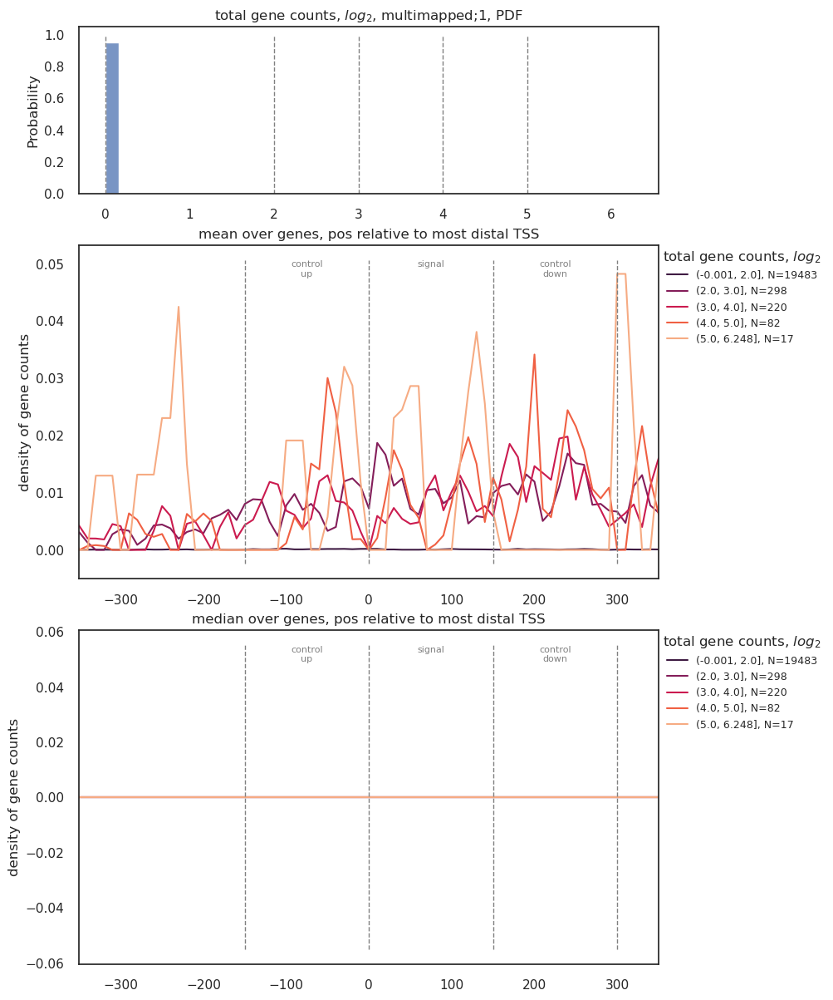

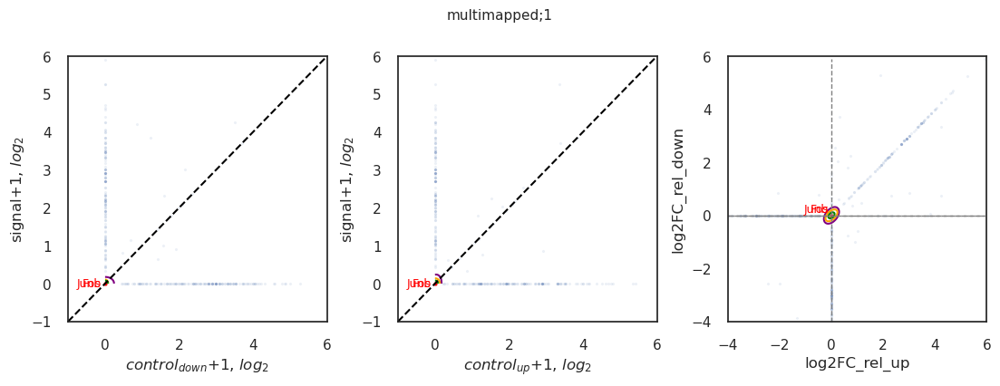

In [92]:
%%time
sample = '11C_exp17'
for count_col in ['uniquely_mapped;0','uniquely_mapped;1','multimapped;0','multimapped;1']:
    for read_fraction in ['long','short']:
        bin_counts_over_chrs = []
        for chr in chr_dict:
            input_file_path = '/scicore/home/zavolan/GROUP/StefanieCLIP/aleksei/output/samples/'+sample+'/segment_counts_'+read_fraction+'/binned_genome/'+sample+'.'+chr+'.wd_counts.tsv'
            bin_counts = pd.read_csv(input_file_path,delimiter="\t",index_col=None,header=0,dtype={"chr": "category","strand":"category","segment_name":"category"},nrows=5)
            i=0
            col_number = -1
            for elem in bin_counts.columns:
                if elem==count_col:
                    col_number = i
                i=i+1
            if col_number==-1:
                bin_counts = pd.read_csv(input_file_path,delimiter="\t",index_col=None,header=0,usecols=[0,1,2,3,4], dtype={"chr": "category","strand":"category","segment_name":"category"})
                bin_counts[count_col] = 0
            else:
                bin_counts = pd.read_csv(input_file_path,delimiter="\t",index_col=None,header=0,usecols=[0,1,2,3,4]+[col_number], dtype={"chr": "category","strand":"category","segment_name":"category"})
            
            bin_counts = bin_counts.loc[chr_dict[chr][0]].reset_index(drop=True)
            bin_counts['gene_id'] = chr_dict[chr][1]
            bin_counts['len'] = chr_dict[chr][2]
            bin_counts['pos_rel_to_TSS'] = chr_dict[chr][3]
        
            bin_counts_over_chrs.append(bin_counts)
            print(chr+' done')
        bin_counts_over_chrs = pd.concat(bin_counts_over_chrs).reset_index(drop=True)
        
        if count_col+'_sum' in list(bin_counts_over_chrs.columns):
            bin_counts_over_chrs = bin_counts_over_chrs.drop(count_col+'_sum',1)
        gr = bin_counts_over_chrs.groupby('gene_id').agg({count_col:np.sum}).reset_index().rename(columns={count_col:count_col+'_sum'})
        bin_counts_over_chrs = pd.merge(bin_counts_over_chrs,gr,how='left',on='gene_id')
        bin_counts_over_chrs['log2_'+count_col+'_sum'] = np.log2(bin_counts_over_chrs[count_col+'_sum']+1)
        
        # start plotting
        
        data = bin_counts_over_chrs.copy()
        data = pd.merge(data,genes[['gene_id','gene_type']],how='left',on='gene_id')
        data = data.loc[data['gene_type']=='protein_coding'].reset_index(drop=True)
        
        expr_thresholds = [0,2,3,4,5]
        window_borders = [-150,0,150,300]
        pseudocount = 1
        genes_of_interest = ['Junb','Fos']
        
        data['expr_cat'] = pd.cut(data['log2_'+count_col+'_sum'],bins=expr_thresholds+[data['log2_'+count_col+'_sum'].max()],include_lowest=True)
        data['frac'] = (data[count_col])/(data[count_col+'_sum']+1)
        
        data['window_signal'] = ((data['pos_rel_to_TSS']>window_borders[1])&(data['pos_rel_to_TSS']<=window_borders[2])).astype('int')
        data['window_control_down'] = ((data['pos_rel_to_TSS']>window_borders[2])&(data['pos_rel_to_TSS']<=window_borders[3])).astype('int')
        data['window_control_up'] = ((data['pos_rel_to_TSS']>window_borders[0])&(data['pos_rel_to_TSS']<=window_borders[1])).astype('int')
        data_log2FC = pd.merge(
            data.loc[data['window_signal']==1].groupby(['gene_id']).agg({count_col:np.sum}).reset_index().rename(columns={count_col:'signal'}),
            data.loc[data['window_control_down']==1].groupby(['gene_id']).agg({count_col:np.sum}).reset_index().rename(columns={count_col:'control_down'}),
            how='inner',on='gene_id')
        data_log2FC = pd.merge(
            data_log2FC,
            data.loc[data['window_control_up']==1].groupby(['gene_id']).agg({count_col:np.sum}).reset_index().rename(columns={count_col:'control_up'}),
            how='inner',on='gene_id')
        data_log2FC['gene_id'] = data_log2FC['gene_id'].astype('int')
        data_log2FC = pd.merge(data_log2FC,genes[['gene_id','gene_name']],how='left',on='gene_id')
        data_log2FC['log2_signal'] = np.log2(data_log2FC['signal']+pseudocount)
        data_log2FC['log2_control_down'] = np.log2(data_log2FC['control_down']+pseudocount)
        data_log2FC['log2_control_up'] = np.log2(data_log2FC['control_up']+pseudocount)
        data_log2FC['log2FC_rel_down'] = data_log2FC['log2_signal']-data_log2FC['log2_control_down']
        data_log2FC['log2FC_rel_up'] = data_log2FC['log2_signal']-data_log2FC['log2_control_up']
        data_log2FC['average'] = np.log2(data_log2FC['signal']+data_log2FC['control_up']+data_log2FC['control_down']+3*pseudocount)
        
        sns.set(font_scale=1)
        sns.set_style("white")
        fig, axes = plt.subplots(3, 1, sharey=False, sharex=False, figsize=(10,12),gridspec_kw={'height_ratios': [1,2,2]})
        
        gr = data[['gene_id',count_col+'_sum','log2_'+count_col+'_sum']].drop_duplicates().reset_index()
        ax = sns.histplot(ax=axes[0],data=gr['log2_'+count_col+'_sum'],bins=40,stat='probability')
        ylims = (ax.get_ylim()[0],ax.get_ylim()[1])
        for expr_threshold in expr_thresholds:
            ax.vlines(x=expr_threshold,ymin=ylims[0],ymax=ylims[1],color='grey',linestyles='--',linewidth=1)
        
        ax.set(title='total gene counts, $log_2$, '+count_col+', PDF',xlabel='')
        
        x_feature,y_feature = 'pos_rel_to_TSS','frac'
        xlims = (-350,350)
        l = list(data['expr_cat'].unique().sort_values())
        palette = sns.color_palette("rocket",len(l))
        i=0
        for expr_cat in l:
            data_sel = data.loc[(data['expr_cat']==expr_cat)]
            data_sel_gr = data_sel.groupby(x_feature).agg({y_feature:np.mean}).reset_index()
            ax1 = sns.lineplot(ax=axes[1],data = data_sel_gr,x=x_feature,y=y_feature,color=palette[i],label=str(expr_cat)+', N='+str(len(data_sel['gene_id'].unique())))
            ax1.set(title='mean over genes, pos relative to most distal TSS',xlabel='',ylabel='density of gene counts')
            
            data_sel_gr = data_sel.groupby(x_feature).agg({y_feature:np.median}).reset_index()
            ax2 = sns.lineplot(ax=axes[2],data = data_sel_gr,x=x_feature,y=y_feature,color=palette[i],label=str(expr_cat)+', N='+str(len(data_sel['gene_id'].unique())))
            ax2.set(title='median over genes, pos relative to most distal TSS',xlabel='',ylabel='density of gene counts')
            i=i+1
        
        ylims = (ax1.get_ylim()[0],ax1.get_ylim()[1])
        for window_border in window_borders:
            ax1.vlines(x=window_border,ymin=ylims[0],ymax=ylims[1],color='grey',linestyles='--',linewidth=1)
        ax1.text(np.mean(window_borders[0:2]),ylims[1],'control\nup',color='grey',size=8,ha='center',va='top')
        ax1.text(np.mean(window_borders[1:3]),ylims[1],'signal',color='grey',size=8,ha='center',va='top')
        ax1.text(np.mean(window_borders[2:]),ylims[1],'control\ndown',color='grey',size=8,ha='center',va='top')
        
        ax1.legend(bbox_to_anchor=(1, 0, 1, 1),loc='upper left',borderaxespad=0,title='total gene counts, $log_2$',markerscale=1.2,ncols=1,fontsize=9)
        
        ylims = (ax2.get_ylim()[0],ax2.get_ylim()[1])
        for window_border in window_borders:
            ax2.vlines(x=window_border,ymin=ylims[0],ymax=ylims[1],color='grey',linestyles='--',linewidth=1)
        ax2.text(np.mean(window_borders[0:2]),ylims[1],'control\nup',color='grey',size=8,ha='center',va='top')
        ax2.text(np.mean(window_borders[1:3]),ylims[1],'signal',color='grey',size=8,ha='center',va='top')
        ax2.text(np.mean(window_borders[2:]),ylims[1],'control\ndown',color='grey',size=8,ha='center',va='top')
        
        ax2.legend(bbox_to_anchor=(1, 0, 1, 1),loc='upper left',borderaxespad=0,title='total gene counts, $log_2$',markerscale=1.2,ncols=1,fontsize=9)
        
        fig.tight_layout(pad=0.5)
        
        out = subprocess.check_output('mkdir -p '+subdirs['reports_dir']+'/4_metaplots/1_dependence_on_total_gene_expression/', shell=True)
        fig.savefig(subdirs['reports_dir']+'/4_metaplots/1_dependence_on_total_gene_expression/'+read_fraction+'.'+sample+'.1.'+count_col+'.metaplot_total_counts.pdf',bbox_inches='tight',dpi=300)
        
        ax1.set(xlim=xlims)
        ax2.set(xlim=xlims)
        
        out = subprocess.check_output('mkdir -p '+subdirs['reports_dir']+'/4_metaplots/1_dependence_on_total_gene_expression/', shell=True)
        fig.savefig(subdirs['reports_dir']+'/4_metaplots/1_dependence_on_total_gene_expression/'+read_fraction+'.'+sample+'.2.'+count_col+'.metaplot_total_counts.zoomin.pdf',bbox_inches='tight',dpi=300)
        
        ## MA-plot-like
        
        bw_adjust = 1.75
        kde_plot_sample = 2000
        
        sns.set(font_scale=1)
        sns.set_style("white")
        fig, axes = plt.subplots(1, 3, sharey=False, sharex=False, figsize=(11,4),gridspec_kw={'width_ratios': [1,1,1]})
        
        x_feature,y_feature = 'log2_control_down','log2_signal'
        lims = (-1,6)
        
        ax = sns.kdeplot(ax=axes[0],data = data_log2FC.sample(kde_plot_sample),x=x_feature,y=y_feature,fill=False, cut=0, levels=[0.25],bw_adjust=bw_adjust,color='purple')
        ax = sns.kdeplot(ax=axes[0],data = data_log2FC.sample(kde_plot_sample),x=x_feature,y=y_feature,fill=False, cut=0, levels=[0.5],bw_adjust=bw_adjust,color='orange')
        ax = sns.kdeplot(ax=axes[0],data = data_log2FC.sample(kde_plot_sample),x=x_feature,y=y_feature,fill=False, cut=0, levels=[0.75],bw_adjust=bw_adjust,color='green')
        
        ax = sns.scatterplot(ax=axes[0],data = data_log2FC,x=x_feature,y=y_feature,s=5,alpha=0.1)
        ax = sns.lineplot(ax=axes[0],data = pd.DataFrame([[lims[0],lims[0]],[lims[1],lims[1]]],columns=[x_feature,y_feature]),x=x_feature,y=y_feature,color='black',linestyle='--')
        
        data_log2FC_of_interest = data_log2FC.loc[data_log2FC['gene_name'].isin(genes_of_interest)]
        ax = sns.scatterplot(ax=axes[0],data = data_log2FC_of_interest,x=x_feature,y=y_feature,s=10,alpha=1,color='red')
        for index,row in data_log2FC_of_interest.iterrows():
            ax.text(row[x_feature]-0.1,row[y_feature],row['gene_name'],color='red',size=9,ha='right',va='center')
        
        ax.set(xlabel='$control_{down}$+1, $log_2$',ylabel='signal+1, $log_2$',xlim=lims,ylim=lims)
        
        x_feature,y_feature = 'log2_control_up','log2_signal'
        lims = (-1,6)
        
        ax = sns.kdeplot(ax=axes[1],data = data_log2FC.sample(kde_plot_sample),x=x_feature,y=y_feature,fill=False, cut=0, levels=[0.25],bw_adjust=bw_adjust,color='purple')
        ax = sns.kdeplot(ax=axes[1],data = data_log2FC.sample(kde_plot_sample),x=x_feature,y=y_feature,fill=False, cut=0, levels=[0.5],bw_adjust=bw_adjust,color='orange')
        ax = sns.kdeplot(ax=axes[1],data = data_log2FC.sample(kde_plot_sample),x=x_feature,y=y_feature,fill=False, cut=0, levels=[0.75],bw_adjust=bw_adjust,color='green')
        
        ax = sns.scatterplot(ax=axes[1],data = data_log2FC,x=x_feature,y=y_feature,s=5,alpha=0.1)
        ax = sns.lineplot(ax=axes[1],data = pd.DataFrame([[lims[0],lims[0]],[lims[1],lims[1]]],columns=[x_feature,y_feature]),x=x_feature,y=y_feature,color='black',linestyle='--')
        
        data_log2FC_of_interest = data_log2FC.loc[data_log2FC['gene_name'].isin(genes_of_interest)]
        ax = sns.scatterplot(ax=axes[1],data = data_log2FC_of_interest,x=x_feature,y=y_feature,s=10,alpha=1,color='red')
        for index,row in data_log2FC_of_interest.iterrows():
            ax.text(row[x_feature]-0.1,row[y_feature],row['gene_name'],color='red',size=9,ha='right',va='center')
        
        ax.set(xlabel='$control_{up}$+1, $log_2$',ylabel='signal+1, $log_2$',xlim=lims,ylim=lims)
        
        x_feature,y_feature = 'log2FC_rel_up','log2FC_rel_down'
        lims = (-4,6)
        
        ax = sns.kdeplot(ax=axes[2],data = data_log2FC.sample(kde_plot_sample),x=x_feature,y=y_feature,fill=False, cut=0, levels=[0.25],bw_adjust=bw_adjust,color='purple')
        ax = sns.kdeplot(ax=axes[2],data = data_log2FC.sample(kde_plot_sample),x=x_feature,y=y_feature,fill=False, cut=0, levels=[0.5],bw_adjust=bw_adjust,color='orange')
        ax = sns.kdeplot(ax=axes[2],data = data_log2FC.sample(kde_plot_sample),x=x_feature,y=y_feature,fill=False, cut=0, levels=[0.75],bw_adjust=bw_adjust,color='green')
        
        ax = sns.scatterplot(ax=axes[2],data = data_log2FC,x=x_feature,y=y_feature,s=5,alpha=0.1)
        ax.hlines(y=0,xmin=ax.get_xlim()[0],xmax=ax.get_xlim()[1],color='grey',linestyles='--',linewidth=1)
        data_log2FC_of_interest = data_log2FC.loc[data_log2FC['gene_name'].isin(genes_of_interest)]
        ax = sns.scatterplot(ax=axes[2],data = data_log2FC_of_interest,x=x_feature,y=y_feature,s=10,alpha=1,color='red')
        for index,row in data_log2FC_of_interest.iterrows():
            ax.text(row[x_feature]-0.1,row[y_feature],row['gene_name'],color='red',size=9,ha='right',va='bottom')
        
        ax.hlines(y=0,xmin=ax.get_xlim()[0],xmax=ax.get_xlim()[1],color='grey',linestyles='--',linewidth=1)
        ax.vlines(x=0,ymin=ax.get_ylim()[0],ymax=ax.get_ylim()[1],color='grey',linestyles='--',linewidth=1)
        ax.set(xlim=lims,ylim=lims)
        
        fig.suptitle(count_col, x=0.5,y=1,size=11,ha='center',va='bottom')
        
        fig.tight_layout(pad=0.5)
        
        out = subprocess.check_output('mkdir -p '+subdirs['reports_dir']+'/4_metaplots/1_dependence_on_total_gene_expression/', shell=True)
        fig.savefig(subdirs['reports_dir']+'/4_metaplots/1_dependence_on_total_gene_expression/'+read_fraction+'.'+sample+'.3.'+count_col+'.MA_plot_like.png',bbox_inches='tight',dpi=600)

chr1 done
chr10 done
chr11 done
chr12 done
chr13 done
chr14 done
chr15 done
chr16 done
chr17 done
chr18 done
chr19 done
chr2 done
chr3 done
chr4 done
chr5 done
chr6 done
chr7 done
chr8 done
chr9 done
chrM done
chrX done
chrY done
CPU times: user 1min, sys: 6.01 s, total: 1min 6s
Wall time: 1min 7s


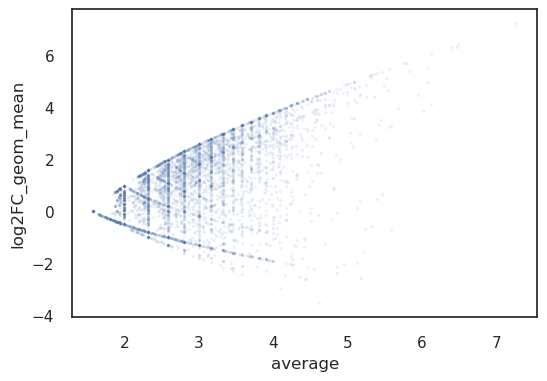

In [93]:
%%time
sample = '11C_exp17'
count_col = 'uniquely_mapped;0'
read_fraction = 'long'

bin_counts_over_chrs = []
for chr in chr_dict:
    input_file_path = '/scicore/home/zavolan/GROUP/StefanieCLIP/aleksei/output/samples/'+sample+'/segment_counts_'+read_fraction+'/binned_genome/'+sample+'.'+chr+'.wd_counts.tsv'
    bin_counts = pd.read_csv(input_file_path,delimiter="\t",index_col=None,header=0,dtype={"chr": "category","strand":"category","segment_name":"category"},nrows=5)
    i=0
    col_number = -1
    for elem in bin_counts.columns:
        if elem==count_col:
            col_number = i
        i=i+1
    if col_number==-1:
        bin_counts = pd.read_csv(input_file_path,delimiter="\t",index_col=None,header=0,usecols=[0,1,2,3,4], dtype={"chr": "category","strand":"category","segment_name":"category"})
        bin_counts[count_col] = 0
    else:
        bin_counts = pd.read_csv(input_file_path,delimiter="\t",index_col=None,header=0,usecols=[0,1,2,3,4]+[col_number], dtype={"chr": "category","strand":"category","segment_name":"category"})
    
    bin_counts = bin_counts.loc[chr_dict[chr][0]].reset_index(drop=True)
    bin_counts['gene_id'] = chr_dict[chr][1]
    bin_counts['len'] = chr_dict[chr][2]
    bin_counts['pos_rel_to_TSS'] = chr_dict[chr][3]

    bin_counts_over_chrs.append(bin_counts)
    print(chr+' done')
bin_counts_over_chrs = pd.concat(bin_counts_over_chrs).reset_index(drop=True)

if count_col+'_sum' in list(bin_counts_over_chrs.columns):
    bin_counts_over_chrs = bin_counts_over_chrs.drop(count_col+'_sum',1)
gr = bin_counts_over_chrs.groupby('gene_id').agg({count_col:np.sum}).reset_index().rename(columns={count_col:count_col+'_sum'})
bin_counts_over_chrs = pd.merge(bin_counts_over_chrs,gr,how='left',on='gene_id')
bin_counts_over_chrs['log2_'+count_col+'_sum'] = np.log2(bin_counts_over_chrs[count_col+'_sum']+1)

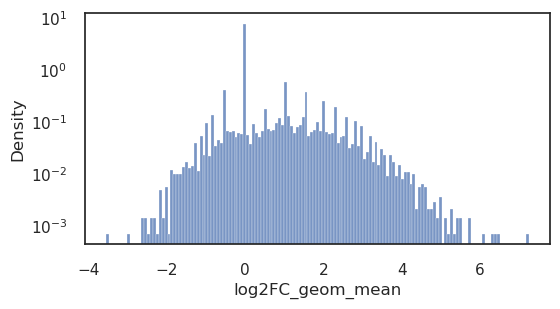

In [111]:
# start plotting

data = bin_counts_over_chrs.copy()
data = pd.merge(data,genes[['gene_id','gene_type']],how='left',on='gene_id')
data = data.loc[data['gene_type']=='protein_coding'].reset_index(drop=True)

expr_thresholds = [0,2,3,4,5]
window_borders = [-150,0,150,300]
pseudocount = 1
genes_of_interest = ['Junb','Fos']

data['expr_cat'] = pd.cut(data['log2_'+count_col+'_sum'],bins=expr_thresholds+[data['log2_'+count_col+'_sum'].max()],include_lowest=True)
data['frac'] = (data[count_col])/(data[count_col+'_sum']+1)

data['window_signal'] = ((data['pos_rel_to_TSS']>window_borders[1])&(data['pos_rel_to_TSS']<=window_borders[2])).astype('int')
data['window_control_down'] = ((data['pos_rel_to_TSS']>window_borders[2])&(data['pos_rel_to_TSS']<=window_borders[3])).astype('int')
data['window_control_up'] = ((data['pos_rel_to_TSS']>window_borders[0])&(data['pos_rel_to_TSS']<=window_borders[1])).astype('int')
data_log2FC = pd.merge(
    data.loc[data['window_signal']==1].groupby(['gene_id']).agg({count_col:np.sum}).reset_index().rename(columns={count_col:'signal'}),
    data.loc[data['window_control_down']==1].groupby(['gene_id']).agg({count_col:np.sum}).reset_index().rename(columns={count_col:'control_down'}),
    how='inner',on='gene_id')
data_log2FC = pd.merge(
    data_log2FC,
    data.loc[data['window_control_up']==1].groupby(['gene_id']).agg({count_col:np.sum}).reset_index().rename(columns={count_col:'control_up'}),
    how='inner',on='gene_id')
data_log2FC['gene_id'] = data_log2FC['gene_id'].astype('int')
data_log2FC = pd.merge(data_log2FC,genes[['gene_id','gene_name']],how='left',on='gene_id')
data_log2FC['log2_signal'] = np.log2(data_log2FC['signal']+pseudocount)
data_log2FC['log2_control_down'] = np.log2(data_log2FC['control_down']+pseudocount)
data_log2FC['log2_control_up'] = np.log2(data_log2FC['control_up']+pseudocount)
data_log2FC['log2FC_rel_down'] = data_log2FC['log2_signal']-data_log2FC['log2_control_down']
data_log2FC['log2FC_rel_up'] = data_log2FC['log2_signal']-data_log2FC['log2_control_up']
data_log2FC['average'] = np.log2(data_log2FC['signal']+data_log2FC['control_up']+data_log2FC['control_down']+3*pseudocount)

data_log2FC['log2FC_geom_mean'] = np.log2(((2**data_log2FC['log2FC_rel_down'])*(2**data_log2FC['log2FC_rel_up']))**0.5)


## MA-plot-like

bw_adjust = 1.75
kde_plot_sample = 2000

sns.set(font_scale=1)
sns.set_style("white")
fig, axes = plt.subplots(1, 1, sharey=False, sharex=False, figsize=(6,3))

feature = 'log2FC_geom_mean'

ax = sns.histplot(data_log2FC[y_feature],stat='density',log_scale=[False,True])

In [133]:
# Now, do for all TSS that can be quantified

up_border = 150
down_border = 300

transcripts['TSS'] = abs(transcripts['TSS'])*((transcripts[6]=='+').astype('int')*2-1)
transcripts = transcripts.drop_duplicates(['chr',6,'TSS']).sort_values(['chr',6,'TSS']).reset_index(drop=True)

a = []
i=0
prev_chr,prev_strand,prev_TSS = '','',-500
for row in transcripts[['chr',6,'TSS']].values:
    res = False
    if row[0]!=prev_chr or row[1]!=prev_strand:
        prev_TSS = -500
    if row[2]>prev_TSS+down_border+up_border:
        res = True
    a.append(res)
    prev_chr,prev_strand,prev_TSS = row[0],row[1],row[2]
    i=i+1
transcripts['suites'] = a

In [135]:
transcripts.tail(30)

,chr,3,4,6,gene_id,gene_name,gene_type,TSS,len,suites
137817,chrY,1308273,1308377,-,55307,Gm25565,snRNA,-1308377,105,True
137818,chrY,1260771,1286629,-,55303,Ddx3y,protein_coding,-1286629,25859,True
137819,chrY,1262313,1286582,-,55303,Ddx3y,protein_coding,-1286582,24270,False
137820,chrY,1277313,1277582,-,55305,Gm18665,unprocessed_pseudogene,-1277582,270,True
137821,chrY,1268548,1268885,-,55304,Gm4017,processed_pseudogene,-1268885,338,True
137822,chrY,1260772,1265031,-,55303,Ddx3y,protein_coding,-1265031,4260,True
137823,chrY,1263796,1264459,-,55303,Ddx3y,protein_coding,-1264459,664,True
137824,chrY,1098020,1245759,-,55302,Uty,protein_coding,-1245759,147740,True
137825,chrY,1151949,1245756,-,55302,Uty,protein_coding,-1245756,93808,False
137826,chrY,1199297,1245739,-,55302,Uty,protein_coding,-1245739,46443,False


In [ ]:




gr = transcripts.groupby(['gene_id','gene_name','gene_type','chr',6]).agg({'TSS':{min,max},'len':max}).reset_index()
gr.columns = gr.columns.droplevel(0)
gr.columns = ['gene_id','gene_name','gene_type','chr','strand','max','min','len']
gr['TSS'] = gr.apply(lambda x:x['min'] if x['strand']=='+' else x['max'],1)

genes = gr[['gene_id','gene_name','gene_type','chr','strand','TSS','len']]
genes['TSS'] = genes['TSS'].astype('int')
genes = genes.sort_values(['chr','strand','TSS']).reset_index(drop=True)
genes['gene_id'] = genes['gene_id'].astype('int')

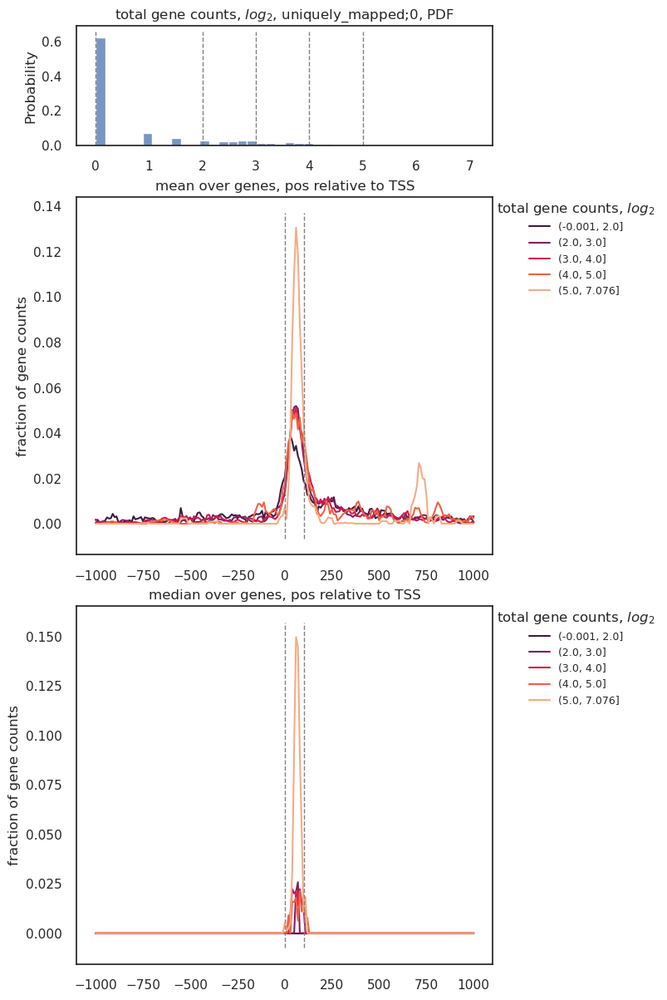

In [469]:
window_limit = 1000

data = bin_counts.loc[(abs(bin_counts['pos_rel_to_TSS'])<=window_limit)&(bin_counts['len']>window_limit)].reset_index()

if count_col+'_sum' in list(data.columns):
    data = data.drop(count_col+'_sum',1)
gr = data.groupby('gene_id').agg({count_col:np.sum}).reset_index().rename(columns={count_col:count_col+'_sum'})
data = pd.merge(data,gr,how='left',on='gene_id')
data['log2_'+count_col+'_sum'] = np.log2(data[count_col+'_sum']+1)

# we can set a broader window if needed
# genome_binning_size = 10
# data['pos_rel_to_TSS_bins'] = pd.cut(data['pos_rel_to_TSS'],bins=np.arange(data['pos_rel_to_TSS'].min(),data['pos_rel_to_TSS'].max()+genome_binning_size,genome_binning_size),include_lowest=True)
# data = pd.merge(data,data.groupby(['pos_rel_to_TSS_bins']).agg({'pos_rel_to_TSS':np.mean}).reset_index().rename(columns={'pos_rel_to_TSS':'pos_rel_to_TSS_mod'}),how='left',on='pos_rel_to_TSS_bins')
# data['pos_rel_to_TSS_mod'] = (np.round(data['pos_rel_to_TSS_mod']/10,0)*10).astype('int')
# data = data.groupby(['gene_id','pos_rel_to_TSS_mod',count_col+'_sum']).agg({count_col:np.sum}).reset_index()

data['pos_rel_to_TSS_mod'] = data['pos_rel_to_TSS']

expr_thresholds = [0,2,3,4,5]
window_borders = [0,150]

data['expr_cat'] = pd.cut(data['log2_'+count_col+'_sum'],bins=expr_thresholds+[data['log2_'+count_col+'_sum'].max()],include_lowest=True)

sns.set(font_scale=1)
sns.set_style("white")
fig, axes = plt.subplots(3, 1, sharey=False, sharex=False, figsize=(8,12),gridspec_kw={'height_ratios': [1,3,3]})

gr = data[['gene_id',count_col+'_sum','log2_'+count_col+'_sum']].drop_duplicates().reset_index()
ax = sns.histplot(ax=axes[0],data=gr['log2_'+count_col+'_sum'],bins=40,stat='probability')
ylims = (ax.get_ylim()[0],ax.get_ylim()[1])
for expr_threshold in expr_thresholds:
    ax.vlines(x=expr_threshold,ymin=ylims[0],ymax=ylims[1],color='grey',linestyles='--',linewidth=1)

ax.set(title='total gene counts, $log_2$, '+count_col+', PDF',xlabel='')

l = list(data['expr_cat'].unique().sort_values())
palette = sns.color_palette("rocket",len(l))
i=0
for expr_cat in l:
    data_sel = data.loc[(data['expr_cat']==expr_cat)]
    data_sel['frac'] = data_sel[count_col]/data_sel[count_col+'_sum']
    data_sel_gr = data_sel.groupby('pos_rel_to_TSS_mod').agg({'frac':np.mean}).reset_index()
    ax1 = sns.lineplot(ax=axes[1],data = data_sel_gr,x='pos_rel_to_TSS_mod',y='frac',color=palette[i],label=expr_cat)
    ax1.set(title='mean over genes, pos relative to TSS',xlabel='',ylabel='fraction of gene counts')
    
    data_sel_gr = data_sel.groupby('pos_rel_to_TSS_mod').agg({'frac':np.median}).reset_index()
    ax2 = sns.lineplot(ax=axes[2],data = data_sel_gr,x='pos_rel_to_TSS_mod',y='frac',color=palette[i],label=expr_cat)
    ax2.set(title='median over genes, pos relative to TSS',xlabel='',ylabel='fraction of gene counts')
    i=i+1

ylims = (ax1.get_ylim()[0],ax1.get_ylim()[1])
for window_border in window_borders:
    ax1.vlines(x=window_border,ymin=ylims[0],ymax=ylims[1],color='grey',linestyles='--',linewidth=1)
ax1.legend(bbox_to_anchor=(1, 0, 1, 1),loc='upper left',borderaxespad=0,title='total gene counts, $log_2$',markerscale=1.2,ncols=1,fontsize=9)

ylims = (ax2.get_ylim()[0],ax2.get_ylim()[1])
for window_border in window_borders:
    ax2.vlines(x=window_border,ymin=ylims[0],ymax=ylims[1],color='grey',linestyles='--',linewidth=1)
ax2.legend(bbox_to_anchor=(1, 0, 1, 1),loc='upper left',borderaxespad=0,title='total gene counts, $log_2$',markerscale=1.2,ncols=1,fontsize=9)

fig.tight_layout(pad=0.5)



In [55]:
bin_counts.memory_usage(index=False, deep=True).sum()

207698432

In [ ]:
bin_counts['segment_type'] = bin_counts['segment_name'].str.split(';',expand=True)[0]
bin_counts['gene_ids'] = bin_counts['segment_name'].str.split(';',expand=True)[1]
# five prime and three prime here are defined strand-specifically (at least should be)

In [17]:
# define TSS for each gene
gr = bin_counts.loc[bin_counts['segment_name'].str.contains('alw_exonic|exonic_or_intronic|alw_intronic')].groupby(['gene_ids','strand']).agg({'start':min,'end':max}).reset_index()
gr = gr.loc[~gr['gene_ids'].str.contains('|'.join(['gene_flank','exonic','intronic']))].reset_index(drop=True) # on the borders between regions there are weird segment names (expected)
# gr['TSS'] = gr.apply(lambda x:x['start'] if x['strand']=='+' else x['end'],1)
# bin_counts = pd.merge(bin_counts,gr[['gene_id','TSS']],how='left',on='gene_id')

# bin_counts['interval_mid'] = bin_counts[['start','end']].mean(1).astype('int')
# bin_counts['relative_pos'] = (bin_counts['interval_mid']-bin_counts['TSS'])*((bin_counts['strand']=='+').astype('int')*2-1)

# gr = bin_counts.groupby('gene_id').agg({count_col:sum}).reset_index().rename(columns={count_col:count_col+'_genesum'})
# bin_counts = pd.merge(bin_counts,gr,how='left',on='gene_id')

# bin_counts = pd.merge(bin_counts,genes,how='left',on=['gene_id'])

In [39]:
gr

,gene_ids,strand,start,end
0,27355,-,3038668,3038738
1,27356,-,3133846,3199796
2,"27356,27357",-,3136046,3139736
3,27358,+,3187116,3188326
4,27359,+,3199886,3215226
...,...,...,...,...
3020,30261,-,124127930,124128200
3021,30262,+,124195826,124204756
3022,30263,-,124206626,124207396
3023,30264,-,124226500,124227140


In [36]:
df = gr['gene_ids'].str.split(',',expand=True)
for col in df:
    break

In [37]:
pd.concat([df[col],gr[['']]],axis=1)

0       27355
1       27356
2       27356
3       27358
4       27359
        ...  
3020    30261
3021    30262
3022    30263
3023    30264
3024    30265
Name: 0, Length: 3025, dtype: object

In [91]:
data = bin_counts.loc[(bin_counts['gene_id']==44955)]
data

,chr_x,start,end,strand,segment_name,uniquely_mapped;0,uniquely_mapped;1,uniquely_mapped;2,uniquely_mapped;3,multimapped;0,...,multimapped;3,segment_type,gene_id,TSS,interval_mid,relative_pos,uniquely_mapped;0_genesum,chr_y,gene_name,gene_type


In [71]:
sns.set(font_scale=1)
sns.set_style("white")
fig, axes = plt.subplots(1, 1, sharey=False, sharex=False, figsize=(6,6))

ax = sns.pointplot(data = data.loc[data['pval_adj']>=0.05],x='median',y='log2FC',color='blue',s=5,alpha=0.3)


,chr,start,end,strand,segment_name,uniquely_mapped;0,uniquely_mapped;1,uniquely_mapped;2,uniquely_mapped;3,multimapped;0,...,multimapped;2,multimapped;3,segment_type,gene_id,TSS,interval_mid,relative_pos,uniquely_mapped;0_genesum,gene_name,gene_type
0,chr1,3142475,3142485,+,five_prime_only_gene_flank;0,0.0,0.0,0,0,0.0,...,0.0,0,five_prime_only_gene_flank,0,3143475,3142480,-995,0.0,4933401J01Rik,TEC
1,chr1,3142485,3142495,+,five_prime_only_gene_flank;0,0.0,0.0,0,0,0.0,...,0.0,0,five_prime_only_gene_flank,0,3143475,3142490,-985,0.0,4933401J01Rik,TEC
2,chr1,3142495,3142505,+,five_prime_only_gene_flank;0,0.0,0.0,0,0,0.0,...,0.0,0,five_prime_only_gene_flank,0,3143475,3142500,-975,0.0,4933401J01Rik,TEC
3,chr1,3142505,3142515,+,five_prime_only_gene_flank;0,0.0,0.0,0,0,0.0,...,0.0,0,five_prime_only_gene_flank,0,3143475,3142510,-965,0.0,4933401J01Rik,TEC
4,chr1,3142515,3142525,+,five_prime_only_gene_flank;0,0.0,0.0,0,0,0.0,...,0.0,0,five_prime_only_gene_flank,0,3143475,3142520,-955,0.0,4933401J01Rik,TEC


,gene_id,strand,start,end,TSS
0,0,+,3143475,3144545,3143475
1,1,+,3172238,3172348,3172238
2,13,+,3822232,3824582,3822232
3,"13,three_prime_only_gene_flank",+,3824582,3824592,3824582
4,137,+,10938911,10939661,10938911
...,...,...,...,...,...
163,"9707,three_prime_only_gene_flank",+,119551156,119551166,119551156
164,9709,+,119631552,119631672,119631552
165,"9709,three_prime_only_gene_flank",+,119631672,119631682,119631672
166,99,-,9509965,9510595,9510595


In [47]:


bin_counts['relative_position'] = bin_counts['']

,chr,start,end,strand,segment_name,uniquely_mapped;0,uniquely_mapped;1,uniquely_mapped;2,uniquely_mapped;3,multimapped;0,multimapped;1,multimapped;2,multimapped;3,segment_type,gene_id
408,chr1,3172248,3172258,+,alw_exonic;1,0.200,0.0,0,0,0.000,0.0,0.0,0,alw_exonic,1
409,chr1,3172258,3172268,+,alw_exonic;1,0.700,0.0,0,0,0.208,0.0,0.0,0,alw_exonic,1
410,chr1,3172268,3172278,+,alw_exonic;1,0.866,0.0,0,0,0.374,0.0,0.0,0,alw_exonic,1
411,chr1,3172278,3172288,+,alw_exonic;1,0.866,0.0,0,0,0.415,0.0,0.0,0,alw_exonic,1
412,chr1,3172288,3172298,+,alw_exonic;1,0.866,0.0,0,0,0.332,0.0,0.0,0,alw_exonic,1


In [ ]:
# STOPPED HERE

## DE on segment counts with different measures

In [177]:
# take only the final fraction - sense reads mapped to protein-coding genes - alw exonic segments

In [ ]:
### HELPER FUNCTIONS
def plot_median_pointplots(data,cat_feature,cat_feature_label,val_feature,hue,hue_order,title,group_1_x_group_2_sel,horizontal_lines,horizontal_line_colors,texts,subplot_height,height_ratios,savefig_path):

    sns.set(font_scale=1)
    sns.set_style("white")

    plt.rcParams['xtick.major.size'] = 3
    plt.rcParams['xtick.major.width'] = 1
    plt.rcParams['ytick.major.size'] = 3
    plt.rcParams['ytick.major.width'] = 1
    plt.rcParams['xtick.bottom'] = True
    plt.rcParams['ytick.left'] = True

    order = list(data[[cat_feature]].drop_duplicates().sort_values(cat_feature)[cat_feature])
    
    fig, axes = plt.subplots(len(group_1_x_group_2_sel), 1, sharey=False, sharex=True, 
                             figsize=(10,subplot_height*len(group_1_x_group_2_sel)),
                             gridspec_kw={'height_ratios': height_ratios})

    i = 0
    for group_1_x_group_2_cur in group_1_x_group_2_sel:
        data_cur = data.loc[(data['group_1_x_group_2']=='-'.join(group_1_x_group_2_cur))].reset_index(drop=True)
        group_3_order_cur = [treatment for treatment in hue_order if treatment in list(data_cur['group_3'].unique())]
        palette_cur = [(metadata.loc[metadata['group_3']==treatment]['color'].iloc[0] if treatment in list(metadata['group_3'].unique()) else 'black') for treatment in group_3_order_cur]
        
        ax = sns.pointplot(ax=(axes[i] if len(group_1_x_group_2_sel)>1 else axes),
                               data = data_cur,
                               x=cat_feature,y=val_feature,hue=hue,
                               order = order,
                               hue_order=group_3_order_cur,
                               palette = palette_cur,
                           dodge=0.5,join=False,
                           estimator='median',errorbar=('ci', 95),
                           capsize=.05,scale=0.4,errwidth=0.8)

        sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 0, 1, 1),ncols=2,fontsize=9,title='-'.join(group_1_x_group_2_cur),markerscale=1.5)    
        ax.set(ylabel = '')
        if i==0:
            ax.set(title=title)

        if i<len(group_1_x_group_2_sel)-1:
            ax.set(xlabel='')
            ax.tick_params(
                axis='x',          # changes apply to the x-axis
                which='both',      # both major and minor ticks are affected
                bottom=False,      # ticks along the bottom edge are off
                top=False,         # ticks along the top edge are off
                labelbottom=False) # labels along the bottom edge are off
        else:
            ax.set(xlabel = cat_feature_label)

        ax.set(ylim=(-0.05,max(max(horizontal_lines[i])+0.1,ax.get_ylim()[1])),xlim = (-1,(len(data[cat_feature].unique()))))

        # draw a horizontal line if specified
        if horizontal_lines[i] is not None:
            k=0
            for horizontal_line in horizontal_lines[i]:
                if horizontal_line_colors[i] is not None:
                    color = horizontal_line_colors[i][k]
                else:
                    color = 'grey'
                ax.hlines(y=horizontal_line,xmin=ax.get_xlim()[0],xmax=ax.get_xlim()[1],color=color,linestyles='--',linewidth=0.7)
                k=k+1
        # add texts if specified
        if (texts[i] is not None):
            for text in texts[i]:
                ax.text(ax.get_xlim()[0]+0.3,text['y_pos'],text['text'],ha=text['ha'],va=text['va'],size=text['size'])

        i=i+1
    fig.savefig(savefig_path,bbox_inches='tight',dpi=300)

def get_frac_of_non_DE_segments(data,l):
    data['log2FC'] = data[l[0]]-data[l[1]]
    pvals = 2*(1-stats.norm.cdf(abs(data['log2FC']),0,(2**0.5)*data['std'])) # we add (2**0.5) because we need the estimation for the log2FC, not the count itself
    data['pval'] = pvals
    data['pval_adj'] = multipletests(pvals = pvals,method='bonferroni')[1]
    # data['pval_adj'] = data['pval'] # to increase sensitivity of the analysis
    frac = len(data.loc[data['pval_adj']>=0.05])/len(data)
    return frac
    # absol_number = len(data.loc[data['pval_adj']<0.05])
    # return absol_number


pseudocounts = [1]*len(count_cols) # here one can specify gene count category - specific pseudocount
minimal_std = 0.001

# we need to exclude Riboseq because we look on CDSs as well as UTRs, while in Riboseq studies only CDSs are expected to be covered 
group_1_x_group_2_filtered = [elem for elem in group_1_x_group_2 if elem[1]!='RPF']

# we need to modify point_plots_width_ratios because of the above
point_plots_width_ratios_filtered = []
k=0
for elem in point_plots_width_ratios:
    if group_1_x_group_2[k][1]!='RPF':
        point_plots_width_ratios_filtered.append(elem)
    k=k+1

# add this columns to metadata, for simplicity
metadata['group_1_x_group_2'] = metadata['group_1']+'-'+metadata['group_2']

techn_replic_corrs_list = [] # this list should be used to store the analysis of replicability in technical replicates in different gene count categories
M = 1 # iterator for gene count categories
for count_col in count_cols:

    pseudocount = pseudocounts[M-1]

    label = get_class_label(count_col,dupl_cats_dict)
    list_of_samples = list(pd.merge(metadata,pd.DataFrame(group_1_x_group_2_filtered,columns=['group_1','group_2']),how='inner',on=['group_1','group_2'])['sample'])

    # construct gene expression matrix in which rows are segments and columns are samples
    x = pd.pivot_table(pd.concat(WD)[['chr','start','end','strand','segment_name','sample']+[count_col]],
                   index=['chr','start','end','strand','segment_name'],columns='sample',values=count_col).reset_index()
    
    # add pseudocount to exclude zeros
    x[list_of_samples] = x[list_of_samples]+pseudocount

    # estimate size factors in a two-step procedure
    # first, take subset of genes with at least <first_step_thr> reads across (almost) all samples
    # then do median-median normalization and select genes with the smallest fluctuations
    # then use only those to do second step - calculate size factors using this small set of genes
    
    x['median'] = x[list_of_samples].quantile(axis=1,q=0.5) # take median for each segment across samples
    first_step_thr = x['median'].quantile(0.8) # take 20% of genes with highest median

    if len(x.loc[x['median']>first_step_thr])<30:
        print(label+' cannot estimate size factors, too many genes with near-zero counts across the dataset')
        M=M+1
        continue
    else:
        x_sel = x.loc[x['median']>first_step_thr].reset_index(drop=True)

    x_sel_stand = pd.concat([x_sel[['chr','start','end','strand','segment_name']],
                             (x_sel[list_of_samples]).div(x_sel['median'], axis=0)],axis=1).reset_index(drop=True) # divide each row value over its median and save in a different dataframe
    
    size_factors = np.median(x_sel_stand[list_of_samples],axis=0) # get medians over columns
    x_sel = pd.concat([x_sel[['chr','start','end','strand','segment_name']],
                       (x_sel[list_of_samples]).div(size_factors, axis=1)],axis=1).reset_index(drop=True) # divide each column value of raw counts over its size factor

    x_sel['iqr'] = x_sel[list_of_samples].quantile(axis=1,q=0.75)-x_sel[list_of_samples].quantile(axis=1,q=0.25)
    x_sel['median'] = x_sel[list_of_samples].median(1)
    x_sel['iqr_over_median'] = x_sel['iqr']/x_sel['median']
    LQ,UQ = x_sel['median'].quantile(0.25),x_sel['median'].quantile(0.75)
    
    if UQ==LQ:
        print(label+' cannot estimate size factors, can not get stable seqments')
        M=M+1
        continue
    stable_segments = x_sel.loc[(x_sel['median']>LQ)&(x_sel['median']<UQ)].sort_values('iqr_over_median').head(500)[['chr','start','end','strand','segment_name']].reset_index(drop=True)
    # end of first step

    # # now do second step - take only raw counts of stable segments and get the size factors using those
    x_sel = pd.merge(stable_segments,x,how='inner',on=['chr','start','end','strand','segment_name'])
    x_sel['median'] = x_sel[list_of_samples].median(1)
    x_sel_stand = pd.concat([x_sel[['chr','start','end','strand','segment_name']],(x_sel[list_of_samples]).div(x_sel['median'], axis=0)],axis=1).reset_index(drop=True)
    size_factors = np.median(x_sel_stand[list_of_samples],axis=0)

    # size factor plot
    sns.set(font_scale=1)
    sns.set_style("white")
    fig, axes = plt.subplots(1, 1, sharey=False, sharex=False, figsize=(5,4))

    tmp = pd.DataFrame(list_of_samples,columns=['sample'])
    tmp = pd.merge(tmp,metadata,how='left',on='sample')
    
    group_1_x_group_2_vals = ['-'.join(elem) for elem in group_1_x_group_2_filtered]
    palette = sns.color_palette('tab20',len(group_1_x_group_2_vals))

    tmp['sf_log2'] = list(np.log2(size_factors))

    ax = sns.histplot(data=tmp,x='sf_log2',hue='group_1_x_group_2',hue_order=group_1_x_group_2_vals,palette=palette,stat="proportion",common_norm=False,)
    sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 0, 1, 1),ncols=1,fontsize=9)
    ax.set(xlabel=r'size factor, $log_2$')

    out = subprocess.check_output('mkdir -p '+subdirs['reports_dir']+'/4_replicability_on_segment_counts/', shell=True)
    fig.savefig(subdirs['reports_dir']+'/4_replicability_on_segment_counts/'+str(M)+'.'+label.replace('\n',';')+'.1.STUDY_WIDE.size_factor_histogram'+'.pdf',bbox_inches='tight',dpi=300)
    
    # remove too lowly expressed segments
    x['max'] = x[list_of_samples].quantile(axis=1,q=0.9)
    x_sel = x.loc[x['max']>pseudocount].reset_index(drop=True)
    
    # final normalization for library size
    x_sel = pd.concat([x_sel[['chr','start','end','strand','segment_name']],(x_sel[list_of_samples]).div(size_factors, axis=1)],axis=1).reset_index(drop=True)
    x_sel[list_of_samples] = np.log2(x_sel[list_of_samples])

    x_sel['median'] = x_sel[list_of_samples].median(1)
    x_sel['median_cat'] = pd.cut(x_sel['median'],bins = range(int(np.floor(x_sel['median'].min())),int(np.ceil(x_sel['median'].max()/2)*2)+2,2))
    
    x_sel['iqr'] = x_sel[list_of_samples].quantile(axis=1,q=0.75)-x_sel[list_of_samples].quantile(axis=1,q=0.25)
    
    # diagnostic plot median expression vs iqr
    g = sns.jointplot(data = x_sel,x='median',y='iqr',alpha=0.5,s=3,height=5)
    ax = g.ax_joint
    ax.set(xlabel='median gene expression level, $log_2$ normalized count',ylabel='IQR')
    out = subprocess.check_output('mkdir -p '+subdirs['reports_dir']+'/4_replicability_on_segment_counts/', shell=True)
    g.savefig(subdirs['reports_dir']+'/4_replicability_on_segment_counts/'+str(M)+'.'+label.replace('\n',';')+'.2.STUDY_WIDE.MEDIAN-IQR_diagnostic_plot'+'.pdf',bbox_inches='tight',dpi=300)
    
    
    ### modify metadata

    tmp = pd.DataFrame(list_of_samples,columns=['sample'])
    tmp = pd.merge(tmp,metadata,how='left',on='sample')
    group_1_x_group_2_vals = ['-'.join(elem) for elem in group_1_x_group_2_filtered]
    group_1_x_group_2_palette = sns.color_palette('tab20',len(group_1_x_group_2_vals))

    tmp = pd.merge(tmp,
             pd.DataFrame([group_1_x_group_2_vals,group_1_x_group_2_palette]).transpose().rename(columns={0:'group_1_x_group_2',1:'group_1_x_group_2_color'}),
             how='inner',on='group_1_x_group_2')

    group_3_order_df = pd.DataFrame(group_3_order,columns=['group_3'])
    group_3_order_df['order_treatment'] = group_3_order_df.index
    group_1_x_group_2_order_df = pd.DataFrame(group_1_x_group_2_filtered,columns=['group_1','group_2'])
    group_1_x_group_2_order_df['order_group_1_x_group_2'] = group_1_x_group_2_order_df.index

    tmp = pd.merge(tmp,group_3_order_df,how='inner',on=['group_3'])
    tmp = pd.merge(tmp,group_1_x_group_2_order_df,how='inner',on=['group_1','group_2'])
    tmp['bio_replicate'] = tmp['replicate'].str.split(';',expand=True)[0]
    tmp['techn_replicate'] = (tmp['replicate'].str.split(';',expand=True).iloc[:, -1]).fillna('NA')
    tmp = tmp.sort_values(['order_group_1_x_group_2','order_treatment','bio_replicate','techn_replicate']).reset_index(drop=True)
    target_order = list(tmp['sample'])

    tmp['t']=1
    gr = tmp.groupby(['group_1_x_group_2','group_3','order_group_1_x_group_2','order_treatment']).agg({'t':sum}).reset_index().sort_values(['order_group_1_x_group_2','order_treatment']).drop(['order_group_1_x_group_2','order_treatment'],1)

    ### analysis of log2FC of expression within techn replicates

    techn_replicates = tmp.loc[tmp['techn_replicate']!='NA'][['group_1_x_group_2','group_3','bio_replicate','sample']].reset_index(drop=True)
    b = []
    for elem in techn_replicates.groupby(['group_1_x_group_2','group_3']):
        a = []
        for sub_elem in elem[1].groupby('bio_replicate'):
            sel_samples = list(elem[1]['sample'])
            a.append(x_sel[sel_samples].std(1))
        cur = pd.DataFrame([list(pd.concat(a,axis=1).mean(1)),list(x_sel['median_cat']),list(x_sel['median'])]).transpose().rename(columns = {0:'std',1:'median_cat',2:'median'})
        cur['group_1_x_group_2'] = elem[0][0]
        cur['group_3'] = elem[0][1]
        b.append(cur)
    SEs_techn = pd.concat(b).reset_index(drop=True)

    cat_feature = 'median_cat'
    cat_feature_label = 'median gene expression level, $log_2$ normalized count'
    val_feature = 'std'
    hue = 'group_3'
    hue_order = group_3_order
    title = label+'\n'+'Y-axis: st. dev. of $log_2FC$ between techn. replicates, median values + 95%CI'

    out = subprocess.check_output('mkdir -p '+subdirs['reports_dir']+'/4_replicability_on_segment_counts/', shell=True)
    savefig_path = subdirs['reports_dir']+'/4_replicability_on_segment_counts/'+str(M)+'.'+label.replace('\n',';')+'.3.STUDY_WIDE.TECHN_REPL_stdev_of_log2FC'+'.pdf'

    group_1_x_group_2_sel = [elem for elem in group_1_x_group_2_filtered if ('-'.join(elem) in list(SEs_techn['group_1_x_group_2'].unique()))]

    horizontal_lines = [[1,0.5,0.25]]*len(group_1_x_group_2_sel)
    horizontal_line_colors = [['red','orange','green']]*len(group_1_x_group_2_sel)
    texts = [None]*(len(group_1_x_group_2_sel))

    subplot_height = 1.7
    height_ratios = [max(1.1,np.round(SEs_techn.loc[(SEs_techn['group_1_x_group_2']=='-'.join(group_1_x_group_2_cur))].groupby([hue,cat_feature]).agg({val_feature:'median'}).reset_index()[val_feature].max(),1)) for group_1_x_group_2_cur in group_1_x_group_2_sel]

    plot_median_pointplots(SEs_techn.copy(),cat_feature,cat_feature_label,val_feature,hue,hue_order,title,group_1_x_group_2_sel,horizontal_lines,horizontal_line_colors,texts,subplot_height,height_ratios,savefig_path)
    
    ### analysis of expression std within treatment bioreplicates
    ### show std within techn replicates for control

    SEs = []
    for index,row in gr.iterrows():
        cur = tmp.loc[(tmp['group_3']==row['group_3'])&(tmp['group_1_x_group_2']==row['group_1_x_group_2'])]
        if len(cur)>1:
            cur = cur.drop_duplicates('bio_replicate').reset_index(drop=True) # randomly take one of the technical replicates if such exist

            # randomly select 3, if sample size is more than 3, for correct comparison with technical replicate pairs
            if len(cur)>3:
                cur = cur.sample(3).reset_index(drop=True)

            target_samples = list(cur['sample'])
            combs = list(combinations(target_samples,2))
            a = []
            for l in combs:
                a.append(x_sel[list(l)].std(1))
            a = pd.DataFrame(a).transpose()
            a['std'] = a.mean(1)
            a['median_cat'] = x_sel['median_cat']
            a['group_1_x_group_2'] = row['group_1_x_group_2']
            a['group_3'] = row['group_3']
            SEs.append(a[['group_1_x_group_2','group_3','median_cat','std']])
    SEs = pd.concat(SEs).reset_index(drop=True)
    
    # add technical replicates of untreated_10min new-totals for comparison
    SEs_techn_temp = SEs_techn.loc[(SEs_techn['group_3']=='untreated_10min')&(SEs_techn['group_1_x_group_2']=='new-total')].reset_index(drop=True)
    SEs_techn_temp['group_3'] = SEs_techn_temp['group_3'].str.replace('untreated_10min','technical')
    a = []
    for elem in list(SEs['group_1_x_group_2'].unique()):
        SEs_techn_temp['group_1_x_group_2'] = elem
        a.append(SEs_techn_temp[['group_1_x_group_2','group_3','median_cat','std']].copy())
    SEs = pd.concat([SEs[['group_1_x_group_2','group_3','median_cat','std']]]+a).reset_index(drop=True)    
    
    cat_feature = 'median_cat'
    cat_feature_label = 'median gene expression level, $log_2$ normalized count'
    val_feature = 'std'
    hue = 'group_3'
    hue_order = group_3_order+['technical']
    title = label+'\n'+'Y-axis: st. dev. of $log_2FC$ within treatment groups (triplicates), median values + 95%CI'

    out = subprocess.check_output('mkdir -p '+subdirs['reports_dir']+'/4_replicability_on_segment_counts/', shell=True)
    savefig_path = subdirs['reports_dir']+'/4_replicability_on_segment_counts/'+str(M)+'.'+label.replace('\n',';')+'.4.STUDY_WIDE.WITHIN_TREATMENT_GROUP_stdev_of_log2FC'+'.pdf'

    group_1_x_group_2_sel = [elem for elem in group_1_x_group_2_filtered if ('-'.join(elem) in list(SEs['group_1_x_group_2'].unique()))]

    horizontal_lines = [[1,0.5,0.25]]*len(group_1_x_group_2_sel)
    horizontal_line_colors = [['red','orange','green']]*len(group_1_x_group_2_sel)
    texts = [None]*(len(group_1_x_group_2_sel))

    subplot_height = 1.7
    height_ratios = [max(1.1,np.round(SEs.loc[(SEs['group_1_x_group_2']=='-'.join(group_1_x_group_2_cur))].groupby([hue,cat_feature]).agg({val_feature:'median'}).reset_index()[val_feature].max(),1)) for group_1_x_group_2_cur in group_1_x_group_2_sel]

    plot_median_pointplots(SEs.copy(),cat_feature,cat_feature_label,val_feature,hue,hue_order,title,group_1_x_group_2_sel,horizontal_lines,horizontal_line_colors,texts,subplot_height,height_ratios,savefig_path)
    
    # take std medians from techn replicates of totals and use them as std parameters for z-tests in paired DE analysis 

    ss_orig = SEs_techn.loc[(SEs_techn['group_3']=='untreated_10min')&(SEs_techn['group_1_x_group_2']=='new-total')].sample(5000)[['median','std']].reset_index(drop=True)
    ss = ss_orig.values
    
    clf = IsolationForest(random_state=0,contamination=0.2).fit(ss)
    ss_outliers = clf.predict(ss)

    ss = pd.DataFrame(ss,columns = ['median','std'])
    ss['outlier'] = list(ss_outliers)

    sns.set(font_scale=1)
    sns.set_style("white")
    fig, axes = plt.subplots(1, 1, sharey=False, sharex=False, figsize=(6,2))

    ax = sns.scatterplot(data = ss.loc[ss['outlier']==-1],x='median',y='std',color='red',s=2,alpha=0.3)

    ss = ss.loc[ss['outlier']==1].reset_index(drop=True)
    if len(ss['median'].unique())>10:
        # if it happened that there is a sepated cloud in low counts not annotated as outlier then exclude it with the help of natural breaks 1d clustering
        nat_breaks = jenkspy.jenks_breaks(ss['median'].astype('float'), n_classes=2)
        U = ss.loc[ss['median']<nat_breaks[1]]['median'].quantile(0.99) # upper soft limit of 1st cluster
        L = ss.loc[ss['median']>=nat_breaks[1]]['median'].quantile(0.01) # bottom soft limit of 2nd cluster
        dist = L-U
        if dist>0.2:
            ss = ss.loc[ss['median']>=nat_breaks[1]].reset_index(drop=True)

        ss['predictor'] = (ss['median'].astype('float')+1)**(-1)
        y = pd.Series(ss['std'])
        X = np.array([ss['predictor'],ss['median'].astype('float'),len(ss)*[1]]).transpose()
        quantile = 0.5
        solver="highs"
        qr = QuantileRegressor(quantile=quantile, alpha=0, solver=solver)
        fitted_model = qr.fit(X, y)

        ss_orig['predictor'] = (ss_orig['median'].astype('float')+1)**(-1)
        X = np.array([ss_orig['predictor'],ss_orig['median'].astype('float'),len(ss_orig)*[1]]).transpose()
        ss_orig['pred'] = fitted_model.predict(X)

        ax = sns.scatterplot(data = ss,x='median',y='std',color='blue',s=2,alpha=0.3)
        ax = sns.scatterplot(data = ss_orig,x='median',y='pred',color='black',s=2,alpha=0.3)
    else:
        print(label+' cannot model std')
        continue
    ax.set(ylim=(0,6))

    out = subprocess.check_output('mkdir -p '+subdirs['reports_dir']+'/4_replicability_on_segment_counts/', shell=True)
    fig.savefig(subdirs['reports_dir']+'/4_replicability_on_segment_counts/'+str(M)+'.'+label.replace('\n',';')+'.5.STUDY_WIDE.estimation_of_std'+'.pdf',bbox_inches='tight',dpi=300)

    x_sel['predictor'] = (x_sel['median'].astype('float')+1)**(-1) # now predict std for all genes
    X = np.array([x_sel['predictor'],x_sel['median'].astype('float'),len(x_sel)*[1]]).transpose()
    x_sel['std'] = fitted_model.predict(X) # here we estimated std
    x_sel['std'] = x_sel.apply(lambda x: minimal_std if x['std']<=0 else x['std']+minimal_std, 1) # ensure that std is positive
    
    ### run DE between each pair of samples and calculate fraction of non-DE segments between each pair of samples. This can be used as a corr measure

    combs = list(combinations(list(tmp['sample']),2))
    props = []
    i=0
    for comb in combs:
        l = list(comb)
        frac = get_frac_of_non_DE_segments(x_sel[l+['std']].copy(),l)
        props.append(l+[frac])
        if i%1000==0:
            print(str(i)+' out of '+str(len(combs))+' done')
        i=i+1

    props_df = pd.DataFrame(props,columns=['sample_1','sample_2','prop'])

    l = list(props_df['sample_1'].unique())+list(props_df['sample_2'].unique())
    l = pd.Series(l).unique()
    diagonal = pd.DataFrame([l,l]).transpose()
    diagonal.columns = ['sample_1','sample_2']
    diagonal['prop'] = 1

    props_df = pd.concat([props_df,
                          props_df[['sample_2','sample_1','prop']].rename(columns={'sample_2':'sample_1','sample_1':'sample_2'}),
                         diagonal]).reset_index(drop=True) # make symmetrical matrix

    corr_matrix = pd.pivot_table(props_df,index=['sample_1'],columns=['sample_2'],values=['prop'])
    corr_matrix.columns = corr_matrix.columns.droplevel(0)

    corr_matrix = corr_matrix.loc[target_order][target_order]

    # check corr within techn replicates; should be very high

    techn_replicates = tmp.loc[tmp['techn_replicate']!='NA'][['bio_replicate','sample']].reset_index(drop=True)
    a = []
    for elem in techn_replicates.groupby('bio_replicate'):
        bio_replicate = elem[0]
        sel_samples = list(elem[1]['sample'])
        corr_val = corr_matrix.loc[sel_samples,sel_samples].values[0,1]
        a.append([bio_replicate,corr_val])
    techn_replic_corrs = pd.DataFrame(a,columns=['bio_replicate','prop'])
    techn_replic_corrs = pd.merge(tmp[['bio_replicate','group_1_x_group_2','group_3']].drop_duplicates(),
                                  techn_replic_corrs,
                                  how='inner',on=['bio_replicate']).sort_values('prop').reset_index(drop=True)
    techn_replic_corrs = techn_replic_corrs.rename(columns={'prop':label})
    techn_replic_corrs_list.append(techn_replic_corrs)
    
    # PLOT MA-PLOT for the worst techn replicate pair
    worst_bio_replicate = techn_replic_corrs.iloc[0]['bio_replicate']
    l = list(techn_replicates.loc[techn_replicates['bio_replicate']==worst_bio_replicate]['sample'])

    data = x_sel[l+['std','median']]
    data['log2FC'] = data[l[0]]-data[l[1]]
    data['av'] = data[l].mean(1)
    pvals = 2*(1-stats.norm.cdf(abs(data['log2FC']),0,data['std']))
    data['pval'] = pvals
    data['pval_adj'] = multipletests(pvals = pvals,method='bonferroni')[1]
    # data['pval_adj'] = data['pval'] # to increase sensitivity of the analysis
    frac = len(data.loc[data['pval_adj']>=0.05])/len(data)
    print(frac)

    sns.set(font_scale=1)
    sns.set_style("white")
    fig, axes = plt.subplots(1, 1, sharey=False, sharex=False, figsize=(6,6))

    ax = sns.scatterplot(data = data.loc[data['pval_adj']>=0.05],x='median',y='log2FC',color='blue',s=5,alpha=0.3)
    ax = sns.scatterplot(data = data.loc[data['pval_adj']<0.05],x='median',y='log2FC',color='red',s=5,alpha=0.3)

    out = subprocess.check_output('mkdir -p '+subdirs['reports_dir']+'/4_replicability_on_segment_counts/', shell=True)
    fig.savefig(subdirs['reports_dir']+'/4_replicability_on_segment_counts/'+str(M)+'.'+label.replace('\n',';')+'.7.worst_techn_replicate_MA_plot'+'.pdf',bbox_inches='tight',dpi=300)


    ### PLOT clustermap

    tmp_filtered = tmp.drop_duplicates(['group_1_x_group_2','group_3','bio_replicate']).reset_index(drop=True)
    filtered_order = list(tmp_filtered['sample'])
    corr_matrix_filtered = corr_matrix.loc[filtered_order][filtered_order]

    g = sns.clustermap(data=corr_matrix_filtered,row_cluster=False, col_cluster=False,
                        # row_linkage=linkage(y=(squareform((1-corr_matrix))),method=cluster_method),
                        # col_linkage=linkage(y=(squareform((1-corr_matrix))),method=cluster_method),
                        row_colors=[list(tmp_filtered['group_1_x_group_2_color']),list(tmp_filtered['color'])],
                        col_colors=[list(tmp_filtered['group_1_x_group_2_color']),list(tmp_filtered['color'])],
                        yticklabels=False, xticklabels=False,
                        cbar_pos=(1, 0.6, .03, 0.3),cbar_kws={'label':'prop. of non-DE segments'},
                        vmin=0, vmax=1,
                       # cmap="vlag",
                       cmap=sns.color_palette("Spectral", as_cmap=True),
                       center=0.5,
                        figsize=(17,10),dendrogram_ratio=[0.4,0])
    ax = g.ax_heatmap

    ax.set(xlabel='',ylabel='')

    tmp_filtered['t']=1
    gr = tmp_filtered.groupby(['group_1_x_group_2','group_3','order_group_1_x_group_2','order_treatment']).agg({'t':sum}).reset_index().sort_values(['order_group_1_x_group_2','order_treatment']).drop(['order_group_1_x_group_2','order_treatment'],1)

    # corr within same group_1_x_group_2-same treatment
    # add legend to rows

    ax.text(-9,0,'group_1_x_group_2',ha='right',va='bottom',color='black',size=12,rotation=-45)
    ax.text(-3,0,'group_3',ha='right',va='bottom',color='black',size=12,rotation=-45)

    # annotate within-same-treatment x same study and fraction
    t_cum = 0
    prev_group_1_x_group_2 = ''
    for index,row in gr.iterrows():
        if row['group_1_x_group_2']!=prev_group_1_x_group_2:
            text = row['group_1_x_group_2']+'; '+row['group_3']
            if row['t']>1:
                weight='bold'
            else:
                weight = 'normal'
        else:
            text = row['group_3']
            weight = 'normal'

        ax.text(-15,t_cum+0.5*(row['t']),text,ha='right',va='center',color='black',size=(5 if row['t']==1 else 10),weight=weight)

        # select what to compare against
        looper = tmp_filtered.loc[(tmp_filtered['group_3'].str.split('_',expand=True)[0]==row['group_3'].split('_')[0])][['group_1_x_group_2','group_3']].drop_duplicates().reset_index(drop=True)
        for index1,row1 in looper.iterrows():
            cur_samples = list(tmp_filtered.loc[(tmp_filtered['group_3']==row['group_3'])&(tmp_filtered['group_1_x_group_2']==row['group_1_x_group_2'])]['sample'])
            sel_tmp = tmp_filtered.loc[(tmp_filtered['group_3']==row1['group_3'])&(tmp_filtered['group_1_x_group_2']==row1['group_1_x_group_2'])]
            sel_samples = list(sel_tmp['sample'])
            sel_submatrix = corr_matrix.loc[cur_samples,sel_samples].values

            if set(cur_samples)==set(sel_samples):
                non_redundant_vals = list(sel_submatrix[np.triu_indices(sel_submatrix.shape[0],1)])
            else:
                non_redundant_vals = list(sel_submatrix.flatten()) 

            if len(non_redundant_vals)>0 and min(len(sel_samples),len(cur_samples))>1:
                min_corr,average_corr = np.round(min(non_redundant_vals),2),np.round(np.mean(non_redundant_vals),2)
                if average_corr>0.8:
                    edgecolor,lw,text_color,zorder = 'violet',2.5,'white',3
                elif average_corr>0.6:
                    edgecolor,lw,text_color,zorder = 'green',1.25,'black',1
                else:
                    edgecolor,lw,text_color,zorder = 'red',1,'black',2
                ax.add_patch(Rectangle((min(sel_tmp.index), t_cum), len(sel_tmp), row['t'], edgecolor=edgecolor, fill=False, lw=lw,zorder=zorder))     
                ax.text(max(sel_tmp.index)+1,t_cum,str(average_corr),ha='right',va='top',color=text_color,size=10)

        t_cum = t_cum+row['t']
        prev_group_1_x_group_2 = row['group_1_x_group_2']
    
    out = subprocess.check_output('mkdir -p '+subdirs['reports_dir']+'/4_replicability_on_segment_counts/', shell=True)
    g.savefig(subdirs['reports_dir']+'/4_replicability_on_segment_counts/'+str(M)+'.'+label.replace('\n',';')+'.8.STUDY_WIDE.prop_of_non_DE_segments'+'.pdf',bbox_inches='tight',dpi=300)

    ### PCA and UMAP STUDY-WIDE
    thr_pca =  np.round(float(x_sel['median'].quantile(0.25)),1) # take 25% quantile

    # add looping over subsets corresponding to 
    x_sel_frac_labels = ['1.more_than_'+str(thr_pca)+'_all',
                         '2.less_than_'+str(thr_pca)+'_all',
                        '3.more_than_'+str(thr_pca)+'_new',
                        '4.less_than_'+str(thr_pca)+'_new',
                        '5.more_than_'+str(thr_pca)+'_elife2018',
                        '6.less_than_'+str(thr_pca)+'_elife2018']

    x_sel_fractions = [x_sel.loc[x_sel['median']>thr_pca][filtered_order],
                       x_sel.loc[x_sel['median']<=thr_pca][filtered_order],
                      x_sel.loc[x_sel['median']>thr_pca][list(tmp_filtered.loc[tmp_filtered['group_1']=='new']['sample'])],
                      x_sel.loc[x_sel['median']<=thr_pca][list(tmp_filtered.loc[tmp_filtered['group_1']=='new']['sample'])],
                       x_sel.loc[x_sel['median']>thr_pca][list(tmp_filtered.loc[tmp_filtered['group_1']=='Elife_2018']['sample'])],
                      x_sel.loc[x_sel['median']<=thr_pca][list(tmp_filtered.loc[tmp_filtered['group_1']=='Elife_2018']['sample'])]
                      ]
    n=0
    for x_sel_frac in x_sel_fractions:

        x_sel_vals = (x_sel_frac.values).transpose()
        x_sel_vals = StandardScaler().fit_transform(x_sel_vals)
        starndardized_matrix_df = pd.DataFrame(x_sel_vals).transpose()
        starndardized_matrix_df.columns = list(x_sel_frac.columns)

        # transformer = KernelPCA(n_components=4, kernel='rbf')
        # principalComponents = transformer.fit_transform(x_sel_vals)

        pca = PCA(n_components=4)
        principalComponents = pca.fit_transform(x_sel_vals)
        principalDf = pd.DataFrame(data = principalComponents, columns = ['PC1', 'PC2','PC3','PC4'])
        principalDf['sample'] = list(x_sel_frac.columns)

        reducer = umap.UMAP(n_components=4,n_neighbors=int(len(x_sel_frac.columns)*0.3),min_dist=0.1,random_state=42)
        embedding = reducer.fit_transform(x_sel_vals)
        umapDf = pd.DataFrame(data = embedding, columns = ['UMAP1', 'UMAP2','UMAP3', 'UMAP4'])
        umapDf['sample'] = list(x_sel_frac.columns)

        Reduced_representation_df = pd.merge(principalDf,umapDf,how='inner',on='sample')
        Reduced_representation_df = pd.merge(metadata,Reduced_representation_df,how='inner',on='sample')

        Reduced_representation_df['group_1_x_group_2'] = Reduced_representation_df['group_1']+'-'+Reduced_representation_df['group_2']
        group_1_x_group_2_vals = ['-'.join(elem) for elem in group_1_x_group_2_filtered]

        data = Reduced_representation_df.copy()

        xy_combs = [['PC1','PC2'],['PC3','PC4'],['UMAP1','UMAP2'],['UMAP3','UMAP4']]
        hues = ['group_1_x_group_2','group_3']

        # set lims
        lims = []
        for xy_comb in xy_combs:
            iqr_x = data[xy_comb[0]].quantile(q=0.75)-data[xy_comb[0]].quantile(q=0.25)
            iqr_y = data[xy_comb[1]].quantile(q=0.75)-data[xy_comb[1]].quantile(q=0.25)
            lims.append([(data[xy_comb[0]].min()-iqr_x*0.5,data[xy_comb[0]].max()+iqr_x*0.5),(data[xy_comb[1]].min()-iqr_y*0.5,data[xy_comb[1]].max()+iqr_y*0.5)])

        sns.set(font_scale=1)
        sns.set_style("white")
        fig, axes = plt.subplots(len(hues), len(xy_combs), sharey=False, sharex=False, figsize=(17,8))

        i=0
        for hue in hues:
            if hue=='group_1_x_group_2':
                hue_order_cur = group_1_x_group_2_vals
                palette = sns.color_palette('tab20',len(group_1_x_group_2_vals))
            else:
                present_treatments = list(data['group_3'].unique())
                group_3_order_cur = [treatment for treatment in group_3_order if treatment in present_treatments] 
                palette = [metadata.loc[metadata['group_3']==treatment]['color'].iloc[0] for treatment in group_3_order_cur]
                hue_order_cur = group_3_order_cur
            j=0
            for xy_comb in xy_combs:

                texts = []
                if hue=='group_3':
                    for group_1_x_group_2_val in group_1_x_group_2_vals:
                        k=0
                        for hue_var in hue_order_cur:
                            data_cur = data.loc[(data['group_1_x_group_2']==group_1_x_group_2_val)&(data[hue]==hue_var)]
                            if len(data_cur)>1:
                                ax = sns.kdeplot(ax=axes[i][j],data = data_cur,x=xy_comb[0],y=xy_comb[1],color=palette[k],fill=True,
                                levels=[0.01,1], alpha=0.1,bw_adjust=3, cut=0)
                                positioner = data_cur.sort_values([xy_comb[0],xy_comb[1]],ascending=False).iloc[0]
                                texts.append(ax.text(positioner[xy_comb[0]],positioner[xy_comb[1]],"\n".join(textwrap.wrap(positioner['group_3'].split('_')[1],width=10)),
                                                     ha='center',va='center',size=4))
                                
                            else:
                                for index,row in data_cur.iterrows():
                                    texts.append(ax.text(row[xy_comb[0]],row[xy_comb[1]],"\n".join(textwrap.wrap(row['group_3'].split('_')[1],width=10)),
                                                     ha='center',va='center',size=4))
                            k=k+1
                else:
                    k=0
                    for hue_var in hue_order_cur:
                        data_cur = data.loc[(data[hue]==hue_var)]
                        if len(data_cur)>1:
                            ax = sns.kdeplot(ax=axes[i][j],data = data_cur,x=xy_comb[0],y=xy_comb[1],color=palette[k],fill=True,
                            levels=[0.01,1], alpha=0.1, bw_adjust=3, cut=0)
                        else:
                            for index,row in data_cur.iterrows():
                                texts.append(ax.text(row[xy_comb[0]],row[xy_comb[1]],"\n".join(textwrap.wrap(row['group_1_x_group_2'].replace('_',' '),width=10)),
                                                 ha='center',va='center',size=4))                    
                        k=k+1

                ax = sns.scatterplot(ax=axes[i][j],data = data,x=xy_comb[0],y=xy_comb[1],hue=hue,hue_order=hue_order_cur,palette=palette,
                                    s=9,alpha=1
                                    )

                # add percentages of explained variance
                if xy_comb[0].startswith('PC'):
                    ind_x = int(xy_comb[0].replace('PC',''))-1
                    ind_y = int(xy_comb[1].replace('PC',''))-1
                    ax.set(xlabel = xy_comb[0]+', '+str(int(np.round(pca.explained_variance_ratio_[ind_x]*100,0)))+'%')
                    ax.set(ylabel = xy_comb[1]+', '+str(int(np.round(pca.explained_variance_ratio_[ind_y]*100,0)))+'%')

                ax.set(xlim = lims[j][0],ylim = lims[j][1])

                # add text labels
                %time adjust_text(texts,arrowprops=dict(arrowstyle='->', color='red',lw=0.1),ax=ax,x=list(data[xy_comb[0]]),y=list(data[xy_comb[1]]),force_points=(0.9,0.9))

                if j==(len(xy_combs)-1):
                    ax.legend(bbox_to_anchor=(1, 0, 1, 1),loc='upper left',borderaxespad=0,title=hue,markerscale=1.2,ncols=1,fontsize=9,mode='expand')
                else:
                    ax.legend_.remove()
                j=j+1
            i=i+1
        fig.suptitle(label, x=0.5,y=1,size=major_text_size,ha='center',va='bottom')
        fig.tight_layout(pad=0.5)

        out = subprocess.check_output('mkdir -p '+subdirs['reports_dir']+'/4_replicability_on_segment_counts/', shell=True)
        fig.savefig(subdirs['reports_dir']+'/4_replicability_on_segment_counts/'+str(M)+'.'+label.replace('\n',';')+'.9.STUDY_WIDE.PCA_UMAP.'+x_sel_frac_labels[n]+'.pdf',bbox_inches='tight',dpi=300)
        n=n+1

    ### Inspected patterns

    inspected_patterns = [{'pattern_label':'elife_exp_validated','anchor_treatment':'untreated','gene_list':['ACT1','PGK1','BSC1','TPI1','RLM1','ATP11','ILM1','MRPL38','AIM2','PTP3','NSL1']}]

    CI = 0.95
    tail_prob = (1-CI)/2

    gr = tmp_filtered[['group_1_x_group_2','group_3']].drop_duplicates().reset_index(drop=True)

    for inspected_pattern in inspected_patterns:
        gene_list = inspected_pattern['gene_list']
        i = 0 
        cur_gene_list = []
        for gene_name in gene_list:
            gene_ids = list(gene_annotation.loc[gene_annotation['gene_name']==gene_name]['gene_id'])
            if len(gene_ids)==0:
                print('gene ids not found for gene name:'+gene_name)
                continue
            else:
                cur_gene_list.append(gene_name)

            cur = pd.DataFrame(x_sel.loc[x_sel['segment_name'].str.contains('|'.join(gene_ids))][filtered_order+['std']])
            # center around mean in Elife-2018-pulldown-untreated
            samples_to_center = list(tmp_filtered.loc[(tmp_filtered['group_3'].str.contains('untreated'))&(tmp_filtered['group_1_x_group_2']=='Elife_2018-pulldown')]['sample'])

            cur['mean'] = cur[samples_to_center].mean(1)
            for col in filtered_order:
                cur[col] = cur[col]-cur['mean']
            cur_tr = pd.DataFrame(cur[filtered_order].mean())
            cur_tr['sample'] = cur_tr.index
            cur_tr = cur_tr.reset_index(drop=True).rename(columns={0:gene_name})
            cur_tr[gene_name+'_std'] = cur['std'].mean()
            cur_tr = cur_tr[['sample',gene_name,gene_name+'_std']]
            if i==0:
                res_df = cur_tr.copy()
            else:
                res_df = pd.merge(res_df,cur_tr,how='inner',on='sample')

            i=i+1

        data = res_df
        data = pd.merge(data,metadata,how='inner',on='sample')

        features_to_plot = cur_gene_list
        feature_labels = cur_gene_list
        feature_plot_type = ['swarmplot']*(len(features_to_plot))
        hide_yticks = [False]*(len(features_to_plot))

        l = list(tmp_filtered.loc[tmp_filtered['group_1_x_group_2'].isin(['new-total', 'new-pulldown', 'Elife_2018-polyA_plus','Elife_2018-pulldown', 'Nitishs_GCN4_RNAseq-polyA_plus'])]['sample'])
        data_for_lims = data.loc[data['sample'].isin(l)]

        horizontal_lines = [[-stats.norm.ppf(q=(1-tail_prob/len(x_sel)), loc=0, scale=((2/3)**0.5)*data[feature+'_std'].mean()),stats.norm.ppf(q=(1-tail_prob/len(x_sel)), loc=0, scale=((2/3)**0.5)*data[feature+'_std'].mean())] for feature in features_to_plot]

        horizontal_line_shifts = []
        for feature in features_to_plot:
            temp_list = []
            for group_1_x_group_2_cur in group_1_x_group_2_filtered:
                cur_samples = list(tmp_filtered.loc[(tmp_filtered['group_1']==group_1_x_group_2_cur[0])&(tmp_filtered['group_2']==group_1_x_group_2_cur[1])&(tmp_filtered['group_3'].str.contains(inspected_pattern['anchor_treatment']))]['sample'])
                shift = res_df.loc[res_df['sample'].isin(cur_samples)][feature].mean()
                temp_list.append(shift)
            horizontal_line_shifts.append(temp_list)

        e=0
        ylims, texts = [], []
        for feature in features_to_plot:
            max_shift,min_shift = max(horizontal_line_shifts[e]),min(horizontal_line_shifts[e])
            # estimation for elife samples is not entirely correct, as there are 6 samples there instead of 3
            ylims.append((min(data_for_lims[feature].min(),-stats.norm.ppf(q=(1-tail_prob/len(x_sel)), loc=0, scale=((2/3)**0.5)*data[feature+'_std'].mean())+min_shift)-0.5,
                          max(data_for_lims[feature].max(),stats.norm.ppf(q=(1-tail_prob/len(x_sel)), loc=0, scale=((2/3)**0.5)*data[feature+'_std'].mean())+max_shift)+0.5))
            upper_hor_line_value = horizontal_lines[e][1]+horizontal_line_shifts[e][0]
            lower_hor_line_value = horizontal_lines[e][0]+horizontal_line_shifts[e][0]
            diff = upper_hor_line_value - lower_hor_line_value
            diff = np.round(diff,1)
            texts.append([{'y_pos':upper_hor_line_value,'text':str(diff),'ha':'left','va':'bottom','size':9}])
            e = e + 1

        marker_sizes = [4]+[5]*(len(group_1_x_group_2_filtered)-6)+[7]*5

        plot_points(str(M)+'.'+label.replace('\n',';')+'.1.'+inspected_pattern['pattern_label']+'.POSITIVE_CONTROL.centered_log2_counts',
                    subdirs,data,features_to_plot,feature_labels,feature_plot_type,
                    hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2_filtered,
                    group_3_order,point_plots_width_ratios_filtered,alpha_param,rotation_degree,major_text_size,horizontal_line_shifts,
                    subplot_height=1.8,output_dir=subdirs['reports_dir']+'/5_DE_on_segment_counts/')
    break
    M = M+1

# save the analysis of reproducibility across techn replicates 
index_cols = list(techn_replic_corrs_list[0].columns[:3])
techn_replic_corrs_df = techn_replic_corrs_list[0][index_cols]
for elem in techn_replic_corrs_list:
    techn_replic_corrs_df = pd.merge(techn_replic_corrs_df,elem,how='left',on=index_cols)
out = subprocess.check_output('mkdir -p '+subdirs['reports_dir']+'/4_replicability_on_segment_counts/', shell=True)
techn_replic_corrs_df.to_csv(subdirs['reports_dir']+'/4_replicability_on_segment_counts/'+'prop_of_DE_in_techn_replicates.tsv', sep=str('\t'),header=True,index=None)

0 out of 5995 done
1000 out of 5995 done
2000 out of 5995 done
3000 out of 5995 done
4000 out of 5995 done
5000 out of 5995 done
0.9782419495213229
CPU times: user 341 ms, sys: 69.9 ms, total: 411 ms
Wall time: 311 ms
CPU times: user 331 ms, sys: 78.9 ms, total: 410 ms
Wall time: 301 ms
CPU times: user 507 ms, sys: 165 ms, total: 673 ms
Wall time: 457 ms
CPU times: user 1.42 s, sys: 153 ms, total: 1.57 s
Wall time: 1.36 s
CPU times: user 1.24 s, sys: 145 ms, total: 1.39 s
Wall time: 1.19 s
CPU times: user 1.41 s, sys: 144 ms, total: 1.55 s
Wall time: 1.36 s
CPU times: user 1.21 s, sys: 130 ms, total: 1.34 s
Wall time: 1.14 s
CPU times: user 7.13 s, sys: 153 ms, total: 7.28 s
Wall time: 7.08 s
CPU times: user 361 ms, sys: 81.9 ms, total: 442 ms
Wall time: 319 ms
CPU times: user 339 ms, sys: 81 ms, total: 420 ms
Wall time: 312 ms
CPU times: user 429 ms, sys: 130 ms, total: 559 ms
Wall time: 384 ms
CPU times: user 813 ms, sys: 140 ms, total: 953 ms
Wall time: 751 ms
CPU times: user 4.46 s

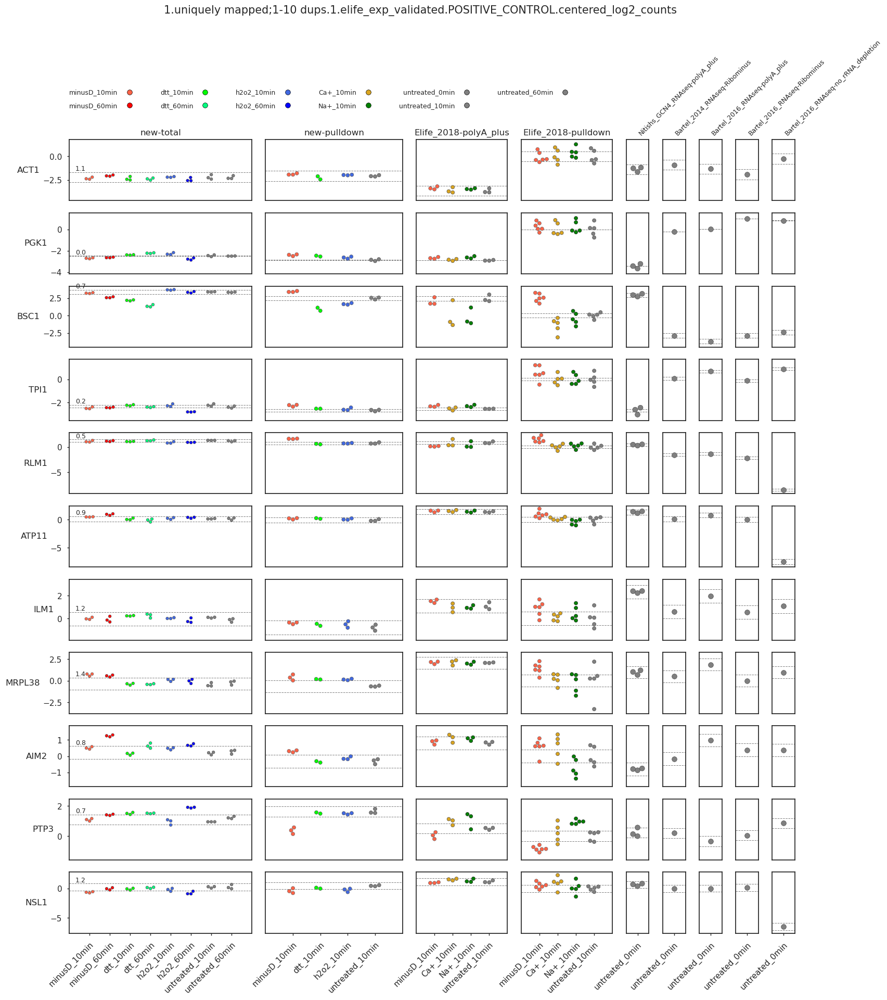

In [87]:
inspected_patterns = [{'pattern_label':'elife_exp_validated','anchor_treatment':'untreated','gene_list':['ACT1','PGK1','BSC1','TPI1','RLM1','ATP11','ILM1','MRPL38','AIM2','PTP3','NSL1']}]

CI = 0.95
tail_prob = (1-CI)/2

gr = tmp_filtered[['group_1_x_group_2','group_3']].drop_duplicates().reset_index(drop=True)

for inspected_pattern in inspected_patterns:
    gene_list = inspected_pattern['gene_list']
    i = 0 
    cur_gene_list = []
    for gene_name in gene_list:
        gene_ids = list(gene_annotation.loc[gene_annotation['gene_name']==gene_name]['gene_id'])
        if len(gene_ids)==0:
            print('gene ids not found for gene name:'+gene_name)
            continue
        else:
            cur_gene_list.append(gene_name)

        cur = pd.DataFrame(x_sel.loc[x_sel['segment_name'].str.contains('|'.join(gene_ids))][filtered_order+['std']])
        # center around mean in Elife-2018-pulldown-untreated
        samples_to_center = list(tmp_filtered.loc[(tmp_filtered['group_3'].str.contains('untreated'))&(tmp_filtered['group_1_x_group_2']=='Elife_2018-pulldown')]['sample'])

        cur['mean'] = cur[samples_to_center].mean(1)
        for col in filtered_order:
            cur[col] = cur[col]-cur['mean']
        cur_tr = pd.DataFrame(cur[filtered_order].mean())
        cur_tr['sample'] = cur_tr.index
        cur_tr = cur_tr.reset_index(drop=True).rename(columns={0:gene_name})
        cur_tr[gene_name+'_std'] = cur['std'].mean()
        cur_tr = cur_tr[['sample',gene_name,gene_name+'_std']]
        if i==0:
            res_df = cur_tr.copy()
        else:
            res_df = pd.merge(res_df,cur_tr,how='inner',on='sample')

        i=i+1

    data = res_df
    data = pd.merge(data,metadata,how='inner',on='sample')

    features_to_plot = cur_gene_list
    feature_labels = cur_gene_list
    feature_plot_type = ['swarmplot']*(len(features_to_plot))
    hide_yticks = [False]*(len(features_to_plot))

    l = list(tmp_filtered.loc[tmp_filtered['group_1_x_group_2'].isin(['new-total', 'new-pulldown', 'Elife_2018-polyA_plus','Elife_2018-pulldown', 'Nitishs_GCN4_RNAseq-polyA_plus'])]['sample'])
    data_for_lims = data.loc[data['sample'].isin(l)]

    horizontal_lines = [[-stats.norm.ppf(q=(1-tail_prob/len(x_sel)), loc=0, scale=((2/3)**0.5)*data[feature+'_std'].mean()),stats.norm.ppf(q=(1-tail_prob/len(x_sel)), loc=0, scale=((2/3)**0.5)*data[feature+'_std'].mean())] for feature in features_to_plot]

    horizontal_line_shifts = []
    for feature in features_to_plot:
        temp_list = []
        for group_1_x_group_2_cur in group_1_x_group_2_filtered:
            cur_samples = list(tmp_filtered.loc[(tmp_filtered['group_1']==group_1_x_group_2_cur[0])&(tmp_filtered['group_2']==group_1_x_group_2_cur[1])&(tmp_filtered['group_3'].str.contains(inspected_pattern['anchor_treatment']))]['sample'])
            shift = res_df.loc[res_df['sample'].isin(cur_samples)][feature].mean()
            temp_list.append(shift)
        horizontal_line_shifts.append(temp_list)

    e=0
    ylims, texts = [], []
    for feature in features_to_plot:
        max_shift,min_shift = max(horizontal_line_shifts[e]),min(horizontal_line_shifts[e])
        # estimation for elife samples is not entirely correct, as there are 6 samples there instead of 3
        ylims.append((min(data_for_lims[feature].min(),-stats.norm.ppf(q=(1-tail_prob/len(x_sel)), loc=0, scale=((2/3)**0.5)*data[feature+'_std'].mean())+min_shift)-0.5,
                      max(data_for_lims[feature].max(),stats.norm.ppf(q=(1-tail_prob/len(x_sel)), loc=0, scale=((2/3)**0.5)*data[feature+'_std'].mean())+max_shift)+0.5))
        upper_hor_line_value = horizontal_lines[e][1]+horizontal_line_shifts[e][0]
        lower_hor_line_value = horizontal_lines[e][0]+horizontal_line_shifts[e][0]
        diff = upper_hor_line_value - lower_hor_line_value
        diff = np.round(diff,1)
        texts.append([{'y_pos':upper_hor_line_value,'text':str(diff),'ha':'left','va':'bottom','size':9}])
        e = e + 1

    marker_sizes = [4]+[5]*(len(group_1_x_group_2_filtered)-6)+[7]*5

    plot_points(str(M)+'.'+label.replace('\n',';')+'.1.'+inspected_pattern['pattern_label']+'.POSITIVE_CONTROL.centered_log2_counts',
                subdirs,data,features_to_plot,feature_labels,feature_plot_type,
                hide_yticks,ylims,horizontal_lines,texts,marker_sizes,group_1_x_group_2_filtered,
                group_3_order,point_plots_width_ratios_filtered,alpha_param,rotation_degree,major_text_size,horizontal_line_shifts,
                subplot_height=1.8,output_dir=subdirs['reports_dir']+'/5_DE_on_segment_counts/')


Text(0, 0.5, '$log_2(r_{PD}/r_{non-PD})$')

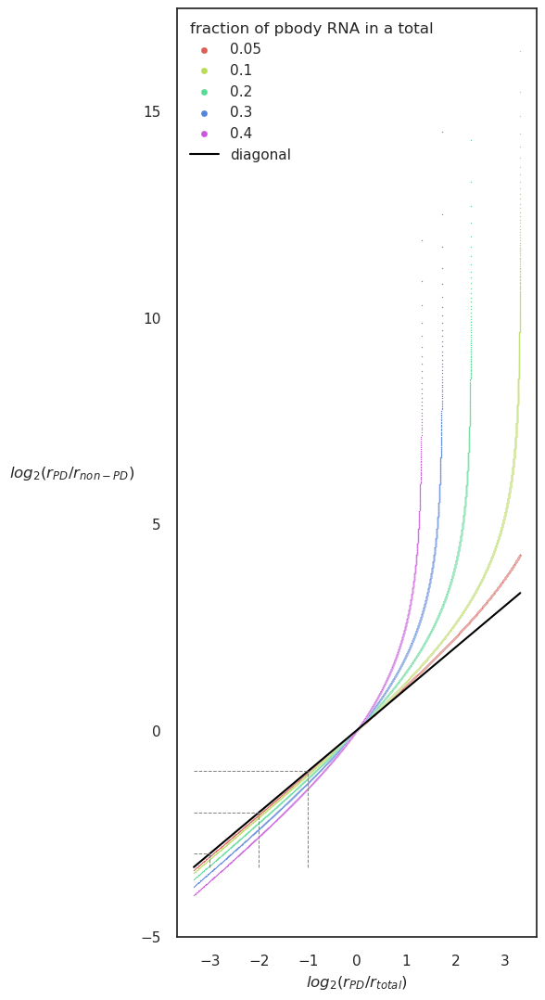

In [90]:
# make simulation on the fraction of p-body rna in the totals

f = [0.05,0.1,0.2,0.3,0.4]
colors = sns.color_palette('hls',len(f))
step = 0.001
min_value,max_value = 0.1,10
e_O = np.arange(min_value,max_value,step)
k = 1/e_O

sns.set(font_scale=1)
sns.set_style("white")
fig, axes = plt.subplots(1, 1, sharey=False, sharex=False, figsize=(5,13))

i=0
for f_cur in f:
    e_T =  (1-f_cur)/(k-f_cur)
    ax = sns.scatterplot(x = np.log2(e_O), y = np.log2(e_T), s=1,color=colors[i],label=str(f_cur))
    
    i=i+1
ax = sns.lineplot(x = [np.log2(min_value),np.log2(max_value)],y=[np.log2(min_value),np.log2(max_value)],color='black',label='diagonal')

for val in [-3,-2,-1]:
    ax.hlines(y=val,xmin=np.log2(min_value),xmax=val,color='grey',linestyles='--',linewidth=0.7)
    ax.vlines(x=val,ymin=np.log2(min_value),ymax=val,color='grey',linestyles='--',linewidth=0.7)

ax.legend(markerscale=5,title='fraction of pbody RNA in a total',alignment='left')
ax.set(xlabel=r'$log_2(r_{PD}/r_{total})$')
ax.set_ylabel(ylabel=r'$log_2(r_{PD}/r_{non-PD})$',rotation=0,ha='right',va='center',rotation_mode='anchor')

In [71]:
minusD_enriched_mRNA

['BSC1', 'TPI1', 'RLM1', 'ATP11', 'ILM1', 'MRPL38', 'AIM2']

In [ ]:
x_sel_vals = (x_sel_frac.values).transpose()
x_sel_vals = StandardScaler().fit_transform(x_sel_vals)
starndardized_matrix_df = pd.DataFrame(x_sel_vals).transpose()
starndardized_matrix_df.columns = list(x_sel_frac.columns)

# transformer = KernelPCA(n_components=4, kernel='rbf')
# principalComponents = transformer.fit_transform(x_sel_vals)

pca = PCA(n_components=4)
principalComponents = pca.fit_transform(x_sel_vals)
principalDf = pd.DataFrame(data = principalComponents, columns = ['PC1', 'PC2','PC3','PC4'])
principalDf['sample'] = list(x_sel_frac.columns)

reducer = umap.UMAP(n_components=4,n_neighbors=int(len(x_sel_frac.columns)*0.3),min_dist=0.1,random_state=42)
embedding = reducer.fit_transform(x_sel_vals)
umapDf = pd.DataFrame(data = embedding, columns = ['UMAP1', 'UMAP2','UMAP3', 'UMAP4'])
umapDf['sample'] = list(x_sel_frac.columns)

Reduced_representation_df = pd.merge(principalDf,umapDf,how='inner',on='sample')
Reduced_representation_df = pd.merge(metadata,Reduced_representation_df,how='inner',on='sample')

Reduced_representation_df['group_1_x_group_2'] = Reduced_representation_df['group_1']+'-'+Reduced_representation_df['group_2']
group_1_x_group_2_vals = ['-'.join(elem) for elem in group_1_x_group_2]

data = Reduced_representation_df.copy()

xy_combs = [['PC1','PC2'],['PC3','PC4'],['UMAP1','UMAP2'],['UMAP3','UMAP4']]
hues = ['group_1_x_group_2','group_3']

# set lims
lims = []
for xy_comb in xy_combs:
    iqr_x = data[xy_comb[0]].quantile(q=0.75)-data[xy_comb[0]].quantile(q=0.25)
    iqr_y = data[xy_comb[1]].quantile(q=0.75)-data[xy_comb[1]].quantile(q=0.25)
    lims.append([(data[xy_comb[0]].min()-iqr_x*0.5,data[xy_comb[0]].max()+iqr_x*0.5),(data[xy_comb[1]].min()-iqr_y*0.5,data[xy_comb[1]].max()+iqr_y*0.5)])

sns.set(font_scale=1)
sns.set_style("white")
fig, axes = plt.subplots(len(hues), len(xy_combs), sharey=False, sharex=False, figsize=(17,8))

i=0
for hue in hues:
    if hue=='group_1_x_group_2':
        hue_order_cur = group_1_x_group_2_vals
        palette = sns.color_palette('tab20',len(group_1_x_group_2_vals))
    else:
        present_treatments = list(data['group_3'].unique())
        group_3_order_cur = [treatment for treatment in group_3_order if treatment in present_treatments] 
        palette = [metadata.loc[metadata['group_3']==treatment]['color'].iloc[0] for treatment in group_3_order_cur]
        hue_order_cur = group_3_order_cur
    j=0
    for xy_comb in xy_combs:

        texts = []
        if hue=='group_3':
            for group_1_x_group_2_val in group_1_x_group_2_vals:
                k=0
                for hue_var in hue_order_cur:
                    data_cur = data.loc[(data['group_1_x_group_2']==group_1_x_group_2_val)&(data[hue]==hue_var)]
                    if len(data_cur)>1:
                        ax = sns.kdeplot(ax=axes[i][j],data = data_cur,x=xy_comb[0],y=xy_comb[1],color=palette[k],fill=True,
                        levels=[0.05,1], alpha=0.1,)
                    else:
                        for index,row in data_cur.iterrows():
                            texts.append(ax.text(row[xy_comb[0]],row[xy_comb[1]],"\n".join(textwrap.wrap(row['group_1_x_group_2'].replace('_',' '),width=10)),
                                             ha='center',va='center',size=5))
                    k=k+1
        else:
            k=0
            for hue_var in hue_order_cur:
                data_cur = data.loc[(data[hue]==hue_var)]
                if len(data_cur)>1:
                    ax = sns.kdeplot(ax=axes[i][j],data = data_cur,x=xy_comb[0],y=xy_comb[1],color=palette[k],fill=True,
                    levels=[0.05,1], alpha=0.1, bw_adjust=.5)
                else:
                    for index,row in data_cur.iterrows():
                        texts.append(ax.text(row[xy_comb[0]],row[xy_comb[1]],"\n".join(textwrap.wrap(row['group_1_x_group_2'].replace('_',' '),width=10)),
                                         ha='center',va='center',size=5))                    
                k=k+1

        ax = sns.scatterplot(ax=axes[i][j],data = data,x=xy_comb[0],y=xy_comb[1],hue=hue,hue_order=hue_order_cur,palette=palette,
                            s=9,alpha=1
                            )

        # add percentages of explained variance
        if xy_comb[0].startswith('PC'):
            ind_x = int(xy_comb[0].replace('PC',''))-1
            ind_y = int(xy_comb[1].replace('PC',''))-1
            ax.set(xlabel = xy_comb[0]+', '+str(int(np.round(pca.explained_variance_ratio_[ind_x]*100,0)))+'%')
            ax.set(ylabel = xy_comb[1]+', '+str(int(np.round(pca.explained_variance_ratio_[ind_y]*100,0)))+'%')

        ax.set(xlim = lims[j][0],ylim = lims[j][1])

        # add text labels
        %time adjust_text(texts,arrowprops=dict(arrowstyle='->', color='red',lw=0.5),ax=ax,x=list(data[xy_comb[0]]),y=list(data[xy_comb[1]]),force_points=(0.1,0.1))

        if j==(len(xy_combs)-1):
            ax.legend(bbox_to_anchor=(1, 0, 1, 1),loc='upper left',borderaxespad=0,title=hue,markerscale=1.2,ncols=1,fontsize=9,mode='expand')
        else:
            ax.legend_.remove()
        j=j+1
    i=i+1
fig.suptitle(label, x=0.5,y=1,size=major_text_size,ha='center',va='bottom')
fig.tight_layout(pad=0.5)


0.5018227928356317


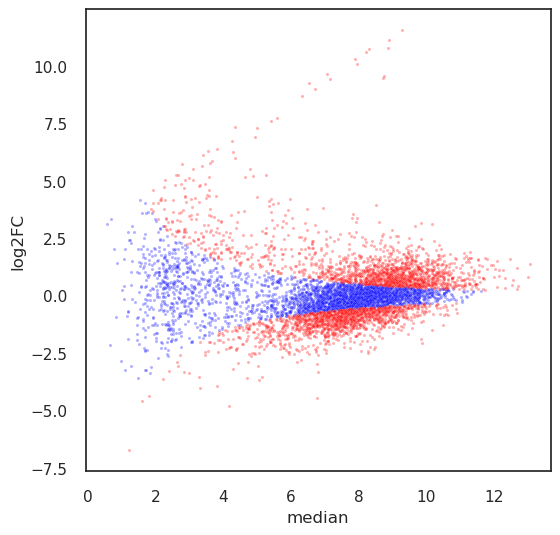

In [405]:
# l = ['GFB-5223_H2CKTDRX3_1_34minusDtotal10min1_S4_L001_R1_001','SRR6165267']
l = ['GFB-5224_H2CKTDRX3_1_35minusDtotal10min2_S5_L001_R1_001','SRR6165267']

data = x_sel[l+['std','median']]
data['log2FC'] = data[l[0]]-data[l[1]]
data['av'] = data[l].mean(1)
pvals = 2*(1-stats.norm.cdf(abs(data['log2FC']),0,data['std']))
data['pval'] = pvals
data['pval_adj'] = multipletests(pvals = pvals,method='bonferroni')[1]
# data['pval_adj'] = data['pval'] # to increase sensitivity of the analysis
frac = len(data.loc[data['pval_adj']>=0.05])/len(data)
print(frac)

sns.set(font_scale=1)
sns.set_style("white")
fig, axes = plt.subplots(1, 1, sharey=False, sharex=False, figsize=(6,6))

ax = sns.scatterplot(data = data.loc[data['pval_adj']>=0.05],x='median',y='log2FC',color='blue',s=5,alpha=0.3)
ax = sns.scatterplot(data = data.loc[data['pval_adj']<0.05],x='median',y='log2FC',color='red',s=5,alpha=0.3)

sample,chr,start,end,strand,segment_name,GFB-5238_H2CKTDRX3_1_53dtttotal60min1_S19_L001_R1_001,GFB-5240_H2CKTDRX3_2_55dtttotal60min3_S21_L002_R1_001,GFB-5239_H2CKTDRX3_1_54dtttotal60min2_S20_L001_R1_001,GFB-5240_H2CKTDRX3_1_55dtttotal60min3_S21_L001_R1_001,GFB-5239_H2CKTDRX3_2_54dtttotal60min2_S20_L002_R1_001,...,SRR6165267,SRR6165268,SRR6165269,SRR6165270,SRR6165271,SRR6165272,SRR6165273,iqr,median,iqr_over_median
256,II,579149,581372,-,alw_exonic;YBR172C,534.691436,511.623100,563.134683,513.997218,467.905638,...,518.962132,281.443205,367.544832,340.516777,552.979621,214.855154,227.729113,198.181269,563.144844,0.351919
539,IV,283418,284444,+,alw_exonic;YDL099W,613.745277,605.894393,626.848789,570.485559,589.214507,...,383.328261,353.859788,295.331070,281.217657,269.225794,348.784938,324.746635,114.827342,326.247764,0.351964
2919,XIII,820255,822454,+,alw_exonic;YMR277W,442.222397,478.462343,497.460142,453.774111,478.798679,...,496.666153,314.600981,337.730690,290.539790,440.107977,369.895904,372.132260,179.499638,509.421201,0.352360
685,IV,742041,743874,-,alw_exonic;YDR143C,524.150924,487.936845,526.866653,538.740045,523.361121,...,352.555165,226.003403,361.190999,332.618859,423.141672,281.479546,257.251534,158.590134,449.827466,0.352558
2659,XII,1015567,1017697,-,alw_exonic;YLR440C,301.841940,316.448362,281.812396,314.654064,300.053774,...,373.225395,326.272518,295.575449,289.892419,411.661478,271.605062,320.361058,98.376476,278.890876,0.352742
